# Network embedding 

---

## 0. Environmental setup

We load all required libraries.

In [50]:
import pandas as pd
import networkx as nx
import numpy as np
import seaborn as sns
import sys
import os
import random
import torch
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
import community as community_louvain
from torch_geometric.data import Data
from torch import LongTensor, FloatTensor
from node2vec import Node2Vec
from torch_geometric.nn import GAE
from torch_geometric.utils import train_test_split_edges, from_networkx
import torch_geometric.transforms as T
from torch_geometric.nn import InnerProductDecoder
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler, RobustScaler, MinMaxScaler, normalize
import scanpy as sc
from sklearn.cluster import AgglomerativeClustering, KMeans
from sklearn.metrics import adjusted_mutual_info_score
from scipy.stats import spearmanr, pearsonr
from sklearn.cluster import KMeans
from yellowbrick.cluster.elbow import kelbow_visualizer
from yellowbrick.cluster import KElbowVisualizer
from collections import Counter, OrderedDict
from sklearn.decomposition import PCA

from scipy.spatial.distance import pdist, squareform
import scipy.spatial as sp, scipy.cluster.hierarchy as hc

from IPython.display import Image

sys.path.append("../../../../")

from src.utils.torch.network import *
from src.utils.notebooks.ppi.embedding import *
from src.models.clf import LatentClassifier
from src.models.regressor import FeatureDecoder
from src.utils.basic.io import get_genesets_from_gmt_file
from src.models.ae import GCNEncoder
import matplotlib as mpl

seed = 1234

plt.style.use("default")
mpl.rcParams["figure.dpi"] = 600


%load_ext nb_black

The nb_black extension is already loaded. To reload it, use:
  %reload_ext nb_black


<IPython.core.display.Javascript object>

In [60]:
def plot_pca_embs(
    latents,
    ax,
    target,
    target_size=12,
    reg_size=8,
    target_label_size=12,
    reg_label_size=10,
    label_points=None,
    random_state=1234,
):
    embs = PCA(n_components=2, random_state=random_state).fit_transform(latents)
    embs = pd.DataFrame(embs, columns=["pc_0", "pc_1"], index=latents.index)
    ax.scatter(
        np.array(embs.loc[:, "pc_0"]), np.array(embs.loc[:, "pc_1"]), c="b", s=reg_size
    )
    ax.scatter(
        np.array(embs.loc[target, "pc_0"]),
        np.array(embs.loc[target, "pc_1"]),
        c="r",
        s=target_size,
    )
    if label_points is not None:
        to_label_embs = embs.loc[embs.index.isin(label_points)]
        label_point(
            np.array(to_label_embs.loc[:, "pc_0"]),
            np.array(to_label_embs.loc[:, "pc_1"]),
            np.array(to_label_embs.index).astype("str"),
            ax=ax,
            reg_size=reg_label_size,
            highlight=target,
            highlight_size=target_label_size,
        )
    return ax

<IPython.core.display.Javascript object>

In [61]:
def label_point(
    x, y, val, ax, reg_size=10, highlight_size=10, highlight=None, highlight_other=None
):
    xmin, xmax = ax.get_xlim()
    ymin, ymax = ax.get_ylim()
    for i in range(len(x)):
        if highlight is not None and val[i] == highlight:
            c = "r"
            weight = "bold"
            size = highlight_size
        elif highlight_other is not None and val[i] in highlight_other:
            c = "b"
            weight = "bold"
        else:
            c = "k"
            weight = "normal"
            size = reg_size
        if x[i] > xmin and x[i] < xmax and y[i] > ymin and y[i] < ymax:
            ax.text(x[i] + 0.02, y[i], val[i], {"size": size, "c": c, "weight": weight})

<IPython.core.display.Javascript object>

In [75]:
def run_reg_space_loto_exp(
    root_output_dir,
    oe_targets,
    interactome,
    physical_cluster_dict,
    physical_full_cluster_dict,
    cmap_clusters,
    cluster_opt,
    graph_opt,
    alpha=1,
    beta=0,
    gamma=1,
    n_classes=10,
    seed=1234,
    node_feature_key="sc_gex_hallmark",
    input_dim=1176,
    latent_dim=1024,
    early_stopping=100,
    neg_edge_ratio=1,
    lr=0.00001,
    n_epochs=10000,
):
    graph_dict = get_graph_dict(
        oe_targets,
        interactome,
        physical_cluster_dict,
        physical_full_cluster_dict,
        cmap_clusters,
        cluster_opt,
    )
    print(graph_dict.keys())
    for oe_target in oe_targets:

        output_dir = os.path.join(root_output_dir, oe_target, interactome.name)
        output_dir = os.path.join(
            output_dir,
            "gae_exp_a{}_b{}_g{}_{}_{}".format(
                alpha, beta, gamma, graph_opt, cluster_opt
            ),
        )
        os.makedirs(output_dir, exist_ok=True)

        if cluster_opt == "physical":
            clusters = physical_cluster_dict[oe_target].copy()
            clusters.loc[oe_target] = -1
        elif cluster_opt == "cmap":
            clusters = cmap_clusters.copy()
            clusters.loc[oe_target] = -1
        elif cluster_opt == "cmap_full":
            clusters = cmap_clusters.copy()
        else:
            clusters = physical_full_cluster_dict[oe_target].copy()

        clusters = get_colored_clusters(clusters)

        graph = graph_dict[oe_target]
        latents_dict, loss_hist_dict, graph_data = run_loto_inference(
            graph=graph,
            oe_target=oe_target,
            output_dir=output_dir,
            cluster_opt=cluster_opt,
            alpha=alpha,
            beta=beta,
            gamma=gamma,
            n_classes=n_classes,
            node_feature_key=node_feature_key,
            input_dim=input_dim,
            latent_dim=latent_dim,
            graph_opt=graph_opt,
            seed=seed,
            lr=lr,
            early_stopping=early_stopping,
            neg_edge_ratio=neg_edge_ratio,
            n_epochs=n_epochs,
            device="cpu",
        )

        latents = latents_dict[seed]
        node_names = getattr(graph_data, "name")
        st_memberships = getattr(graph_data, "spec_target")
        latents = pd.DataFrame(latents, index=node_names)

        save_and_visualize_latents(
            latents=latents,
            output_dir=output_dir,
            clusters=clusters,
            oe_targets=oe_targets,
            st_memberships=st_memberships,
            random_state=seed,
        )
        latents.to_csv(
            os.path.join(
                output_dir,
                "node_embs.csv",
            )
        )

<IPython.core.display.Javascript object>

In [63]:
def get_graph_dict(
    oe_targets,
    interactome,
    physical_cluster_dict,
    physical_full_cluster_dict,
    cmap_clusters,
    cluster_opt="physical",
):
    graph_dict = {}
    for target in oe_targets:
        graph = interactome.copy()
        physical_clusters = physical_cluster_dict[target]
        physical_full_clusters = physical_full_cluster_dict[target]
        for node in graph.nodes(data=True):
            node[-1]["sc_gex"] = np.array(gex_data_z.loc[:, node[0]])
            node[-1]["sc_gex"] = node[-1]["sc_gex"]
            if cluster_opt == "cmap_full":
                if node[0] in cmap_clusters.index:
                    node[-1]["label"] = cmap_clusters.loc[node[0], "cluster"]
                    node[-1]["label_mask"] = True
                else:
                    node[-1]["label"] = -1
                    node[-1]["label_mask"] = False

            if cluster_opt == "cmap":
                if node[0] in cmap_clusters.index and node[0] != target:
                    node[-1]["label"] = cmap_clusters.loc[node[0], "cluster"]
                    node[-1]["label_mask"] = True
                else:
                    node[-1]["label"] = -1
                    node[-1]["label_mask"] = False

            if cluster_opt == "physical":
                if node[0] in physical_clusters.index and node[0] != target:
                    node[-1]["label"] = physical_clusters.loc[node[0], "cluster"]
                    node[-1]["label_mask"] = True
                else:
                    node[-1]["label"] = -1
                    node[-1]["label_mask"] = False

            if cluster_opt == "physical_full":
                if node[0] in physical_full_clusters.index:
                    node[-1]["label"] = physical_full_clusters.loc[node[0], "cluster"]
                    node[-1]["label_mask"] = True
                else:
                    node[-1]["label"] = -1
                    node[-1]["label_mask"] = False

            node[-1]["name"] = node[0]
            node[-1]["spec_target"] = node[0] in oe_targets

            gene_memberships = []
            for geneset in hallmark_geneset_dict.values():
                if node[0] in geneset:
                    gene_memberships.append(1.0)
                else:
                    gene_memberships.append(0.0)

            node[-1]["hallmark"] = np.array(gene_memberships)
            node[-1]["sc_gex_hallmark"] = np.concatenate(
                [node[-1]["sc_gex"], node[-1]["hallmark"]]
            )
        graph_dict[target] = graph
    return graph_dict

<IPython.core.display.Javascript object>

In [64]:
def get_colored_clusters(clusters):
    colored_clusters = clusters.copy()
    lut = dict(
        zip(
            list(np.unique(colored_clusters)),
            [
                "tab:blue",
                "tab:red",
                "tab:green",
                "gold",
                "tab:orange",
                "tab:cyan",
                "tab:purple",
                "tab:pink",
                "tab:olive",
                "olivedrab",
                "tab:brown",
            ],
        )
    )
    colored_clusters.loc[:, "color"] = colored_clusters.loc[:, "cluster"].map(lut)
    return colored_clusters

<IPython.core.display.Javascript object>

In [65]:
def run_loto_inference(
    graph,
    oe_target,
    output_dir,
    cluster_opt,
    alpha,
    beta,
    gamma,
    n_classes=10,
    node_feature_key="sc_gex_hallmark",
    input_dim=1176,
    latent_dim=1024,
    graph_opt="split_graph",
    seed=1234,
    lr=0.00001,
    early_stopping=200,
    neg_edge_ratio=1,
    n_epochs=10000,
    device="cpu",
):
    print(oe_target)

    device = torch.device(device)
    graph_data = from_networkx(graph)
    graph_data.id = torch.FloatTensor(np.identity(len(graph)))
    graph_data = T.ToDevice(
        device,
        attrs=[
            "id",
            "sc_gex",
            "label",
            "label_mask",
            "hallmark",
            "sc_gex_hallmark",
        ],
    )(graph_data)

    class_weights = None

    gae = GAE(
        GCNEncoder(
            in_channels=input_dim, out_channels=latent_dim, hidden_dim=latent_dim
        )
    )
    feature_decoder = FeatureDecoder(
        latent_dim=latent_dim,
        hidden_dims=[latent_dim],
        output_dim=input_dim,
        loss_fct=torch.nn.L1Loss(),
    )
    latent_classifier = LatentClassifier(
        latent_dim=latent_dim,
        hidden_dims=None,
        n_classes=n_classes,
        loss_fct=None,
        class_weights=class_weights,
    )

    seeds = [seed]
    use_graph = graph_opt
    edge_weight_key = None
    latents_dict, loss_hist_dict = get_gae_latents_for_seed(
        graph_data=graph_data,
        gae=gae,
        seeds=seeds,
        node_feature_key=node_feature_key,
        edge_weight_key=edge_weight_key,
        feature_decoder=feature_decoder,
        latent_classifier=latent_classifier,
        n_epochs=n_epochs,
        lr=lr,
        split_type="link",
        alpha=alpha,
        beta=beta,
        gamma=gamma,
        plot_loss=True,
        early_stopping=early_stopping,
        use_full_graph=use_graph == "full_graph",
        neg_edge_ratio=neg_edge_ratio,
    )
    torch.save(gae, os.path.join(output_dir, "gae.pt"))
    torch.save(feature_decoder, os.path.join(output_dir, "feature_decoder.pt"))
    torch.save(latent_classifier, os.path.join(output_dir, "latent_classifier.pt"))
    return latents_dict, loss_hist_dict, graph_data

<IPython.core.display.Javascript object>

In [66]:
def save_and_visualize_latents(
    latents, output_dir, clusters, oe_targets, st_memberships, random_state=1234
):
    embs = TSNE(
        random_state=1234,
        perplexity=int(np.sqrt(len(latents))) + 1,
        init="pca",
        learning_rate="auto",
    ).fit_transform(latents)
    embs = pd.DataFrame(embs, columns=["tsne_0", "tsne_1"], index=latents.index)
    embs["spec_target"] = st_memberships.cpu().numpy()

    fig, ax = plt.subplots(figsize=[20, 10])
    ax = sns.scatterplot(
        data=embs, x="tsne_0", y="tsne_1", cmap="viridis", hue="spec_target"
    )
    label_point(
        np.array(embs.loc[:, "tsne_0"]),
        np.array(embs.loc[:, "tsne_1"]),
        np.array(embs.index).astype("str"),
        ax=ax,
    )
    ax.set_title("Visualization of the inferred embedding space")
    plt.savefig(
        os.path.join(
            output_dir,
            "tsne_embs.png",
        ),
        bbox_inches="tight",
    )
    plt.close()

    ax = sns.clustermap(
        latents.loc[set(oe_targets).intersection(latents.index)],
        figsize=[6, 12],
        metric="cosine",
        method="complete",
        cmap="seismic",
        row_colors=np.array(
            clusters.loc[set(oe_targets).intersection(latents.index), "color"]
        ).ravel(),
    )
    ax.ax_heatmap.set_yticklabels(
        ax.ax_heatmap.get_ymajorticklabels(),
        fontsize=15,
        fontweight="bold",
    )
    plt.savefig(
        os.path.join(
            output_dir,
            "reg_clustering.png",
        ),
        bbox_inches="tight",
    )
    plt.close()

<IPython.core.display.Javascript object>

In [67]:
def read_in_loto_embs(
    root_dir,
    exp_dir,
    gae_exp,
    avg_phy_embs=True,
    normalize_reg_embs=True,
    exclude_ctrl=True,
):
    oe_targets = sorted(os.listdir(root_dir))

    phy_embs_dict = {}
    reg_embs_dict = {}
    for oe_target in tqdm(oe_targets):
        target_dir = os.path.join(root_dir, oe_target)
        phy_embs = pd.read_hdf(os.path.join(target_dir, "phy_embs.h5"))
        if exclude_ctrl:
            phy_embs = phy_embs.loc[phy_embs.labels != "EMPTY"]
        if avg_phy_embs:
            phy_embs_dict[oe_target] = phy_embs.groupby("labels").mean()
        else:
            phy_embs_dict[oe_target] = phy_embs

        reg_embs = pd.read_csv(
            os.path.join(target_dir, exp_dir, gae_exp, "node_embs.csv"), index_col=0
        )
        if normalize_reg_embs:
            reg_embs = pd.DataFrame(
                normalize(reg_embs), index=reg_embs.index, columns=reg_embs.columns
            )
        reg_embs_dict[oe_target] = reg_embs
    return phy_embs_dict, reg_embs_dict

<IPython.core.display.Javascript object>

---

## 1. Read in data

We next load the previously inferred gene-gene interactome.

In [52]:
spearman_interactome = nx.read_gpickle(
    "../../../../data/experiments/rohban/interactome/inference_results/spearman_sol_cv.pkl"
)
print(spearman_interactome)

Graph named 'spearman_sol' with 249 nodes and 526 edges


<IPython.core.display.Javascript object>

The network consists of 249 nodes and 526 edges.

Next, we load the single-cell gene expression data which we will use as node features in order to encode functional relationships in the control setting which we expect to partially conserved even in the overexpression settings.

In [54]:
gex_adata = sc.read("../../../../data/experiments/rohban/gex/scrnaseq/fucci_adata.h5")
gex_adata.var_names_make_unique()
gex_data = pd.DataFrame(
    gex_adata.X, columns=gex_adata.var_names, index=gex_adata.obs_names
)
gex_data.columns = [c.upper() for c in gex_data.columns]
gex_data = gex_data.loc[
    :, set(spearman_interactome.nodes()).intersection(gex_data.columns)
]

<IPython.core.display.Javascript object>

We also load two types of cluster information: a) clusters obtained by hierarchically clustering the L1000 gene signatures in the corresponding OE conditions using cosine distances and complete linkage and b) clusters obtained when clustering the physical space. For the latter those clusters depend on the individual physical space that was inferred which differs according to which target was left out during training. Thus, we load a number of cluster solutions for the physical space that correspond to those.

In [55]:
cmap_clusters = pd.read_csv(
    "../../../../data/experiments/rohban/interactome/cluster_infos/mean_cmap_sig_clusters_all_covered_nodes.csv", index_col=0
)

<IPython.core.display.Javascript object>

In [56]:
phy_oe_emb_dir = (
    "../../../../data/experiments/rohban/images/embeddings/leave_one_target_out/embeddings"
)
oe_targets = os.listdir(phy_oe_emb_dir)
oe_targets = sorted(oe_targets)
physical_cluster_dict = {}
for target in oe_targets:
    physical_cluster_dict[target] = pd.read_csv(
        os.path.join(phy_oe_emb_dir, target, "train_phy_mean_clusters.csv"), index_col=0
    )

<IPython.core.display.Javascript object>

In [57]:
physical_full_cluster_dict = {}
for target in oe_targets:
    physical_full_cluster_dict[target] = pd.read_csv(
        os.path.join(phy_oe_emb_dir, target, "phy_mean_full_clusters.csv"), index_col=0
    )

<IPython.core.display.Javascript object>

Finally, we read in a number of descriptive gene sets. Out of those especially the Hallmark gene set has been previously successfully used as a node feature to encode protein-protein interactomes and thus will be also used in our study.

In [58]:
hallmark_geneset_dict = get_genesets_from_gmt_file(
    "../../../../data/resources/genesets/h.all.v7.4.symbols.gmt"
)

l1000_genes = set(
    list(
        pd.read_csv(
            "../../../../data/resources/genesets/l1000.txt", index_col=0, header=None
        ).index
    )
)


<IPython.core.display.Javascript object>

---
---

## 2. Preprocessing

We will now set the respective node and edge attributes computed based on the previously loaded information. Note, that the single-cell gene expression data is min-max-scaled.

In [59]:
gex_data_z = pd.DataFrame(
    MinMaxScaler().fit_transform(gex_data.transpose()),
    index=gex_data.transpose().index,
    columns=gex_data.transpose().columns,
).transpose()

<IPython.core.display.Javascript object>

As mentioned above the cluster setting differs for each inferred physical space, we thus construct a number of interactomes, where we set the a corresponding node attribute to the clustering structure for each target that was held-out.

----

## 3. Leave-one-target-out gene embedding inference

In [76]:
root_output_dir = (
    "../../../../data/experiments/rohban/images/embeddings/leave_one_target_out/embeddings"
)
interactome = spearman_interactome
cluster_opt = "physical"
graph_opt = "split_graph"

alpha_beta_gamma_opts = [
        (1, 0, 0),
        (0, 0, 1),
        (1, 0, 1),
        (1, 1, 1),
        (1, 0, 2),
        (1, 0, 5),
        (1, 2, 1),
        (1, 5, 1),
]

<IPython.core.display.Javascript object>

dict_keys(['AKT1S1', 'ATF4', 'BAX', 'BCL2L11', 'BRAF', 'CASP8', 'CDC42', 'CDKN1A', 'CEBPA', 'CREB1', 'CXXC4', 'DIABLO', 'E2F1', 'ELK1', 'EMPTY', 'ERG', 'FGFR3', 'FOXO1', 'GLI1', 'HRAS', 'IRAK4', 'JUN', 'MAP2K3', 'MAP3K2', 'MAP3K5', 'MAP3K9', 'MAPK7', 'MOS', 'MYD88', 'PIK3R2', 'PRKACA', 'PRKCE', 'RAF1', 'RELB', 'RHOA', 'SMAD4', 'SMO', 'SRC', 'SREBF1', 'TRAF2', 'TSC2', 'WWTR1'])
AKT1S1


  9%|▉         | 899/10000 [00:18<03:02, 49.76it/s]


Training stopped after 900 epochs
Best model found at epoch 798
------------------------------------------------------------
TEST AUC: 0.8371882086167801 AP: 0.8515138794927012
TRAIN loss: 1.0025742053985596
VAL loss: 1.0336682796478271
TEST loss: 1.0963658094406128
TEST AUC: 0.8371882086167801 	 AP: 0.8515138794927012


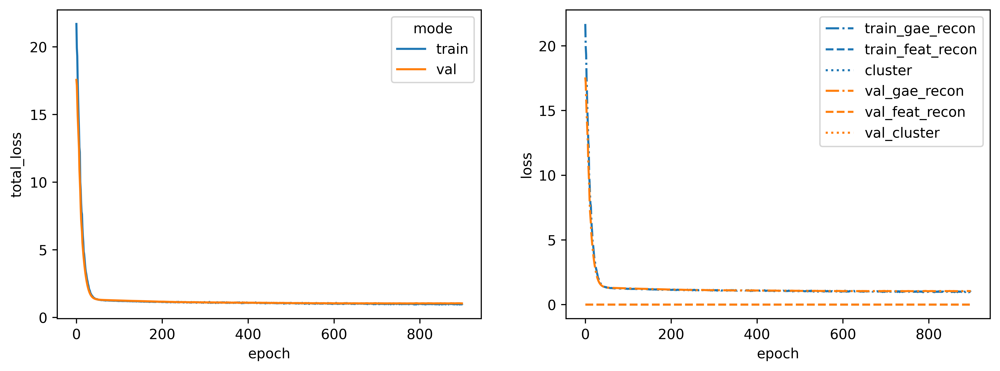

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ATF4


 13%|█▎        | 1285/10000 [00:26<02:57, 48.98it/s]


Training stopped after 1286 epochs
Best model found at epoch 1184
------------------------------------------------------------
TEST AUC: 0.8459863945578231 AP: 0.8848875754150787
TRAIN loss: 0.9560571312904358
VAL loss: 0.9860072135925293
TEST loss: 1.0685468912124634
TEST AUC: 0.8459863945578231 	 AP: 0.8848875754150787


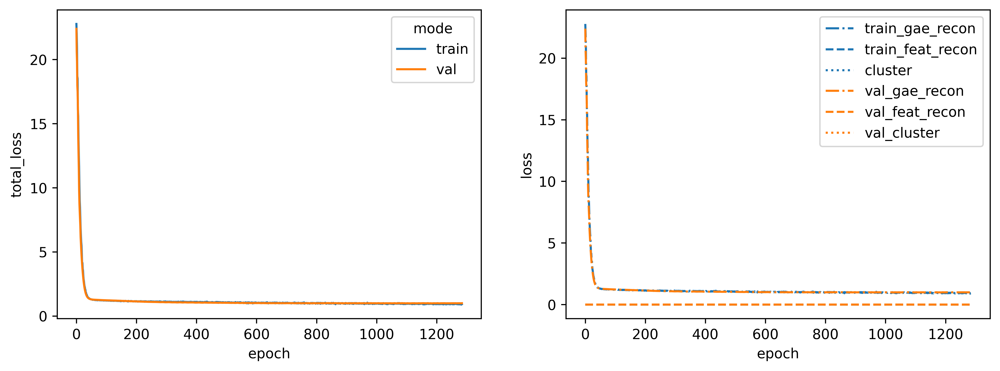

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BAX


 12%|█▏        | 1159/10000 [00:25<03:15, 45.24it/s]


Training stopped after 1160 epochs
Best model found at epoch 1058
------------------------------------------------------------
TEST AUC: 0.8479818594104308 AP: 0.8851794824871051
TRAIN loss: 0.9460028409957886
VAL loss: 1.0818325281143188
TEST loss: 1.0592840909957886
TEST AUC: 0.8479818594104308 	 AP: 0.8851794824871051


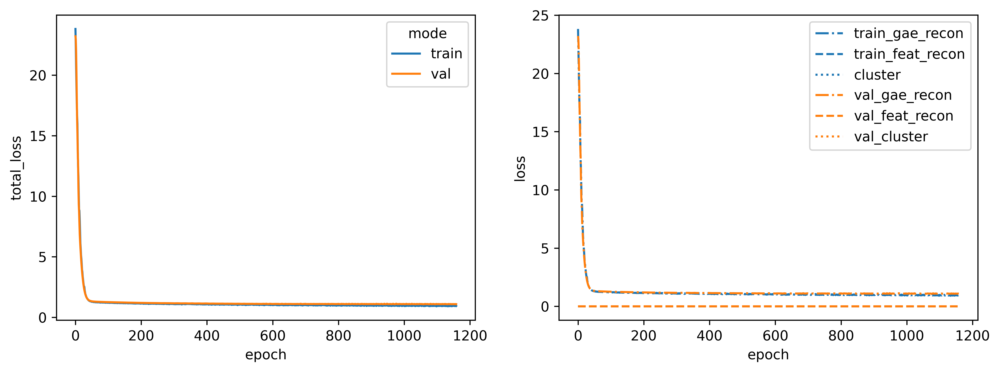

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BCL2L11


 10%|█         | 1033/10000 [00:22<03:16, 45.59it/s]


Training stopped after 1034 epochs
Best model found at epoch 932
------------------------------------------------------------
TEST AUC: 0.8060770975056688 AP: 0.8137447155687838
TRAIN loss: 0.9859640002250671
VAL loss: 0.9608291387557983
TEST loss: 1.1716721057891846
TEST AUC: 0.8060770975056688 	 AP: 0.8137447155687838


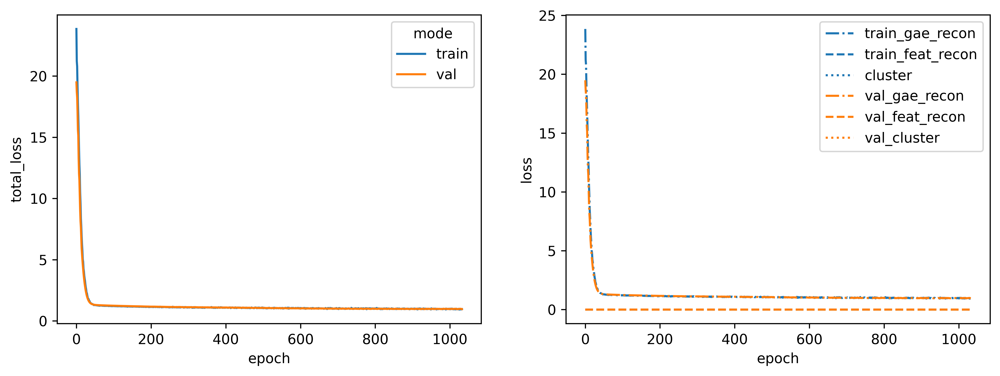

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BRAF


 10%|█         | 1016/10000 [00:20<03:05, 48.54it/s]


Training stopped after 1017 epochs
Best model found at epoch 915
------------------------------------------------------------
TEST AUC: 0.7928344671201814 AP: 0.7879764686080087
TRAIN loss: 0.9633918404579163
VAL loss: 1.0114939212799072
TEST loss: 1.219848394393921
TEST AUC: 0.7928344671201814 	 AP: 0.7879764686080087


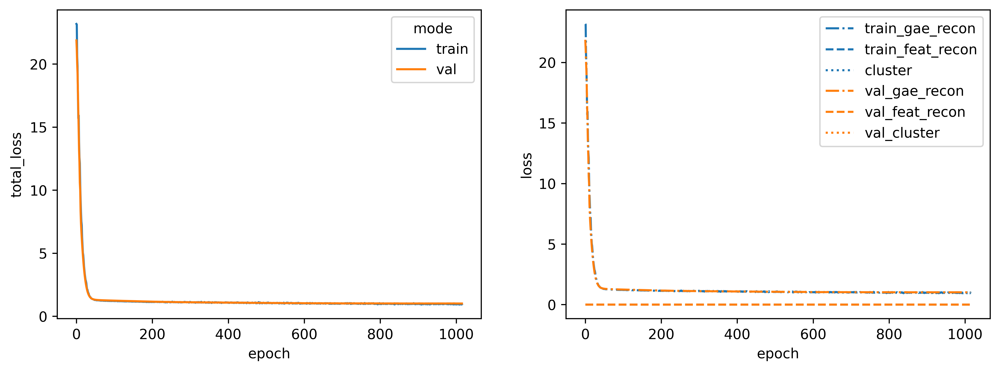

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CASP8


 16%|█▋        | 1634/10000 [00:34<02:56, 47.34it/s]


Training stopped after 1635 epochs
Best model found at epoch 1533
------------------------------------------------------------
TEST AUC: 0.8319274376417233 AP: 0.8474505755725512
TRAIN loss: 0.8974552154541016
VAL loss: 1.0084956884384155
TEST loss: 1.1111890077590942
TEST AUC: 0.8319274376417233 	 AP: 0.8474505755725512


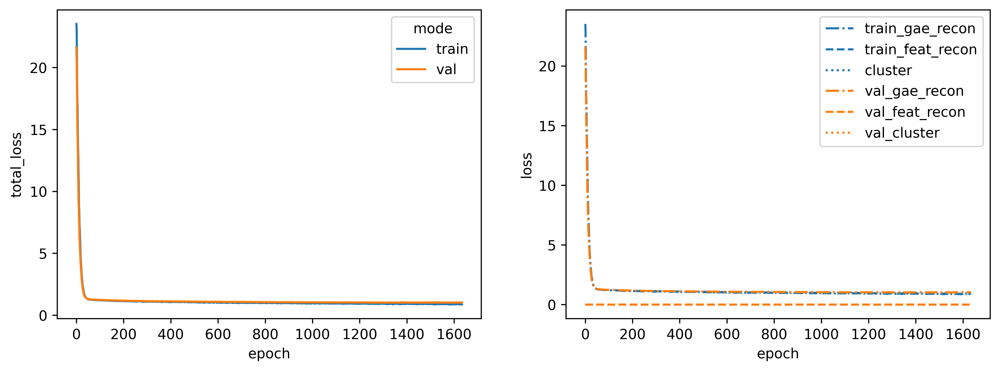

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDC42


 15%|█▍        | 1485/10000 [00:31<03:01, 46.98it/s]


Training stopped after 1486 epochs
Best model found at epoch 1384
------------------------------------------------------------
TEST AUC: 0.8131519274376416 AP: 0.8546438025217952
TRAIN loss: 0.9361804723739624
VAL loss: 1.0294642448425293
TEST loss: 1.1569575071334839
TEST AUC: 0.8131519274376416 	 AP: 0.8546438025217952


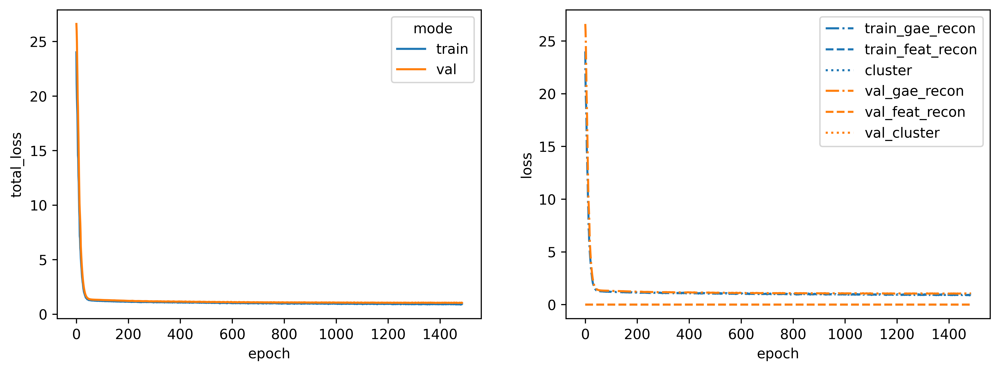

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDKN1A


 13%|█▎        | 1305/10000 [00:26<02:58, 48.63it/s]


Training stopped after 1306 epochs
Best model found at epoch 1204
------------------------------------------------------------
TEST AUC: 0.8156916099773243 AP: 0.8288338219203284
TRAIN loss: 0.9301387071609497
VAL loss: 1.1443326473236084
TEST loss: 1.1534277200698853
TEST AUC: 0.8156916099773243 	 AP: 0.8288338219203284


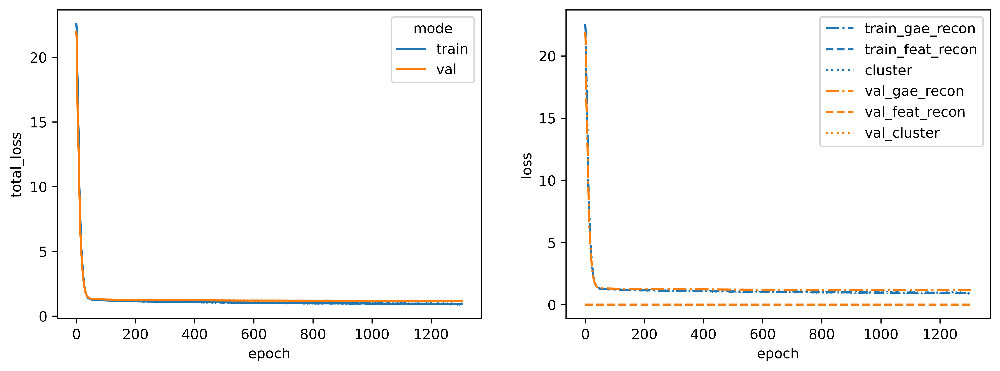

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CEBPA


 14%|█▎        | 1365/10000 [00:27<02:56, 48.81it/s]


Training stopped after 1366 epochs
Best model found at epoch 1264
------------------------------------------------------------
TEST AUC: 0.8393650793650793 AP: 0.8728333344358624
TRAIN loss: 0.9359539151191711
VAL loss: 0.9966502785682678
TEST loss: 1.0840610265731812
TEST AUC: 0.8393650793650793 	 AP: 0.8728333344358624


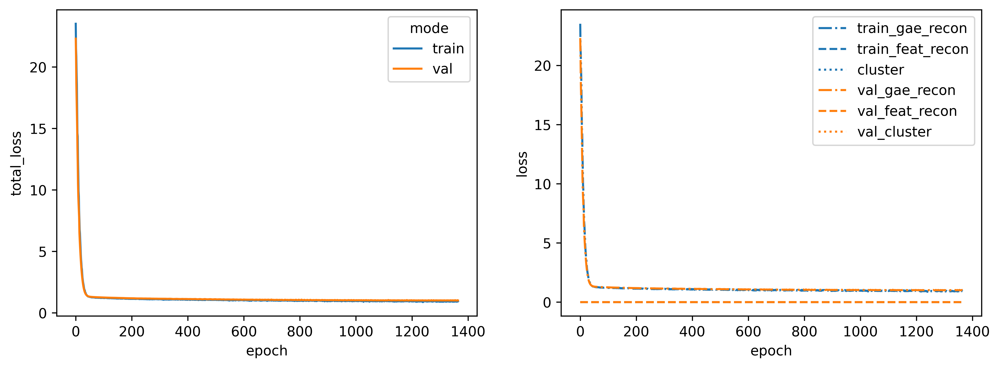

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CREB1


 11%|█         | 1117/10000 [00:24<03:13, 45.82it/s]


Training stopped after 1118 epochs
Best model found at epoch 1016
------------------------------------------------------------
TEST AUC: 0.8457142857142856 AP: 0.8847565861762088
TRAIN loss: 0.9971599578857422
VAL loss: 1.0080499649047852
TEST loss: 1.0655388832092285
TEST AUC: 0.8457142857142856 	 AP: 0.8847565861762088


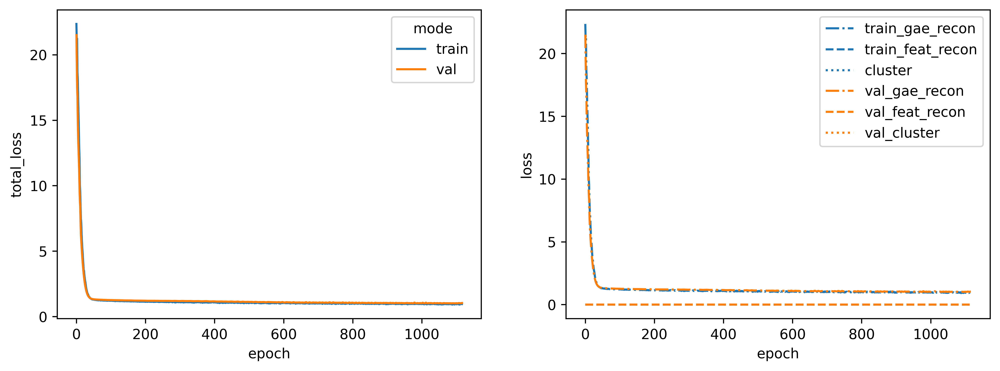

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CXXC4


 11%|█▏        | 1132/10000 [00:22<02:52, 51.32it/s]


Training stopped after 1133 epochs
Best model found at epoch 1031
------------------------------------------------------------
TEST AUC: 0.8420861678004534 AP: 0.8624610754594099
TRAIN loss: 0.9739798307418823
VAL loss: 0.9807049036026001
TEST loss: 1.0598695278167725
TEST AUC: 0.8420861678004534 	 AP: 0.8624610754594099


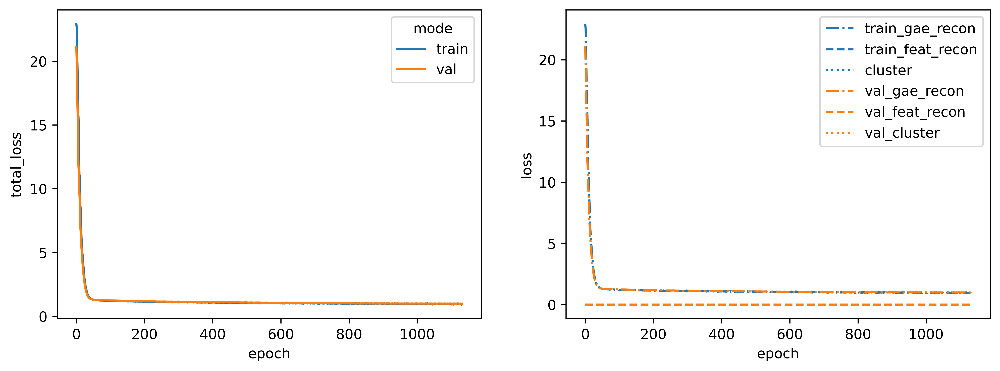

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


DIABLO


 16%|█▌        | 1592/10000 [00:33<02:54, 48.10it/s]


Training stopped after 1593 epochs
Best model found at epoch 1491
------------------------------------------------------------
TEST AUC: 0.8329251700680272 AP: 0.8651106744452388
TRAIN loss: 0.8780023455619812
VAL loss: 1.1243683099746704
TEST loss: 1.0948529243469238
TEST AUC: 0.8329251700680272 	 AP: 0.8651106744452388


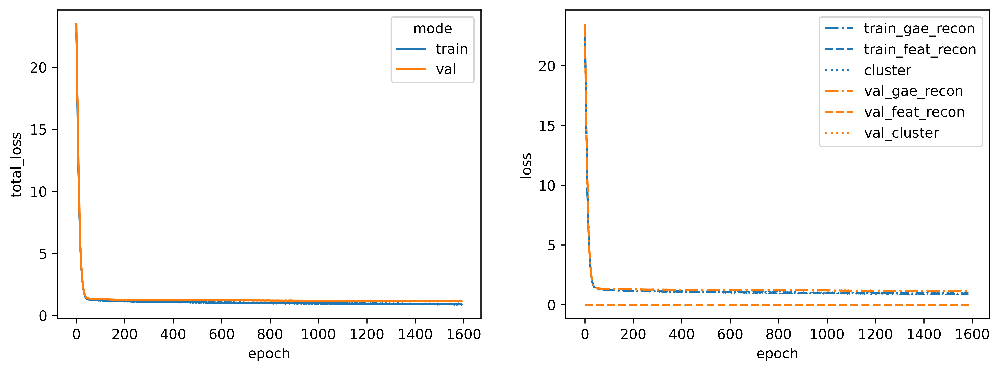

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


E2F1


  9%|▊         | 851/10000 [00:19<03:28, 43.93it/s]


Training stopped after 852 epochs
Best model found at epoch 750
------------------------------------------------------------
TEST AUC: 0.8388208616780045 AP: 0.8602323626467563
TRAIN loss: 1.005303978919983
VAL loss: 0.9813528656959534
TEST loss: 1.1006475687026978
TEST AUC: 0.8388208616780045 	 AP: 0.8602323626467563


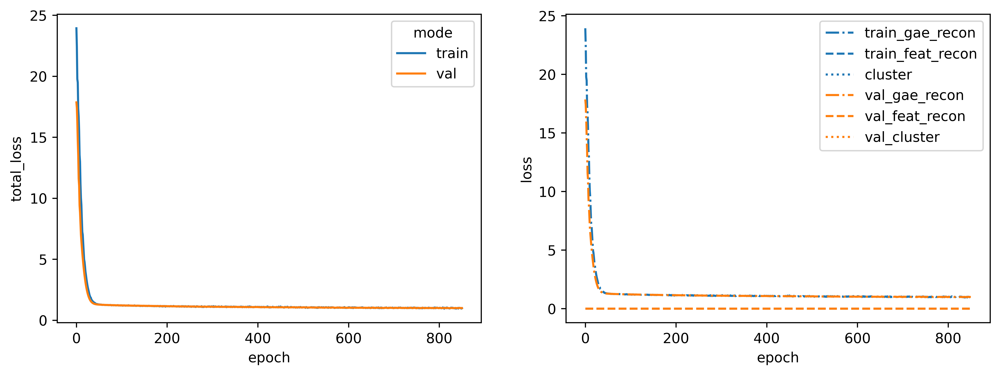

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ELK1


  9%|▉         | 912/10000 [00:17<02:53, 52.44it/s]


Training stopped after 913 epochs
Best model found at epoch 811
------------------------------------------------------------
TEST AUC: 0.8238548752834467 AP: 0.852800790898846
TRAIN loss: 1.0256338119506836
VAL loss: 1.0510143041610718
TEST loss: 1.1115950345993042
TEST AUC: 0.8238548752834467 	 AP: 0.852800790898846


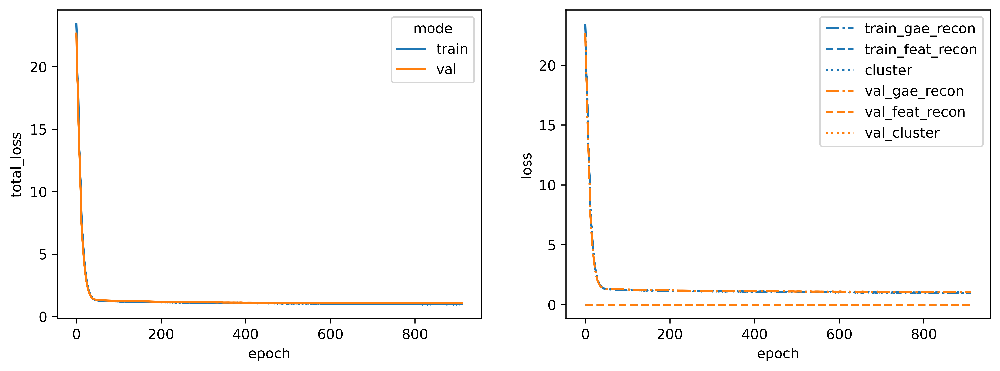

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


EMPTY


 12%|█▏        | 1152/10000 [00:22<02:52, 51.40it/s]


Training stopped after 1153 epochs
Best model found at epoch 1051
------------------------------------------------------------
TEST AUC: 0.8061678004535147 AP: 0.8207255544845876
TRAIN loss: 0.9553848505020142
VAL loss: 1.0067200660705566
TEST loss: 1.1668695211410522
TEST AUC: 0.8061678004535147 	 AP: 0.8207255544845876


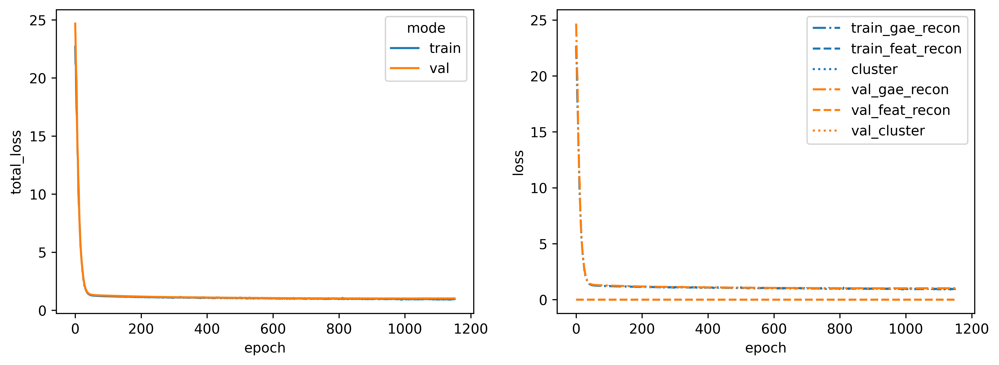

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ERG


 11%|█         | 1120/10000 [00:23<03:10, 46.69it/s]


Training stopped after 1121 epochs
Best model found at epoch 1019
------------------------------------------------------------
TEST AUC: 0.786485260770975 AP: 0.799080604104515
TRAIN loss: 0.9538989663124084
VAL loss: 1.052478551864624
TEST loss: 1.2102653980255127
TEST AUC: 0.786485260770975 	 AP: 0.799080604104515


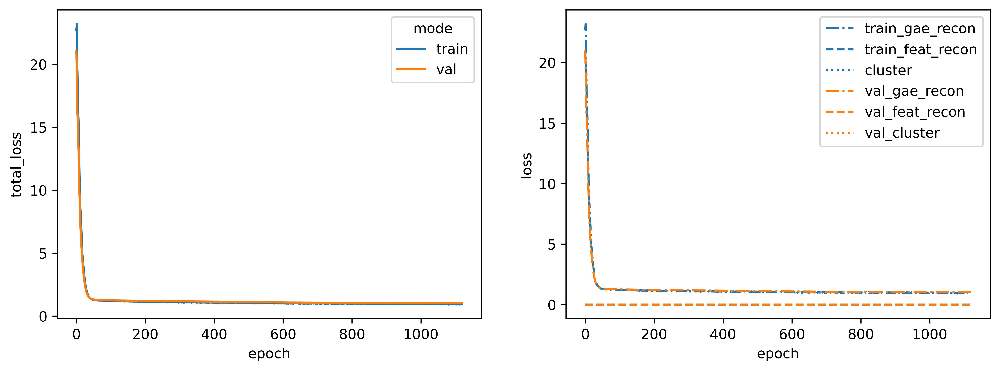

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FGFR3


 12%|█▏        | 1208/10000 [00:25<03:07, 46.89it/s]


Training stopped after 1209 epochs
Best model found at epoch 1107
------------------------------------------------------------
TEST AUC: 0.7965532879818594 AP: 0.8205650348155531
TRAIN loss: 0.9621391296386719
VAL loss: 1.0233324766159058
TEST loss: 1.1812891960144043
TEST AUC: 0.7965532879818594 	 AP: 0.8205650348155531


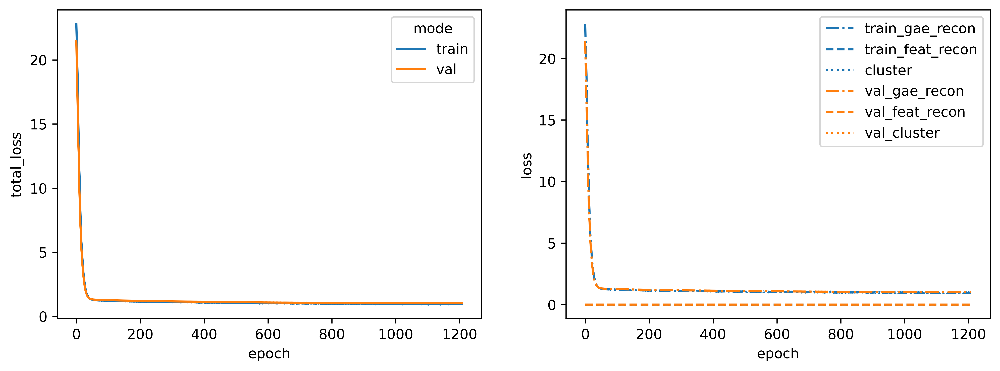

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FOXO1


 15%|█▌        | 1531/10000 [00:32<02:58, 47.38it/s]


Training stopped after 1532 epochs
Best model found at epoch 1430
------------------------------------------------------------
TEST AUC: 0.807891156462585 AP: 0.8432894162873771
TRAIN loss: 0.8900015950202942
VAL loss: 1.0659983158111572
TEST loss: 1.167893648147583
TEST AUC: 0.807891156462585 	 AP: 0.8432894162873771


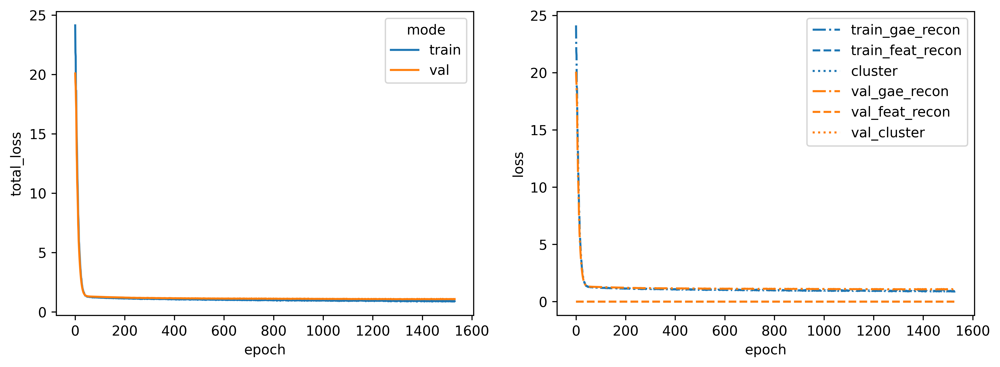

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


GLI1


  8%|▊         | 833/10000 [00:17<03:15, 46.93it/s]


Training stopped after 834 epochs
Best model found at epoch 732
------------------------------------------------------------
TEST AUC: 0.8019047619047619 AP: 0.8147577201117924
TRAIN loss: 0.9772728085517883
VAL loss: 1.0154383182525635
TEST loss: 1.1756327152252197
TEST AUC: 0.8019047619047619 	 AP: 0.8147577201117924


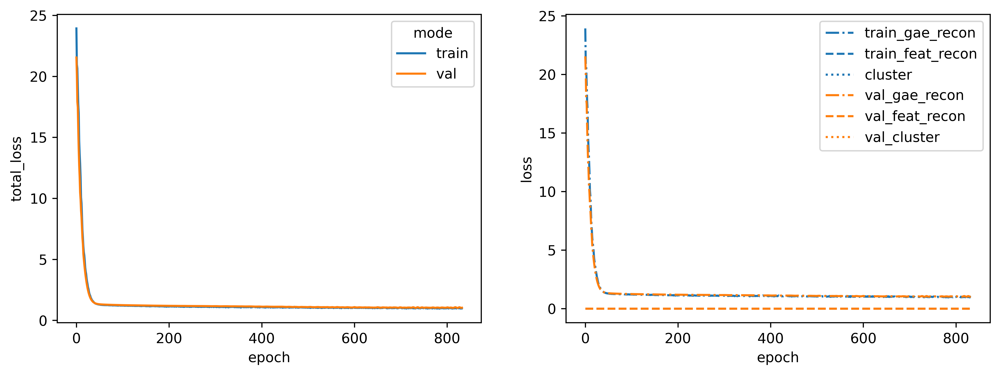

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


HRAS


  7%|▋         | 747/10000 [00:16<03:21, 46.01it/s]


Training stopped after 748 epochs
Best model found at epoch 646
------------------------------------------------------------
TEST AUC: 0.8156009070294784 AP: 0.8246113651154036
TRAIN loss: 1.0350462198257446
VAL loss: 1.0946890115737915
TEST loss: 1.1655874252319336
TEST AUC: 0.8156009070294784 	 AP: 0.8246113651154036


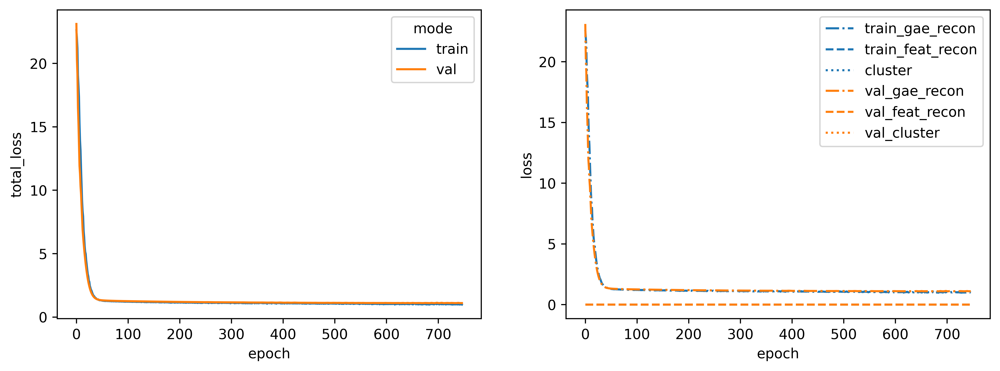

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


IRAK4


 13%|█▎        | 1349/10000 [00:29<03:11, 45.15it/s]


Training stopped after 1350 epochs
Best model found at epoch 1248
------------------------------------------------------------
TEST AUC: 0.8159637188208616 AP: 0.8465524103818857
TRAIN loss: 0.934441864490509
VAL loss: 1.0582337379455566
TEST loss: 1.1470975875854492
TEST AUC: 0.8159637188208616 	 AP: 0.8465524103818857


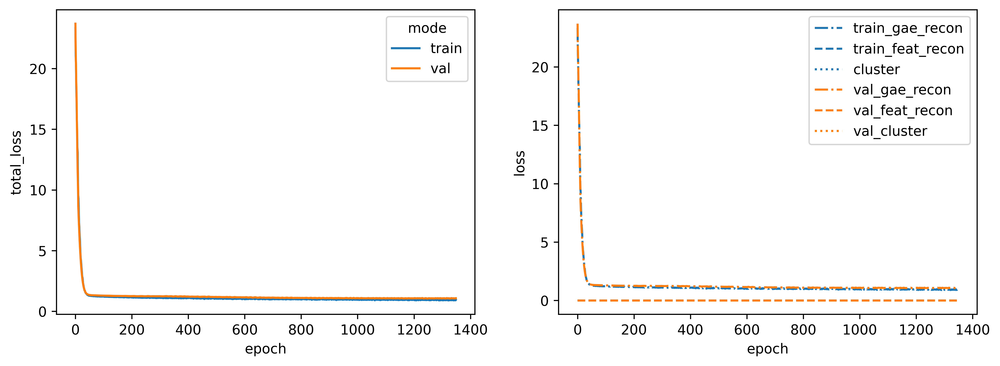

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


JUN


 13%|█▎        | 1260/10000 [00:28<03:17, 44.15it/s]


Training stopped after 1261 epochs
Best model found at epoch 1159
------------------------------------------------------------
TEST AUC: 0.811156462585034 AP: 0.8531414704990495
TRAIN loss: 0.9313960075378418
VAL loss: 0.9554224014282227
TEST loss: 1.1570990085601807
TEST AUC: 0.811156462585034 	 AP: 0.8531414704990495


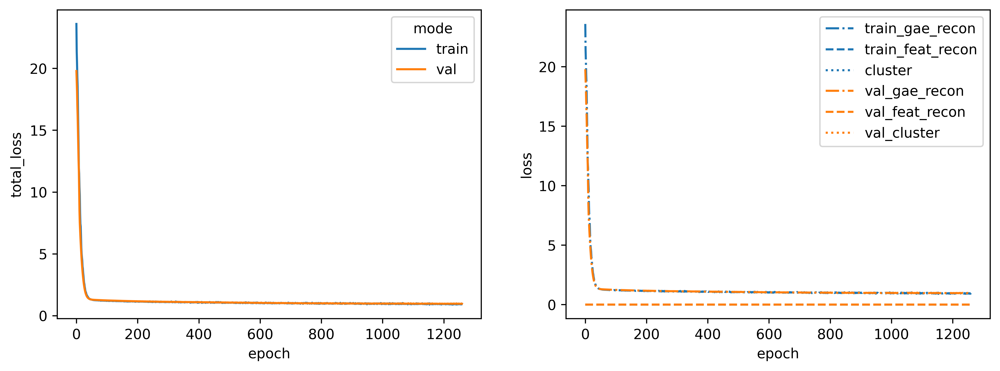

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP2K3


 15%|█▍        | 1484/10000 [00:31<03:02, 46.63it/s]


Training stopped after 1485 epochs
Best model found at epoch 1383
------------------------------------------------------------
TEST AUC: 0.8453514739229027 AP: 0.8815235500986062
TRAIN loss: 0.9138467311859131
VAL loss: 0.9547131061553955
TEST loss: 1.064082384109497
TEST AUC: 0.8453514739229027 	 AP: 0.8815235500986062


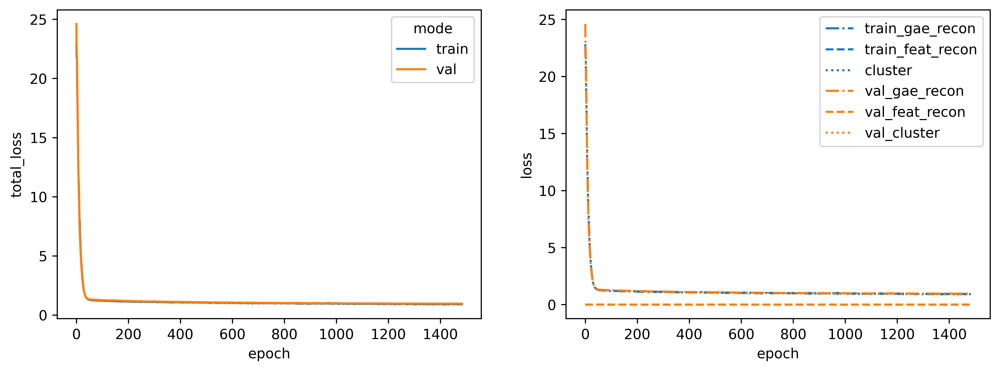

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K2


 10%|▉         | 975/10000 [00:19<02:58, 50.57it/s]


Training stopped after 976 epochs
Best model found at epoch 874
------------------------------------------------------------
TEST AUC: 0.8059863945578231 AP: 0.827758157965464
TRAIN loss: 1.0030455589294434
VAL loss: 1.025284767150879
TEST loss: 1.1506167650222778
TEST AUC: 0.8059863945578231 	 AP: 0.827758157965464


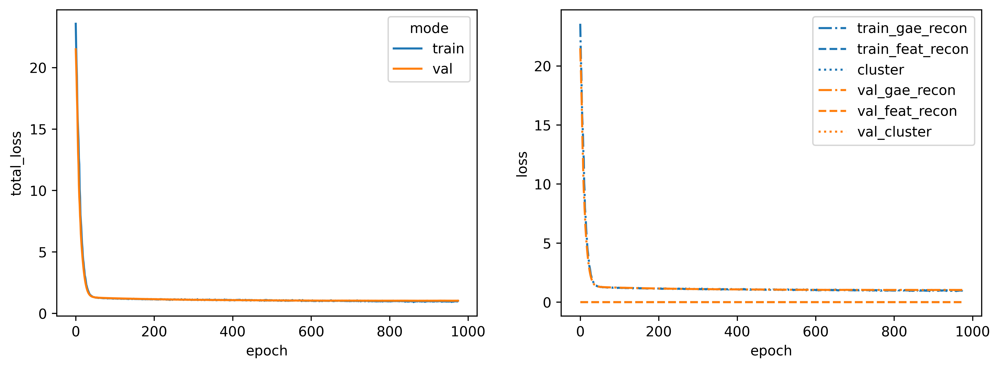

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K5


 11%|█         | 1066/10000 [00:23<03:17, 45.14it/s]


Training stopped after 1067 epochs
Best model found at epoch 965
------------------------------------------------------------
TEST AUC: 0.8228571428571428 AP: 0.8372926390987265
TRAIN loss: 0.9732075929641724
VAL loss: 1.1057509183883667
TEST loss: 1.1434566974639893
TEST AUC: 0.8228571428571428 	 AP: 0.8372926390987265


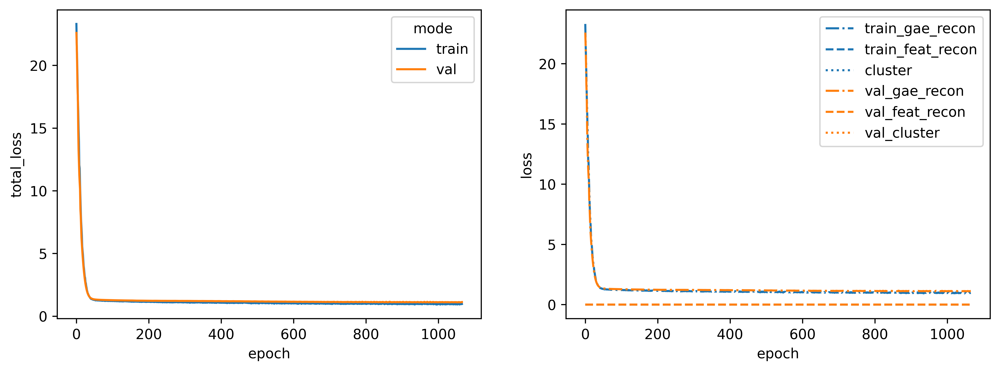

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K9


 10%|█         | 1015/10000 [00:21<03:12, 46.66it/s]


Training stopped after 1016 epochs
Best model found at epoch 914
------------------------------------------------------------
TEST AUC: 0.8183219954648526 AP: 0.8608985527134372
TRAIN loss: 0.9693111181259155
VAL loss: 1.0162580013275146
TEST loss: 1.1375333070755005
TEST AUC: 0.8183219954648526 	 AP: 0.8608985527134372


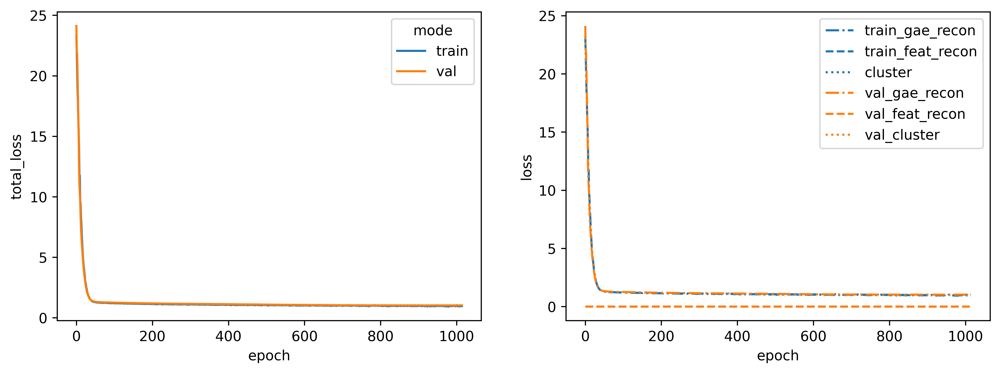

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAPK7


 13%|█▎        | 1325/10000 [00:25<02:44, 52.58it/s]


Training stopped after 1326 epochs
Best model found at epoch 1224
------------------------------------------------------------
TEST AUC: 0.8265759637188208 AP: 0.8559891182539625
TRAIN loss: 0.9688328504562378
VAL loss: 1.056340217590332
TEST loss: 1.1165087223052979
TEST AUC: 0.8265759637188208 	 AP: 0.8559891182539625


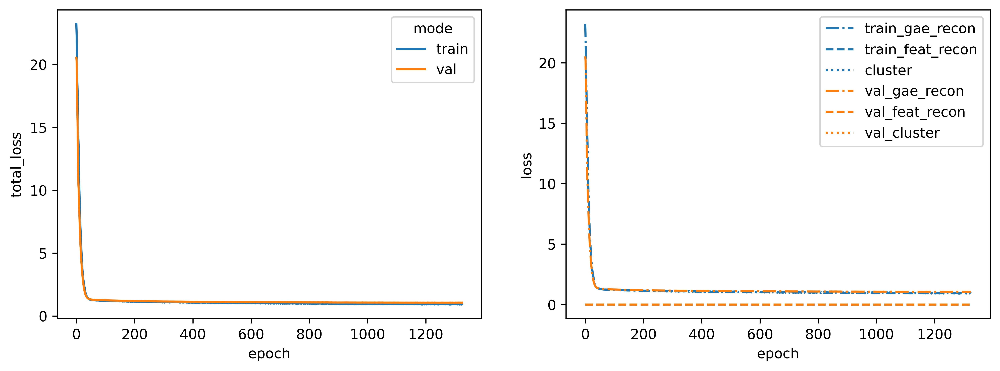

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MOS


  7%|▋         | 659/10000 [00:14<03:20, 46.51it/s]


Training stopped after 660 epochs
Best model found at epoch 558
------------------------------------------------------------
TEST AUC: 0.7834920634920635 AP: 0.8041365826765349
TRAIN loss: 1.0407114028930664
VAL loss: 1.1525778770446777
TEST loss: 1.1952632665634155
TEST AUC: 0.7834920634920635 	 AP: 0.8041365826765349


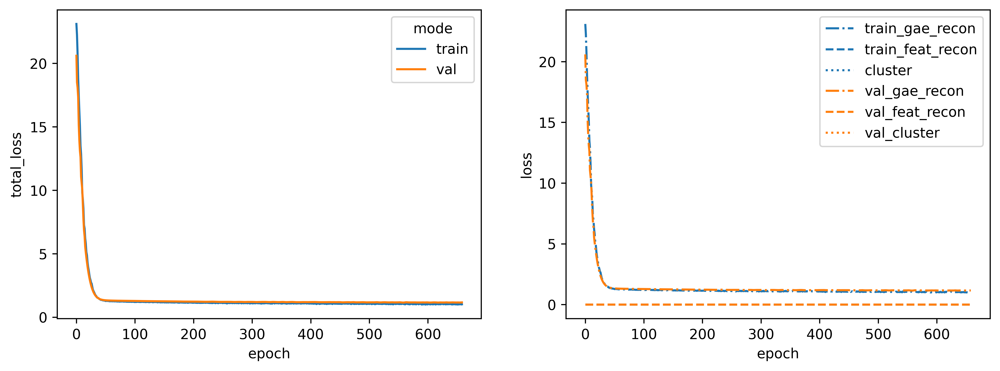

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MYD88


 12%|█▏        | 1192/10000 [00:25<03:09, 46.36it/s]


Training stopped after 1193 epochs
Best model found at epoch 1091
------------------------------------------------------------
TEST AUC: 0.8360997732426303 AP: 0.8685494125646698
TRAIN loss: 0.9521405696868896
VAL loss: 1.0866711139678955
TEST loss: 1.0790948867797852
TEST AUC: 0.8360997732426303 	 AP: 0.8685494125646698


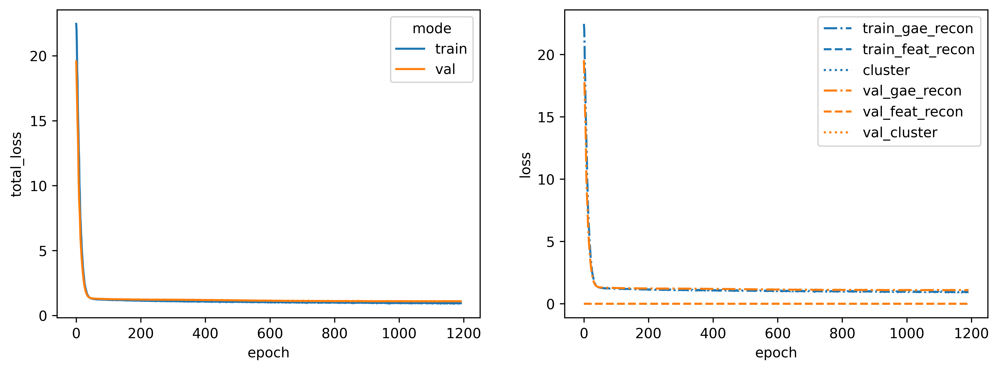

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PIK3R2


 11%|█▏        | 1137/10000 [00:24<03:07, 47.15it/s]


Training stopped after 1138 epochs
Best model found at epoch 1036
------------------------------------------------------------
TEST AUC: 0.7984580498866213 AP: 0.8302243892482034
TRAIN loss: 0.9645348787307739
VAL loss: 1.0534560680389404
TEST loss: 1.17391037940979
TEST AUC: 0.7984580498866213 	 AP: 0.8302243892482034


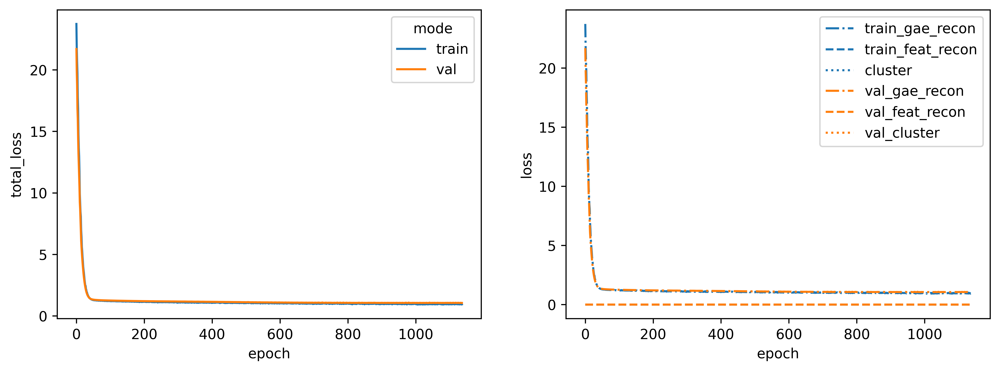

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKACA


 14%|█▍        | 1384/10000 [00:31<03:18, 43.48it/s]


Training stopped after 1385 epochs
Best model found at epoch 1283
------------------------------------------------------------
TEST AUC: 0.8217687074829932 AP: 0.8495207581393351
TRAIN loss: 0.9505965709686279
VAL loss: 0.9465612173080444
TEST loss: 1.1360301971435547
TEST AUC: 0.8217687074829932 	 AP: 0.8495207581393351


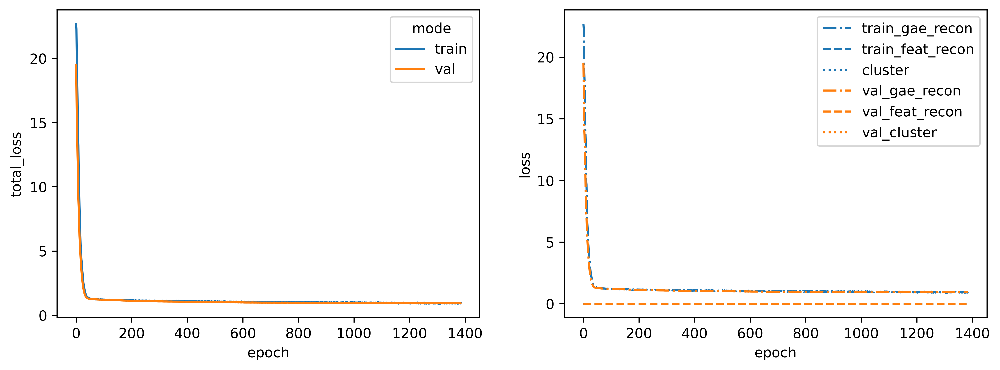

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKCE


 11%|█▏        | 1142/10000 [00:24<03:12, 46.05it/s]


Training stopped after 1143 epochs
Best model found at epoch 1041
------------------------------------------------------------
TEST AUC: 0.8420861678004534 AP: 0.8664453074870684
TRAIN loss: 0.986927330493927
VAL loss: 0.9852551221847534
TEST loss: 1.0616968870162964
TEST AUC: 0.8420861678004534 	 AP: 0.8664453074870684


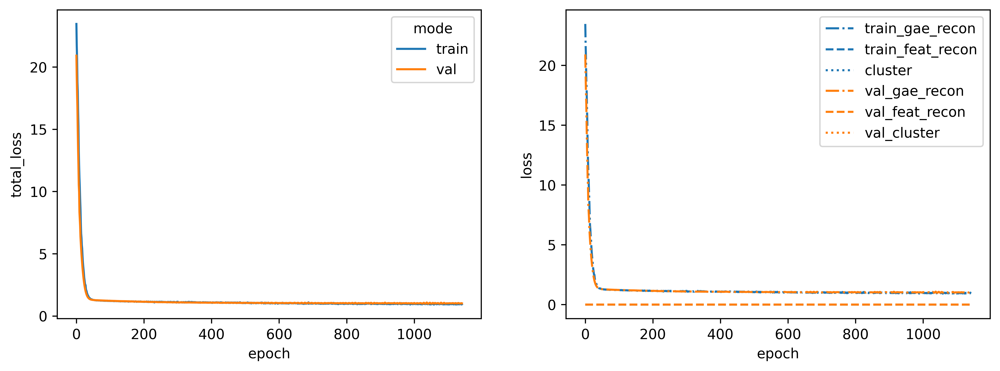

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RAF1


 14%|█▍        | 1402/10000 [00:30<03:05, 46.42it/s]


Training stopped after 1403 epochs
Best model found at epoch 1301
------------------------------------------------------------
TEST AUC: 0.8385487528344672 AP: 0.8778865554232738
TRAIN loss: 0.9411904215812683
VAL loss: 0.9853305816650391
TEST loss: 1.0735642910003662
TEST AUC: 0.8385487528344672 	 AP: 0.8778865554232738


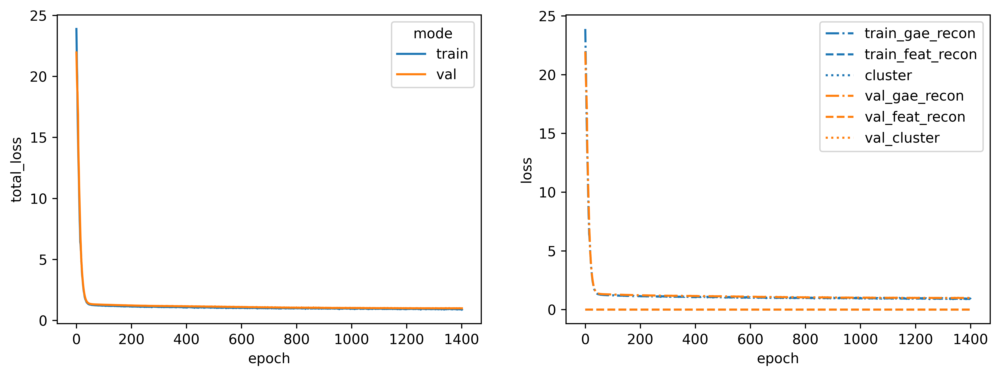

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RELB


 15%|█▍        | 1476/10000 [00:31<03:02, 46.79it/s]


Training stopped after 1477 epochs
Best model found at epoch 1375
------------------------------------------------------------
TEST AUC: 0.8118820861678006 AP: 0.8180872863013244
TRAIN loss: 0.9291226863861084
VAL loss: 1.0643186569213867
TEST loss: 1.156887173652649
TEST AUC: 0.8118820861678006 	 AP: 0.8180872863013244


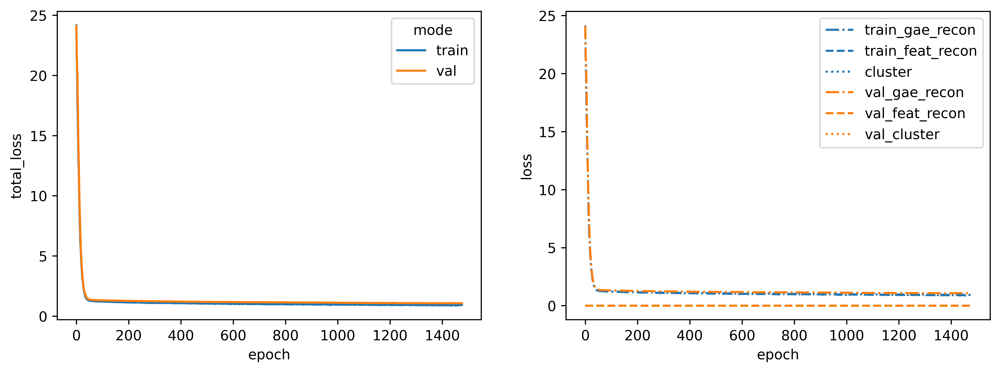

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RHOA


 16%|█▌        | 1558/10000 [00:33<02:59, 47.00it/s]


Training stopped after 1559 epochs
Best model found at epoch 1457
------------------------------------------------------------
TEST AUC: 0.8499773242630384 AP: 0.8837142497686595
TRAIN loss: 0.9444078803062439
VAL loss: 1.0009413957595825
TEST loss: 1.0428376197814941
TEST AUC: 0.8499773242630384 	 AP: 0.8837142497686595


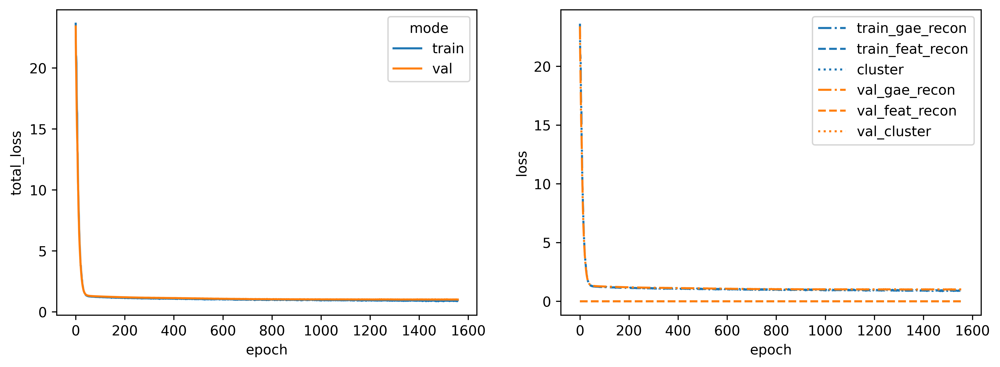

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMAD4


 15%|█▌        | 1504/10000 [00:31<02:58, 47.60it/s]


Training stopped after 1505 epochs
Best model found at epoch 1403
------------------------------------------------------------
TEST AUC: 0.8370068027210884 AP: 0.8790025354452062
TRAIN loss: 0.9101016521453857
VAL loss: 0.968010425567627
TEST loss: 1.0890107154846191
TEST AUC: 0.8370068027210884 	 AP: 0.8790025354452062


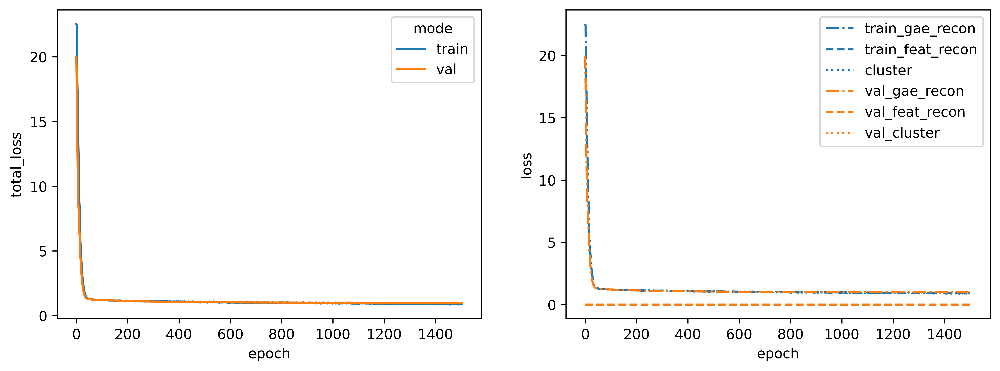

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMO


  9%|▉         | 897/10000 [00:18<03:10, 47.80it/s]


Training stopped after 898 epochs
Best model found at epoch 796
------------------------------------------------------------
TEST AUC: 0.8268480725623583 AP: 0.8268483788247271
TRAIN loss: 0.9821492433547974
VAL loss: 1.1937147378921509
TEST loss: 1.124283790588379
TEST AUC: 0.8268480725623583 	 AP: 0.8268483788247271


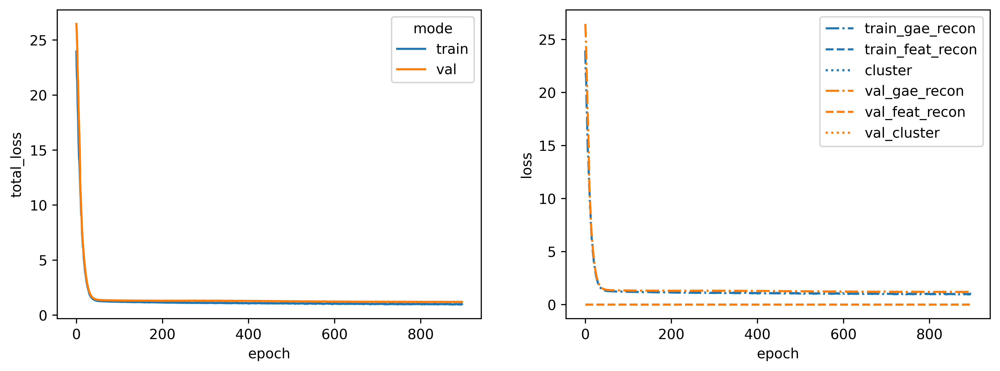

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SRC


 12%|█▏        | 1207/10000 [00:24<03:01, 48.43it/s]


Training stopped after 1208 epochs
Best model found at epoch 1106
------------------------------------------------------------
TEST AUC: 0.8089795918367347 AP: 0.8351511299059116
TRAIN loss: 0.9595912098884583
VAL loss: 1.007914423942566
TEST loss: 1.1465528011322021
TEST AUC: 0.8089795918367347 	 AP: 0.8351511299059116


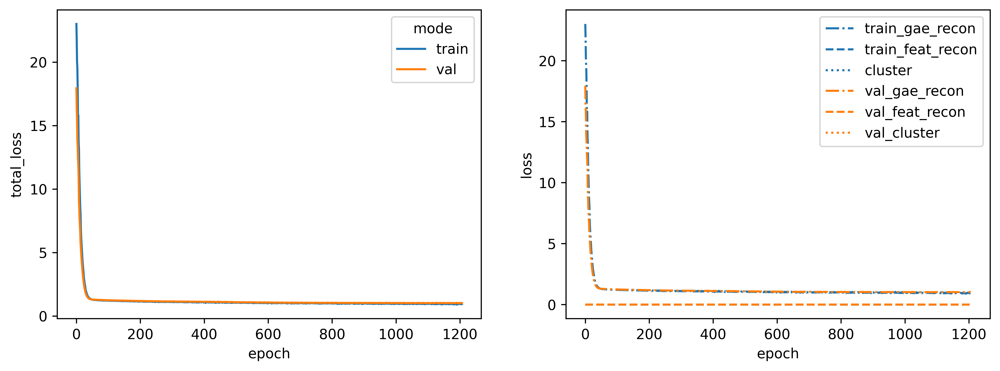

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SREBF1


 16%|█▌        | 1581/10000 [00:31<02:46, 50.48it/s]


Training stopped after 1582 epochs
Best model found at epoch 1480
------------------------------------------------------------
TEST AUC: 0.7987301587301588 AP: 0.8290413806220596
TRAIN loss: 0.9547251462936401
VAL loss: 1.003647804260254
TEST loss: 1.2131569385528564
TEST AUC: 0.7987301587301588 	 AP: 0.8290413806220596


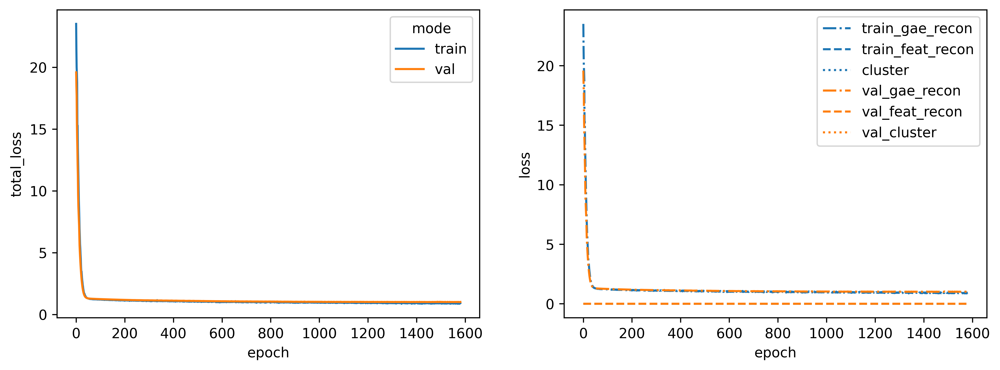

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TRAF2


 12%|█▏        | 1233/10000 [00:23<02:44, 53.30it/s]


Training stopped after 1234 epochs
Best model found at epoch 1132
------------------------------------------------------------
TEST AUC: 0.85015873015873 AP: 0.8936327197960244
TRAIN loss: 0.9528930187225342
VAL loss: 1.0715113878250122
TEST loss: 1.0609785318374634
TEST AUC: 0.85015873015873 	 AP: 0.8936327197960244


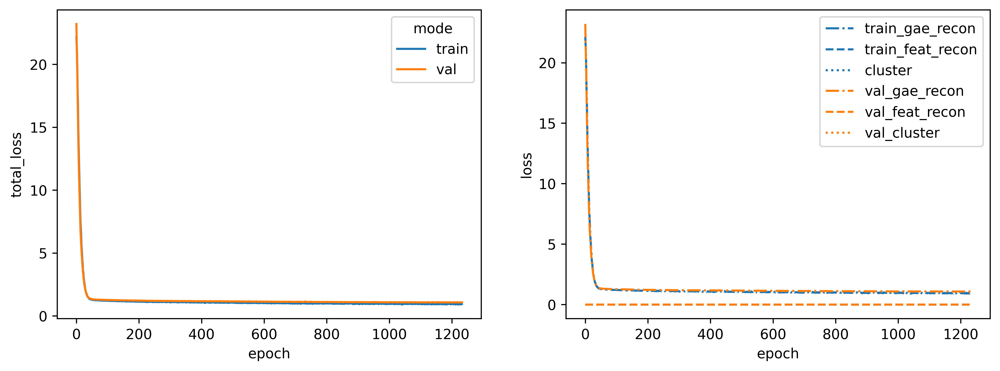

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TSC2


  9%|▊         | 857/10000 [00:18<03:15, 46.88it/s]


Training stopped after 858 epochs
Best model found at epoch 756
------------------------------------------------------------
TEST AUC: 0.8212244897959182 AP: 0.8454749337549325
TRAIN loss: 1.0085158348083496
VAL loss: 1.097021460533142
TEST loss: 1.1298961639404297
TEST AUC: 0.8212244897959182 	 AP: 0.8454749337549325


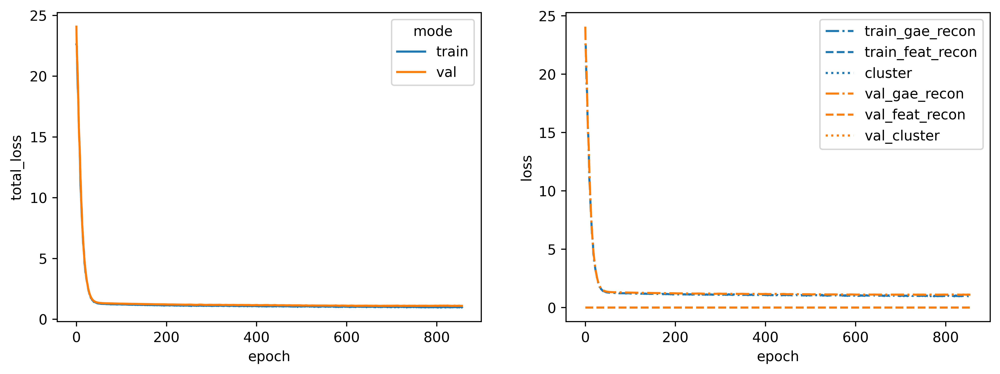

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


WWTR1


 10%|▉         | 989/10000 [00:21<03:12, 46.92it/s]


Training stopped after 990 epochs
Best model found at epoch 888
------------------------------------------------------------
TEST AUC: 0.7990022675736962 AP: 0.822691371286687
TRAIN loss: 0.9524382948875427
VAL loss: 1.0730080604553223
TEST loss: 1.1704742908477783
TEST AUC: 0.7990022675736962 	 AP: 0.822691371286687


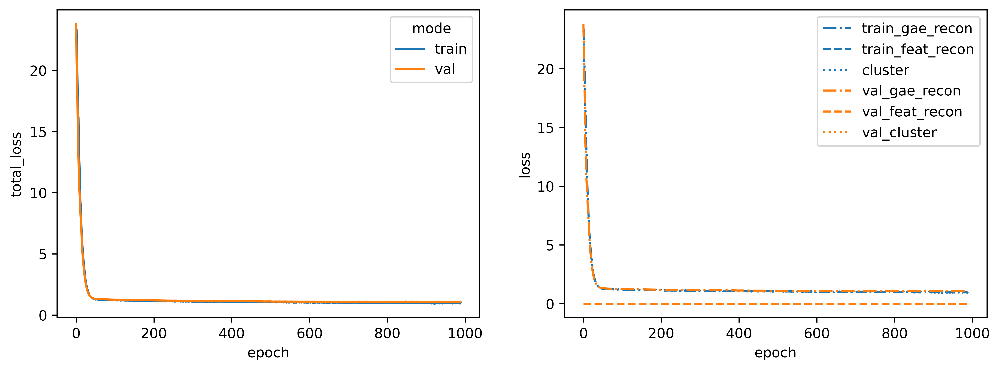

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


<IPython.core.display.Javascript object>

In [77]:
for alpha, beta, gamma in alpha_beta_gamma_opts:
    run_reg_space_loto_exp(
        root_output_dir=root_output_dir,
        oe_targets=oe_targets,
        interactome=spearman_interactome,
        physical_cluster_dict=physical_cluster_dict,
        physical_full_cluster_dict=physical_full_cluster_dict,
        cmap_clusters=cmap_clusters,
        cluster_opt=cluster_opt,
        graph_opt=graph_opt,
        alpha=alpha,
        beta=beta,
        gamma=gamma,
        n_classes=10,
        seed=5678,
        node_feature_key="sc_gex_hallmark",
        input_dim=1176,
        latent_dim=1024,
        early_stopping=100,
        neg_edge_ratio=1,
        lr=0.00001,
    )

dict_keys(['AKT1S1', 'ATF4', 'BAX', 'BCL2L11', 'BRAF', 'CASP8', 'CDC42', 'CDKN1A', 'CEBPA', 'CREB1', 'CXXC4', 'DIABLO', 'E2F1', 'ELK1', 'EMPTY', 'ERG', 'FGFR3', 'FOXO1', 'GLI1', 'HRAS', 'IRAK4', 'JUN', 'MAP2K3', 'MAP3K2', 'MAP3K5', 'MAP3K9', 'MAPK7', 'MOS', 'MYD88', 'PIK3R2', 'PRKACA', 'PRKCE', 'RAF1', 'RELB', 'RHOA', 'SMAD4', 'SMO', 'SRC', 'SREBF1', 'TRAF2', 'TSC2', 'WWTR1'])
AKT1S1


 64%|██████▎   | 6367/10000 [02:16<01:17, 46.69it/s]


Training stopped after 6368 epochs
Best model found at epoch 6266
------------------------------------------------------------
TEST AUC: 0.7788662131519274 AP: 0.8039454522442175
TRAIN loss: 1.0735704898834229
VAL loss: 1.3311115503311157
TEST loss: 1.4325217008590698
TEST AUC: 0.7788662131519274 	 AP: 0.8039454522442175


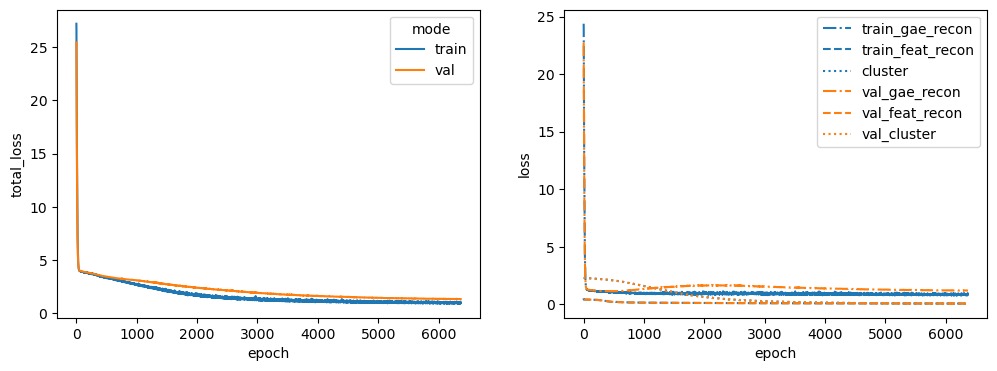

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ATF4


 22%|██▏       | 2206/10000 [00:41<02:27, 52.90it/s]


Training stopped after 2207 epochs
Best model found at epoch 2105
------------------------------------------------------------
TEST AUC: 0.8093424036281179 AP: 0.7939095137315685
TRAIN loss: 1.517746925354004
VAL loss: 1.90423583984375
TEST loss: 1.9390411376953125
TEST AUC: 0.8093424036281179 	 AP: 0.7939095137315685


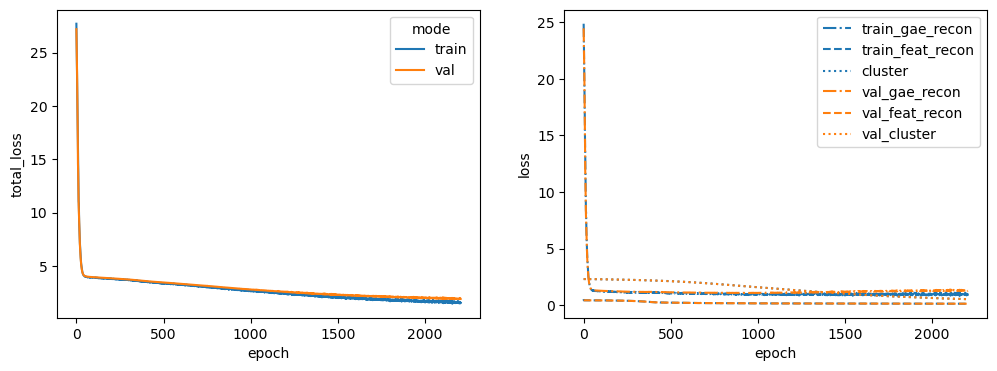

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BAX


 35%|███▍      | 3489/10000 [01:15<02:20, 46.28it/s]


Training stopped after 3490 epochs
Best model found at epoch 3388
------------------------------------------------------------
TEST AUC: 0.7941043083900227 AP: 0.8233767397009182
TRAIN loss: 1.262175440788269
VAL loss: 1.8157795667648315
TEST loss: 1.5766501426696777
TEST AUC: 0.7941043083900227 	 AP: 0.8233767397009182


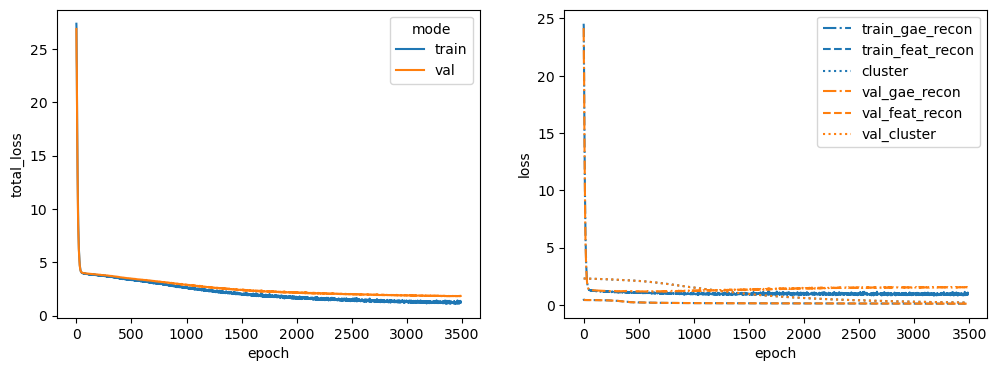

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BCL2L11


 37%|███▋      | 3689/10000 [01:22<02:20, 44.89it/s]


Training stopped after 3690 epochs
Best model found at epoch 3588
------------------------------------------------------------
TEST AUC: 0.7648072562358277 AP: 0.7873935159308636
TRAIN loss: 1.3017714023590088
VAL loss: 1.7590526342391968
TEST loss: 1.688416600227356
TEST AUC: 0.7648072562358277 	 AP: 0.7873935159308636


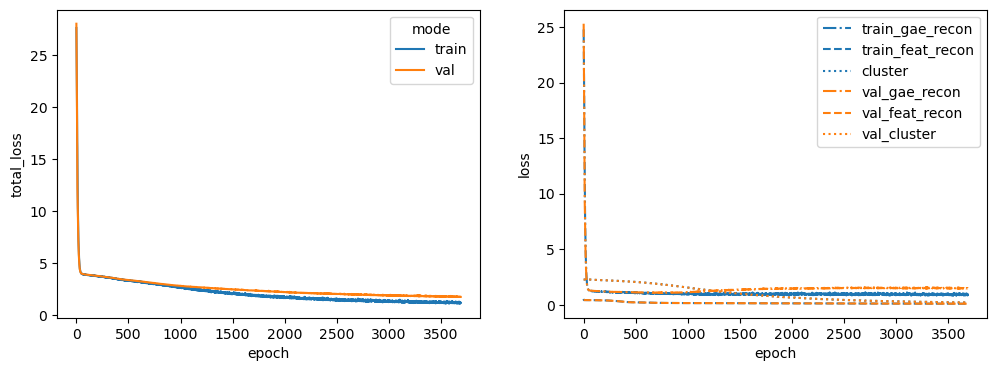

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BRAF


 27%|██▋       | 2725/10000 [01:02<02:45, 43.86it/s]


Training stopped after 2726 epochs
Best model found at epoch 2624
------------------------------------------------------------
TEST AUC: 0.7749659863945578 AP: 0.7754903651888759
TRAIN loss: 1.4632749557495117
VAL loss: 1.7406795024871826
TEST loss: 1.836835503578186
TEST AUC: 0.7749659863945578 	 AP: 0.7754903651888759


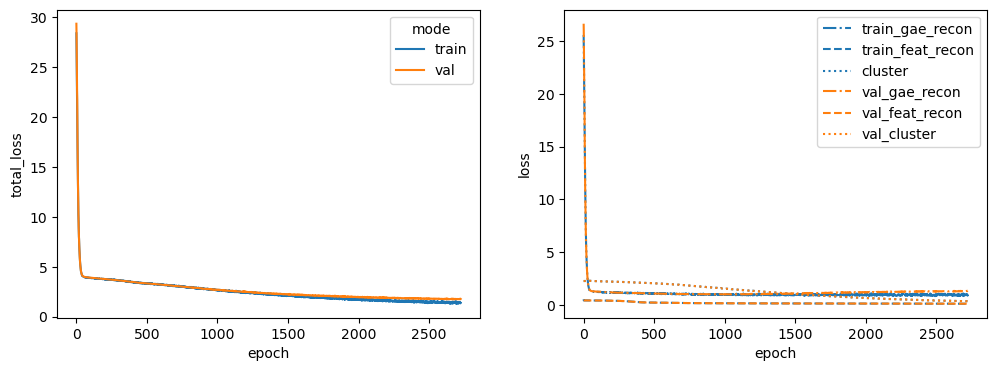

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CASP8


 46%|████▌     | 4568/10000 [01:48<02:08, 42.22it/s]


Training stopped after 4569 epochs
Best model found at epoch 4467
------------------------------------------------------------
TEST AUC: 0.8095238095238096 AP: 0.8502414800758211
TRAIN loss: 1.1377004384994507
VAL loss: 1.7218765020370483
TEST loss: 1.4136134386062622
TEST AUC: 0.8095238095238096 	 AP: 0.8502414800758211


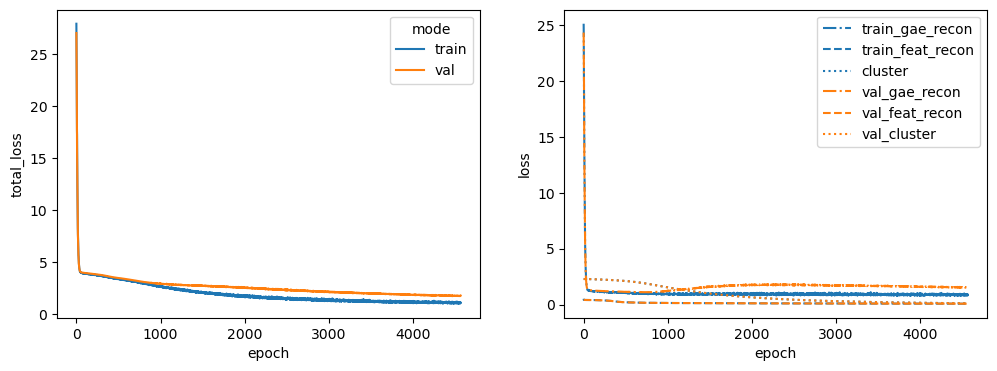

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDC42


 42%|████▏     | 4228/10000 [01:42<02:19, 41.37it/s]


Training stopped after 4229 epochs
Best model found at epoch 4127
------------------------------------------------------------
TEST AUC: 0.7980045351473922 AP: 0.790105806769551
TRAIN loss: 1.1547017097473145
VAL loss: 1.375331997871399
TEST loss: 1.5371428728103638
TEST AUC: 0.7980045351473922 	 AP: 0.790105806769551


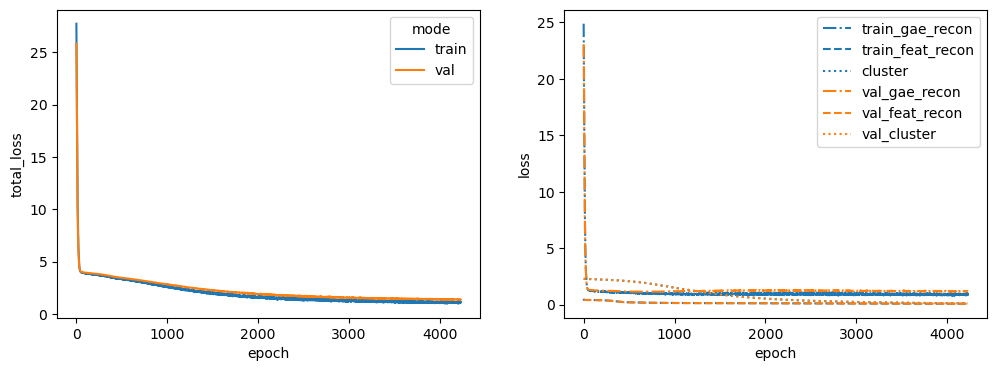

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDKN1A


 50%|████▉     | 4951/10000 [02:00<02:02, 41.22it/s]


Training stopped after 4952 epochs
Best model found at epoch 4850
------------------------------------------------------------
TEST AUC: 0.8215873015873015 AP: 0.8199648481245231
TRAIN loss: 1.0330206155776978
VAL loss: 1.3262532949447632
TEST loss: 1.3938302993774414
TEST AUC: 0.8215873015873015 	 AP: 0.8199648481245231


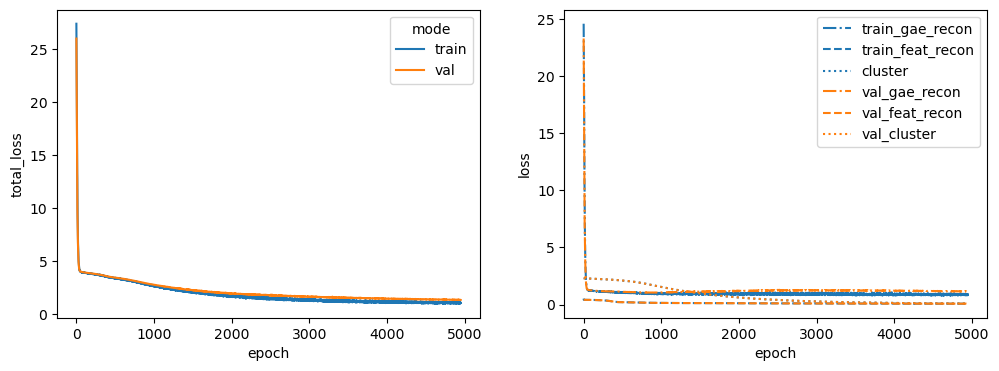

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CEBPA


 44%|████▍     | 4417/10000 [01:47<02:15, 41.18it/s]


Training stopped after 4418 epochs
Best model found at epoch 4316
------------------------------------------------------------
TEST AUC: 0.7787755102040818 AP: 0.7359531199452165
TRAIN loss: 1.1577870845794678
VAL loss: 1.2906781435012817
TEST loss: 1.704185128211975
TEST AUC: 0.7787755102040818 	 AP: 0.7359531199452165


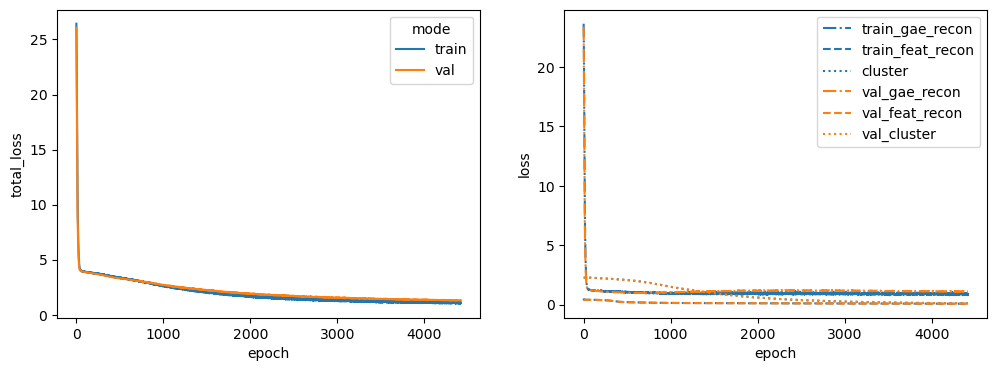

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CREB1


 56%|█████▌    | 5566/10000 [02:11<01:45, 42.20it/s]


Training stopped after 5567 epochs
Best model found at epoch 5465
------------------------------------------------------------
TEST AUC: 0.7919274376417235 AP: 0.8080674063552321
TRAIN loss: 1.0656574964523315
VAL loss: 1.213150143623352
TEST loss: 1.436050295829773
TEST AUC: 0.7919274376417235 	 AP: 0.8080674063552321


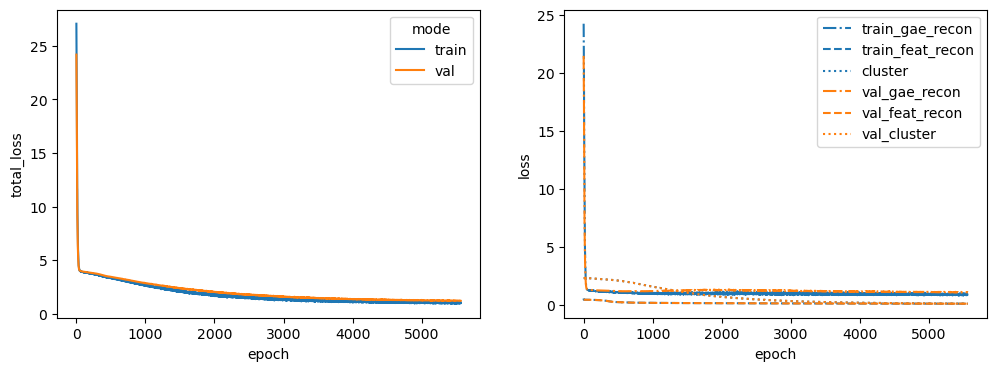

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CXXC4


 41%|████      | 4060/10000 [01:37<02:21, 41.84it/s]


Training stopped after 4061 epochs
Best model found at epoch 3959
------------------------------------------------------------
TEST AUC: 0.7816780045351474 AP: 0.7949853191651859
TRAIN loss: 1.114303708076477
VAL loss: 1.3343037366867065
TEST loss: 1.5428104400634766
TEST AUC: 0.7816780045351474 	 AP: 0.7949853191651859


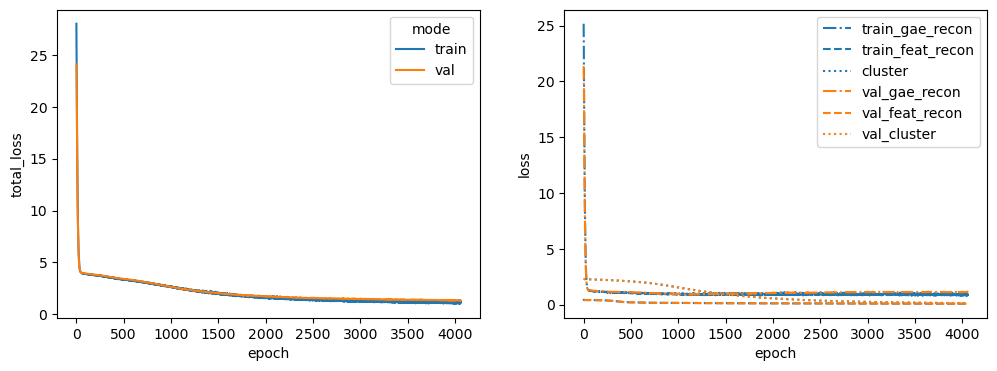

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


DIABLO


 48%|████▊     | 4760/10000 [01:52<02:04, 42.18it/s]


Training stopped after 4761 epochs
Best model found at epoch 4659
------------------------------------------------------------
TEST AUC: 0.8159637188208616 AP: 0.8320556757959927
TRAIN loss: 1.0938376188278198
VAL loss: 1.5039782524108887
TEST loss: 1.3865660429000854
TEST AUC: 0.8159637188208616 	 AP: 0.8320556757959927


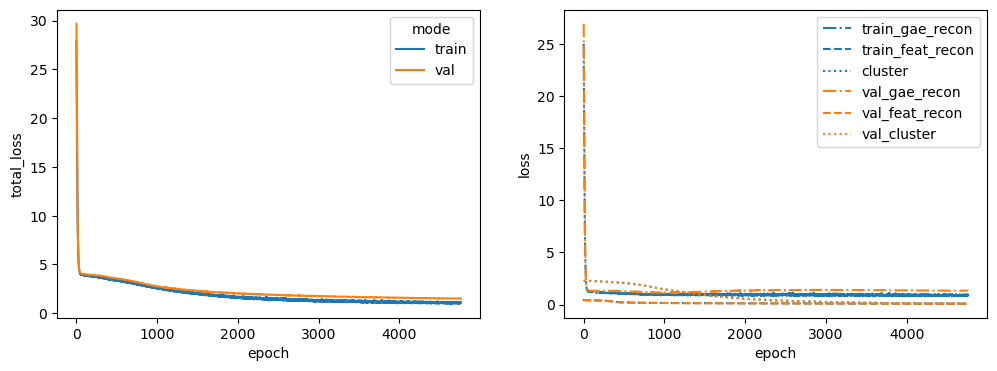

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


E2F1


 28%|██▊       | 2750/10000 [01:05<02:51, 42.23it/s]


Training stopped after 2751 epochs
Best model found at epoch 2649
------------------------------------------------------------
TEST AUC: 0.8377324263038548 AP: 0.8393855205321441
TRAIN loss: 1.3825637102127075
VAL loss: 1.8868775367736816
TEST loss: 1.6150298118591309
TEST AUC: 0.8377324263038548 	 AP: 0.8393855205321441


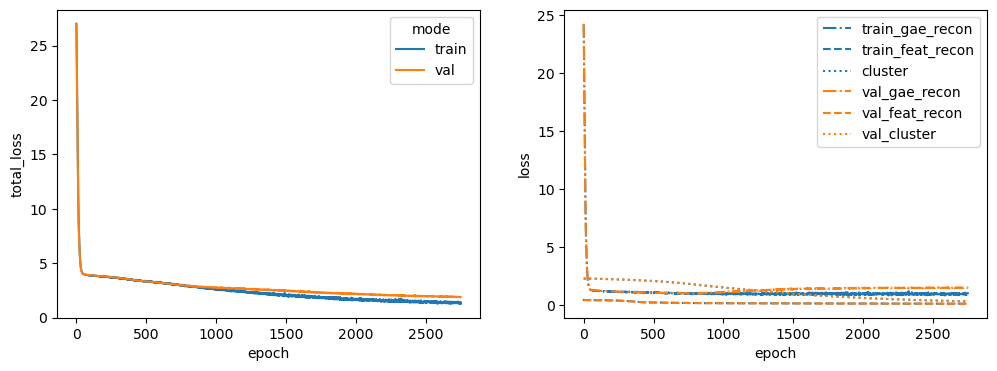

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ELK1


 18%|█▊        | 1831/10000 [00:43<03:11, 42.58it/s]


Training stopped after 1832 epochs
Best model found at epoch 1730
------------------------------------------------------------
TEST AUC: 0.7515646258503401 AP: 0.7396027936686451
TRAIN loss: 1.787016749382019
VAL loss: 2.2891910076141357
TEST loss: 2.38118314743042
TEST AUC: 0.7515646258503401 	 AP: 0.7396027936686451


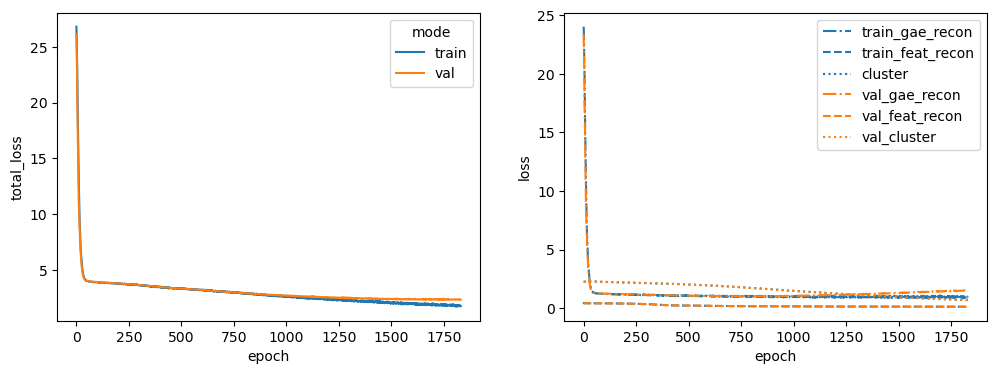

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


EMPTY


 35%|███▌      | 3520/10000 [01:16<02:20, 46.03it/s]


Training stopped after 3521 epochs
Best model found at epoch 3419
------------------------------------------------------------
TEST AUC: 0.7610884353741497 AP: 0.7545258602809054
TRAIN loss: 1.2517470121383667
VAL loss: 1.4229168891906738
TEST loss: 1.7375454902648926
TEST AUC: 0.7610884353741497 	 AP: 0.7545258602809054


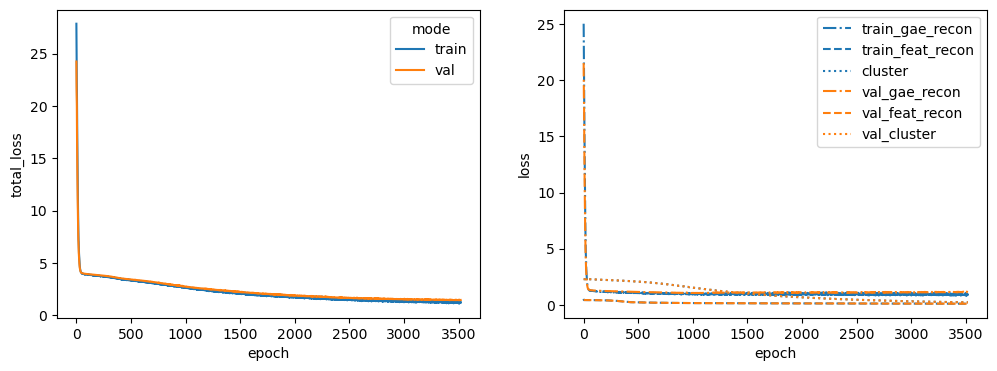

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ERG


 50%|█████     | 5035/10000 [01:47<01:45, 46.85it/s]


Training stopped after 5036 epochs
Best model found at epoch 4934
------------------------------------------------------------
TEST AUC: 0.7980045351473923 AP: 0.8308230474348421
TRAIN loss: 1.0228075981140137
VAL loss: 1.367221474647522
TEST loss: 1.416701316833496
TEST AUC: 0.7980045351473923 	 AP: 0.8308230474348421


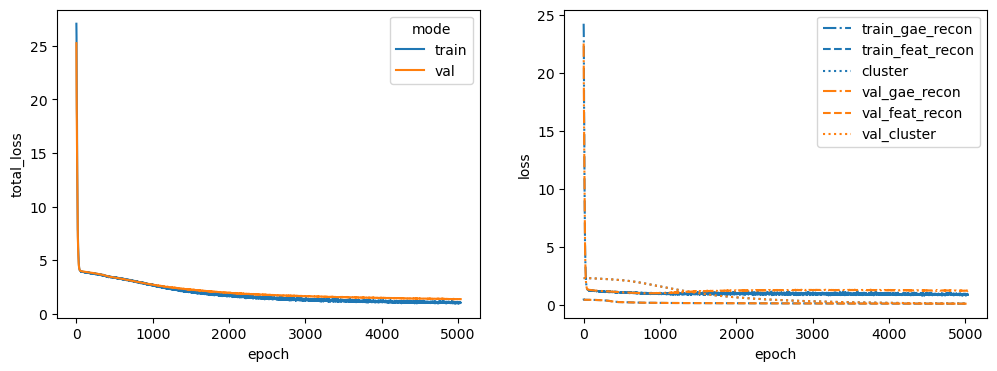

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FGFR3


 61%|██████    | 6119/10000 [02:08<01:21, 47.61it/s]


Training stopped after 6120 epochs
Best model found at epoch 6018
------------------------------------------------------------
TEST AUC: 0.7788662131519274 AP: 0.7409940507931846
TRAIN loss: 1.0086126327514648
VAL loss: 1.344657301902771
TEST loss: 1.5711315870285034
TEST AUC: 0.7788662131519274 	 AP: 0.7409940507931846


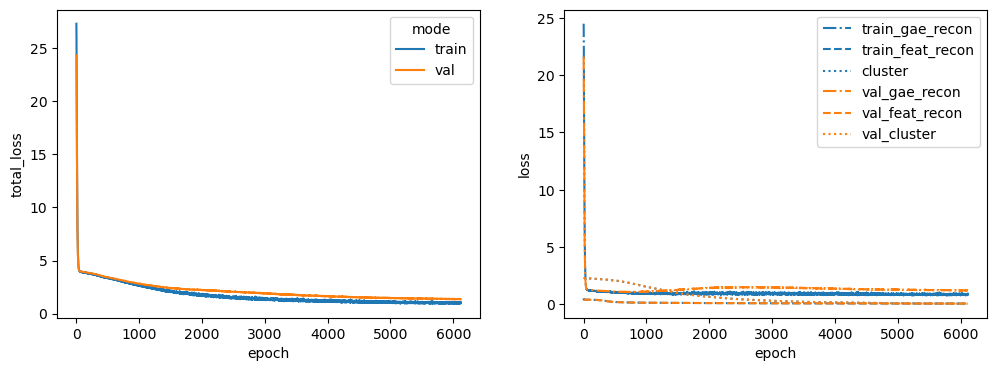

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FOXO1


 48%|████▊     | 4766/10000 [01:40<01:50, 47.53it/s]


Training stopped after 4767 epochs
Best model found at epoch 4665
------------------------------------------------------------
TEST AUC: 0.8199546485260771 AP: 0.831531035740654
TRAIN loss: 0.99235600233078
VAL loss: 1.3822886943817139
TEST loss: 1.4275317192077637
TEST AUC: 0.8199546485260771 	 AP: 0.831531035740654


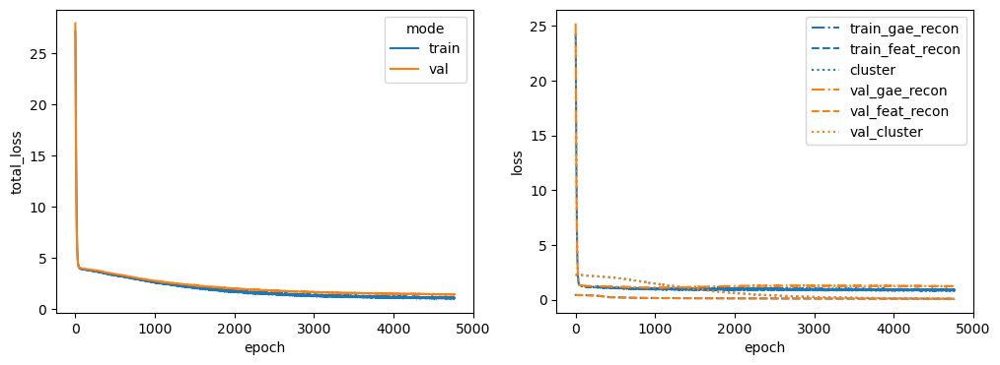

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


GLI1


 44%|████▎     | 4362/10000 [01:32<01:59, 47.31it/s]


Training stopped after 4363 epochs
Best model found at epoch 4261
------------------------------------------------------------
TEST AUC: 0.8168707482993197 AP: 0.8294456689163594
TRAIN loss: 1.0830057859420776
VAL loss: 1.3355021476745605
TEST loss: 1.4606554508209229
TEST AUC: 0.8168707482993197 	 AP: 0.8294456689163594


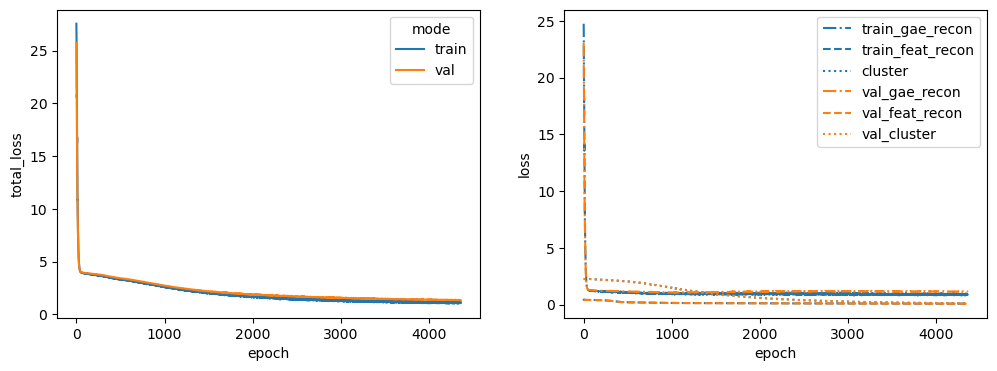

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


HRAS


 52%|█████▏    | 5166/10000 [01:48<01:41, 47.41it/s]


Training stopped after 5167 epochs
Best model found at epoch 5065
------------------------------------------------------------
TEST AUC: 0.7585487528344671 AP: 0.7707775358726381
TRAIN loss: 0.9897318482398987
VAL loss: 1.4288504123687744
TEST loss: 1.5474648475646973
TEST AUC: 0.7585487528344671 	 AP: 0.7707775358726381


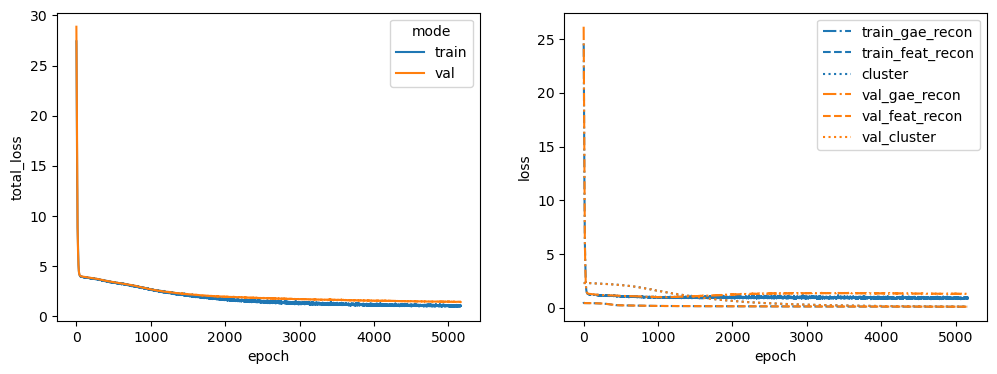

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


IRAK4


 41%|████      | 4052/10000 [01:31<02:14, 44.22it/s]


Training stopped after 4053 epochs
Best model found at epoch 3951
------------------------------------------------------------
TEST AUC: 0.8384580498866214 AP: 0.8500563745452047
TRAIN loss: 1.1579583883285522
VAL loss: 1.4072201251983643
TEST loss: 1.3187280893325806
TEST AUC: 0.8384580498866214 	 AP: 0.8500563745452047


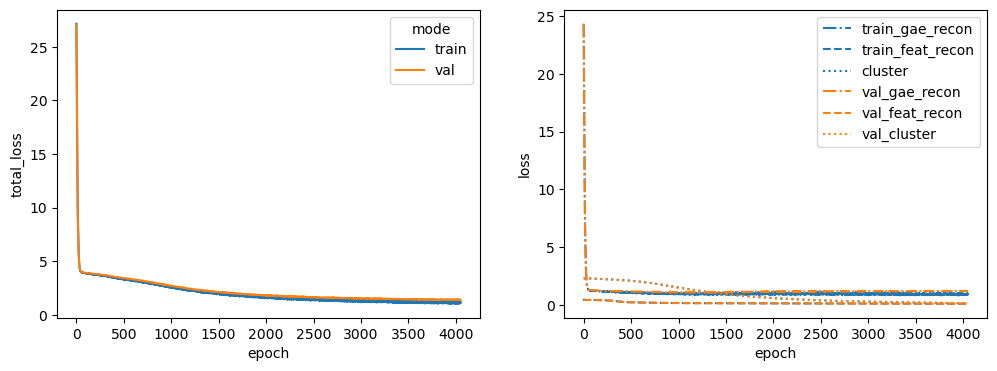

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


JUN


 57%|█████▋    | 5677/10000 [02:00<01:31, 47.31it/s]


Training stopped after 5678 epochs
Best model found at epoch 5576
------------------------------------------------------------
TEST AUC: 0.8237641723356008 AP: 0.871193669826982
TRAIN loss: 1.0333404541015625
VAL loss: 1.1809803247451782
TEST loss: 1.2852158546447754
TEST AUC: 0.8237641723356008 	 AP: 0.871193669826982


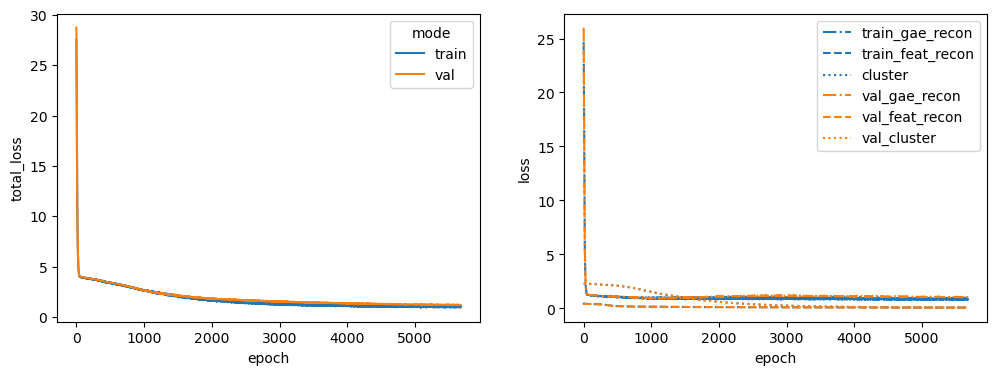

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP2K3


 52%|█████▏    | 5246/10000 [01:51<01:40, 47.10it/s]


Training stopped after 5247 epochs
Best model found at epoch 5145
------------------------------------------------------------
TEST AUC: 0.789750566893424 AP: 0.7889305625211751
TRAIN loss: 1.0835886001586914
VAL loss: 1.5161961317062378
TEST loss: 1.435890555381775
TEST AUC: 0.789750566893424 	 AP: 0.7889305625211751


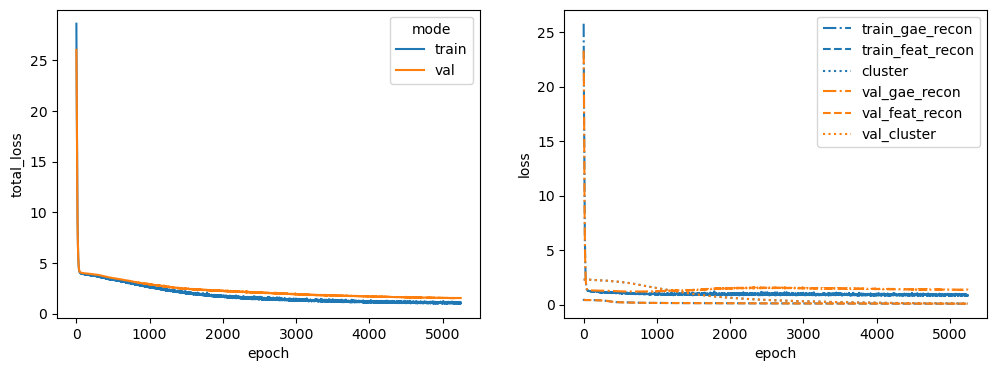

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K2


 45%|████▌     | 4516/10000 [01:34<01:55, 47.56it/s]


Training stopped after 4517 epochs
Best model found at epoch 4415
------------------------------------------------------------
TEST AUC: 0.8139682539682539 AP: 0.8128573943356228
TRAIN loss: 1.1046016216278076
VAL loss: 1.2803305387496948
TEST loss: 1.4521344900131226
TEST AUC: 0.8139682539682539 	 AP: 0.8128573943356228


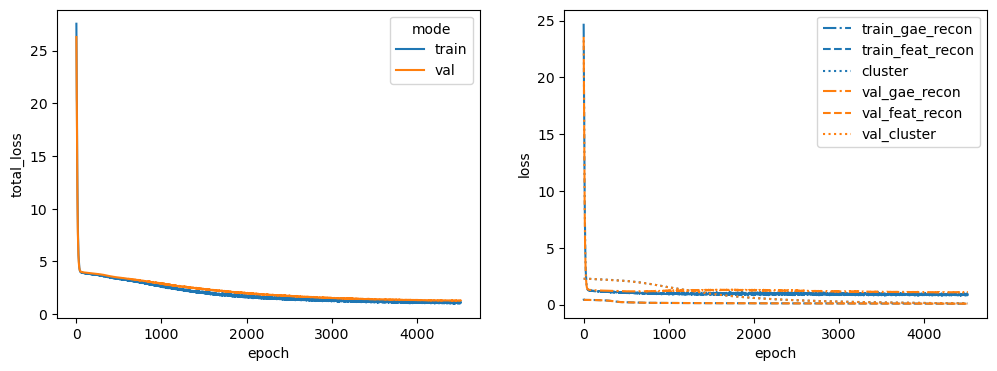

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K5


 46%|████▌     | 4596/10000 [01:37<01:54, 47.27it/s]


Training stopped after 4597 epochs
Best model found at epoch 4495
------------------------------------------------------------
TEST AUC: 0.8213151927437642 AP: 0.8493497527012834
TRAIN loss: 1.1073718070983887
VAL loss: 1.3073636293411255
TEST loss: 1.4223638772964478
TEST AUC: 0.8213151927437642 	 AP: 0.8493497527012834


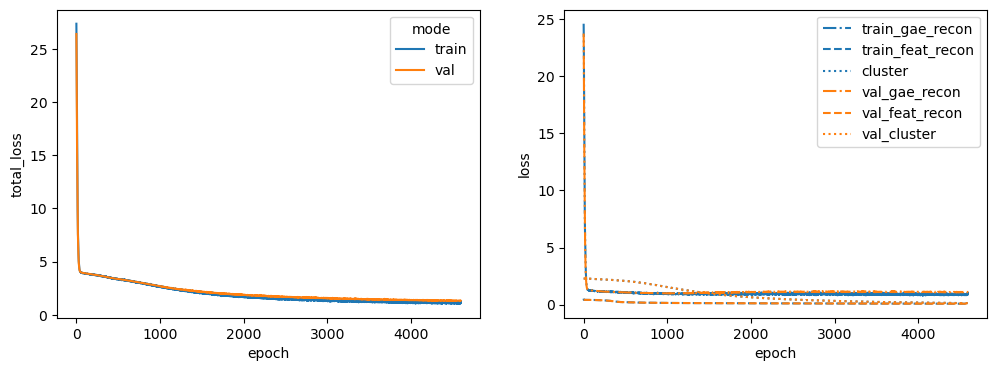

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K9


 43%|████▎     | 4315/10000 [01:35<02:05, 45.33it/s]


Training stopped after 4316 epochs
Best model found at epoch 4214
------------------------------------------------------------
TEST AUC: 0.8134240362811791 AP: 0.8224122193509061
TRAIN loss: 1.1376657485961914
VAL loss: 1.328000545501709
TEST loss: 1.4349689483642578
TEST AUC: 0.8134240362811791 	 AP: 0.8224122193509061


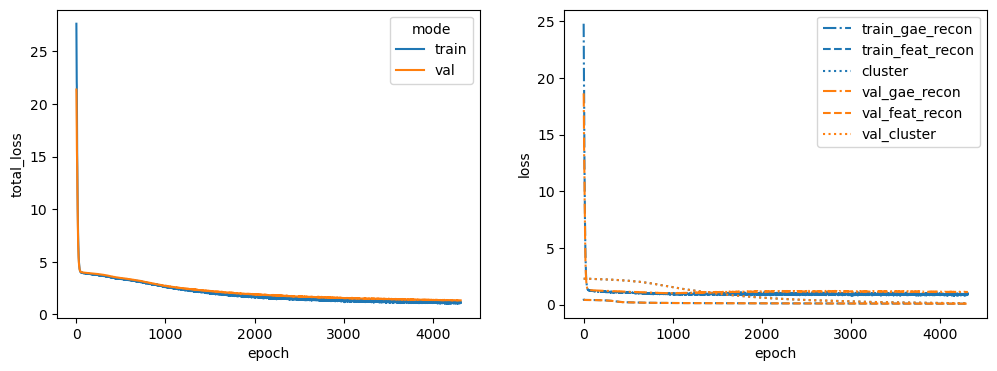

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAPK7


 44%|████▍     | 4432/10000 [01:33<01:57, 47.32it/s]


Training stopped after 4433 epochs
Best model found at epoch 4331
------------------------------------------------------------
TEST AUC: 0.7780498866213151 AP: 0.769865650283537
TRAIN loss: 1.1282689571380615
VAL loss: 1.402583122253418
TEST loss: 1.5429562330245972
TEST AUC: 0.7780498866213151 	 AP: 0.769865650283537


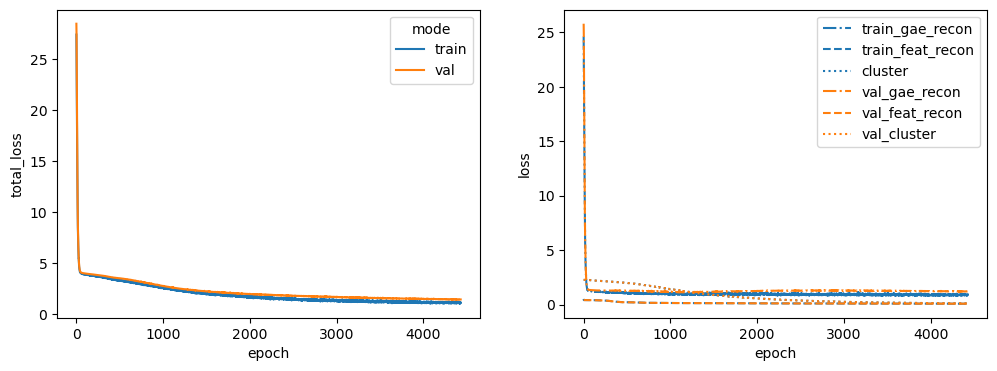

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MOS


 41%|████      | 4071/10000 [01:26<02:06, 46.96it/s]


Training stopped after 4072 epochs
Best model found at epoch 3970
------------------------------------------------------------
TEST AUC: 0.817687074829932 AP: 0.853639338478899
TRAIN loss: 1.141449213027954
VAL loss: 1.433296799659729
TEST loss: 1.4279569387435913
TEST AUC: 0.817687074829932 	 AP: 0.853639338478899


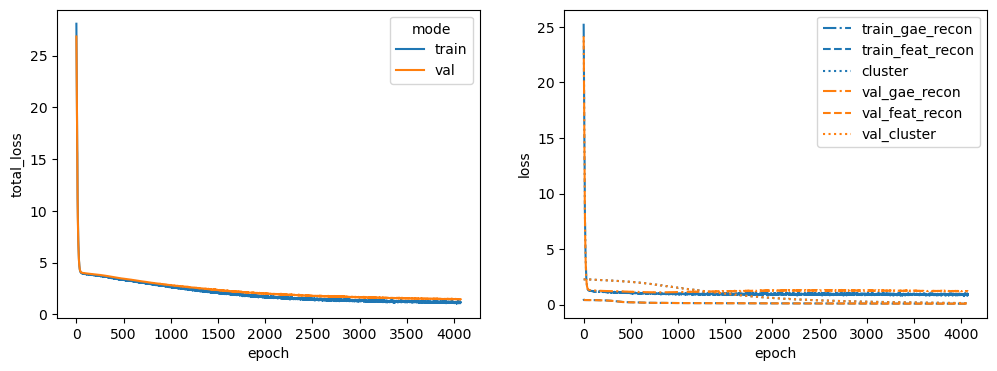

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MYD88


 31%|███       | 3095/10000 [01:06<02:29, 46.31it/s]


Training stopped after 3096 epochs
Best model found at epoch 2994
------------------------------------------------------------
TEST AUC: 0.7569160997732426 AP: 0.7361551055734881
TRAIN loss: 1.414614200592041
VAL loss: 1.757529377937317
TEST loss: 1.795129418373108
TEST AUC: 0.7569160997732426 	 AP: 0.7361551055734881


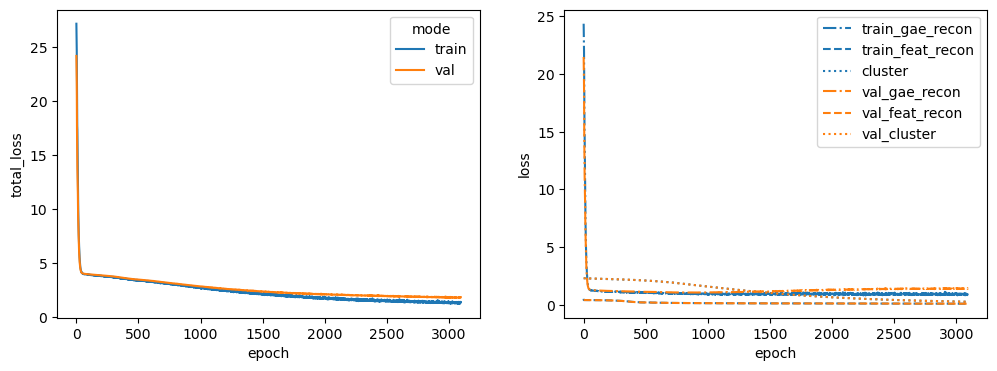

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PIK3R2


 42%|████▏     | 4159/10000 [01:28<02:03, 47.19it/s]


Training stopped after 4160 epochs
Best model found at epoch 4058
------------------------------------------------------------
TEST AUC: 0.7794104308390022 AP: 0.7659562491924605
TRAIN loss: 1.150495171546936
VAL loss: 1.63076651096344
TEST loss: 1.6150305271148682
TEST AUC: 0.7794104308390022 	 AP: 0.7659562491924605


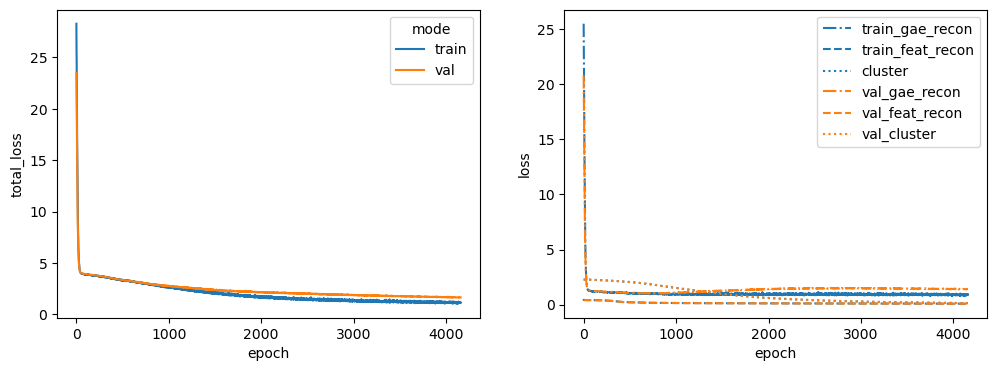

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKACA


 45%|████▍     | 4457/10000 [01:34<01:57, 47.19it/s]


Training stopped after 4458 epochs
Best model found at epoch 4356
------------------------------------------------------------
TEST AUC: 0.8008163265306122 AP: 0.8229084521659696
TRAIN loss: 1.111504316329956
VAL loss: 1.3318678140640259
TEST loss: 1.4613415002822876
TEST AUC: 0.8008163265306122 	 AP: 0.8229084521659696


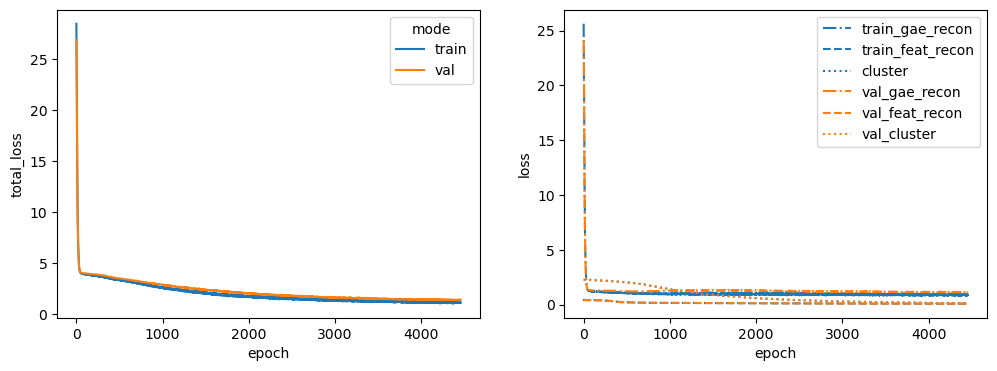

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKCE


 46%|████▋     | 4638/10000 [01:38<01:53, 47.27it/s]


Training stopped after 4639 epochs
Best model found at epoch 4537
------------------------------------------------------------
TEST AUC: 0.8271201814058957 AP: 0.8637280850013107
TRAIN loss: 1.0571492910385132
VAL loss: 1.3789610862731934
TEST loss: 1.382224202156067
TEST AUC: 0.8271201814058957 	 AP: 0.8637280850013107


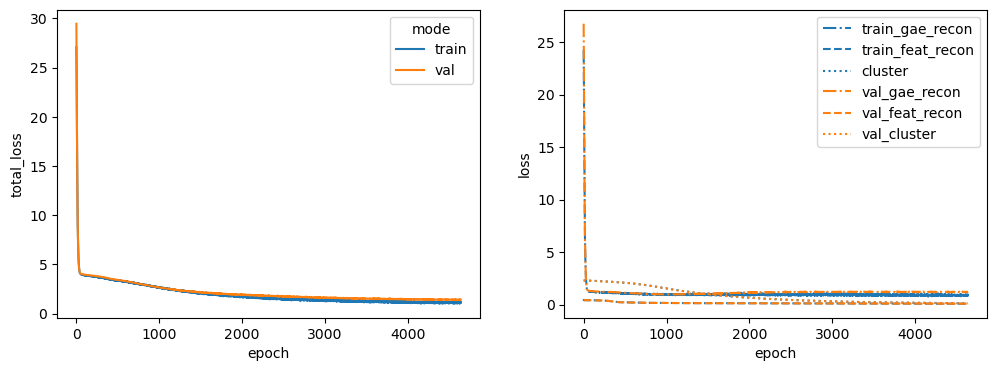

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RAF1


 36%|███▋      | 3649/10000 [01:17<02:14, 47.08it/s]


Training stopped after 3650 epochs
Best model found at epoch 3548
------------------------------------------------------------
TEST AUC: 0.7938321995464852 AP: 0.7849089657396509
TRAIN loss: 1.2198704481124878
VAL loss: 1.6020832061767578
TEST loss: 1.8947643041610718
TEST AUC: 0.7938321995464852 	 AP: 0.7849089657396509


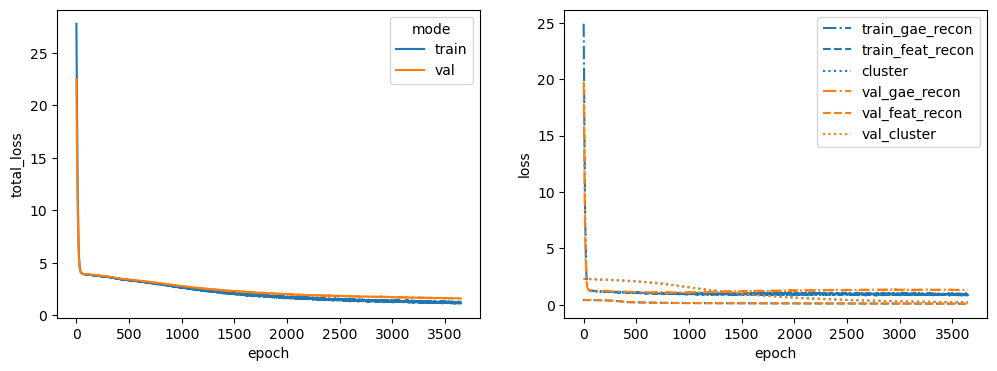

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RELB


 32%|███▏      | 3186/10000 [01:08<02:25, 46.83it/s]


Training stopped after 3187 epochs
Best model found at epoch 3085
------------------------------------------------------------
TEST AUC: 0.7556462585034014 AP: 0.7709994935150485
TRAIN loss: 1.3596404790878296
VAL loss: 1.615889549255371
TEST loss: 1.825218915939331
TEST AUC: 0.7556462585034014 	 AP: 0.7709994935150485


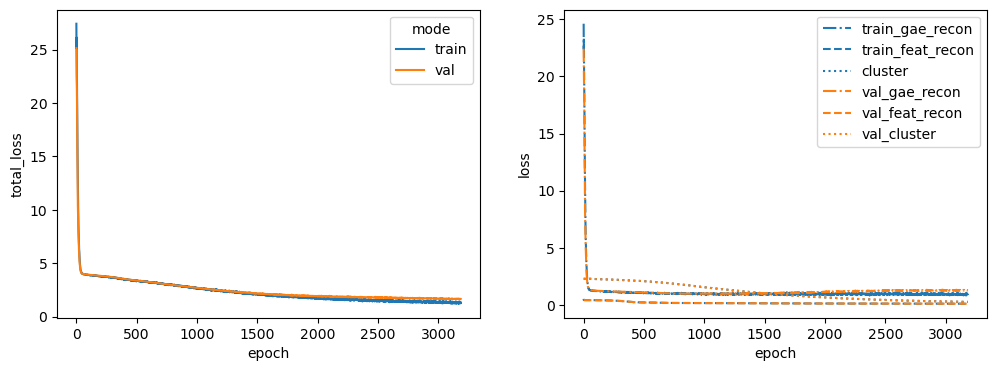

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RHOA


 45%|████▌     | 4518/10000 [01:35<01:55, 47.49it/s]


Training stopped after 4519 epochs
Best model found at epoch 4417
------------------------------------------------------------
TEST AUC: 0.8229478458049886 AP: 0.8531366106569447
TRAIN loss: 1.0313993692398071
VAL loss: 1.4188530445098877
TEST loss: 1.360914945602417
TEST AUC: 0.8229478458049886 	 AP: 0.8531366106569447


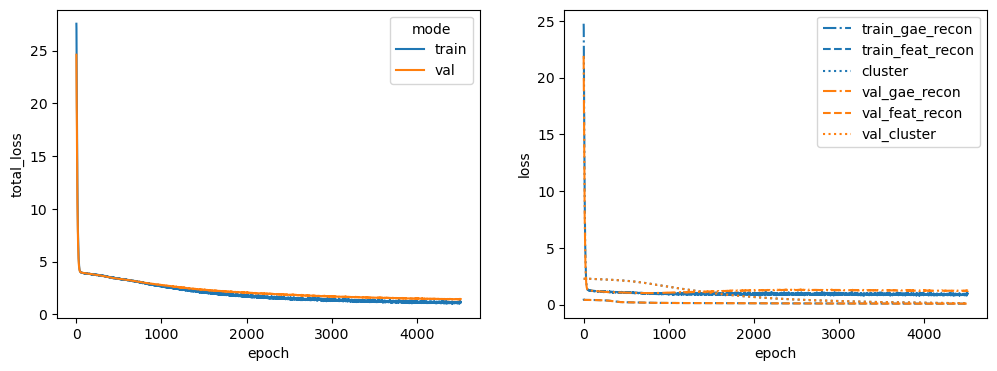

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMAD4


 54%|█████▍    | 5443/10000 [01:54<01:36, 47.43it/s]


Training stopped after 5444 epochs
Best model found at epoch 5342
------------------------------------------------------------
TEST AUC: 0.8121541950113378 AP: 0.8250575930132973
TRAIN loss: 0.992036759853363
VAL loss: 1.537651538848877
TEST loss: 1.3613860607147217
TEST AUC: 0.8121541950113378 	 AP: 0.8250575930132973


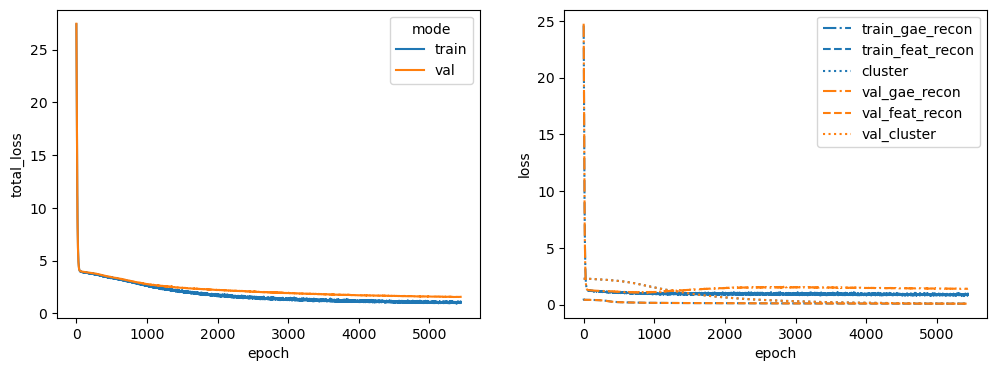

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMO


 45%|████▍     | 4478/10000 [01:32<01:54, 48.25it/s]


Training stopped after 4479 epochs
Best model found at epoch 4377
------------------------------------------------------------
TEST AUC: 0.8366439909297052 AP: 0.8267553022084954
TRAIN loss: 1.050038456916809
VAL loss: 1.54920494556427
TEST loss: 1.3824684619903564
TEST AUC: 0.8366439909297052 	 AP: 0.8267553022084954


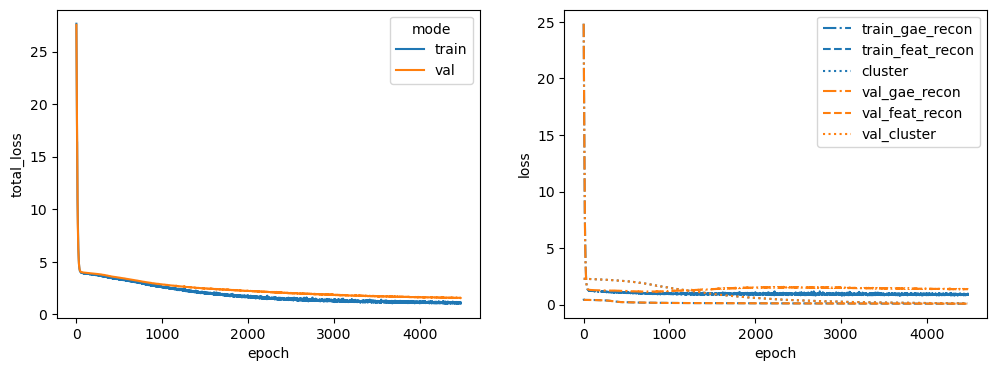

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SRC


 39%|███▉      | 3888/10000 [01:22<02:09, 47.06it/s]


Training stopped after 3889 epochs
Best model found at epoch 3787
------------------------------------------------------------
TEST AUC: 0.7756916099773242 AP: 0.7704639495516628
TRAIN loss: 1.216599464416504
VAL loss: 1.4253097772598267
TEST loss: 1.6216880083084106
TEST AUC: 0.7756916099773242 	 AP: 0.7704639495516628


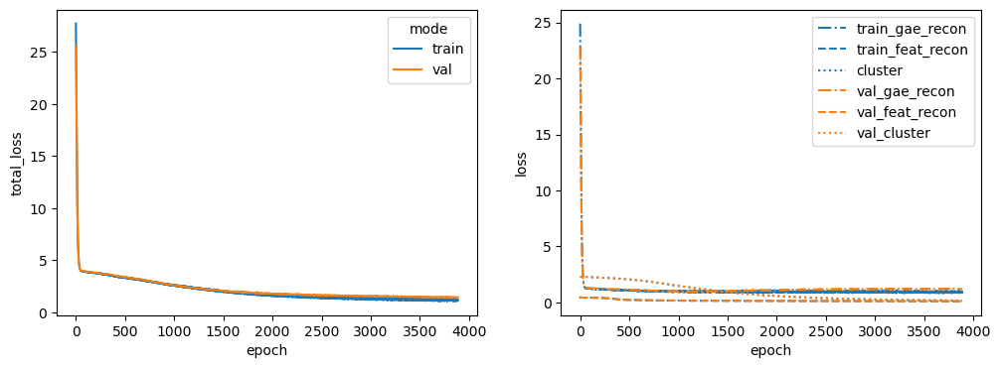

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SREBF1


 36%|███▋      | 3646/10000 [01:17<02:15, 46.84it/s]


Training stopped after 3647 epochs
Best model found at epoch 3545
------------------------------------------------------------
TEST AUC: 0.7954648526077097 AP: 0.7967761383812842
TRAIN loss: 1.1531752347946167
VAL loss: 1.3703458309173584
TEST loss: 1.6057484149932861
TEST AUC: 0.7954648526077097 	 AP: 0.7967761383812842


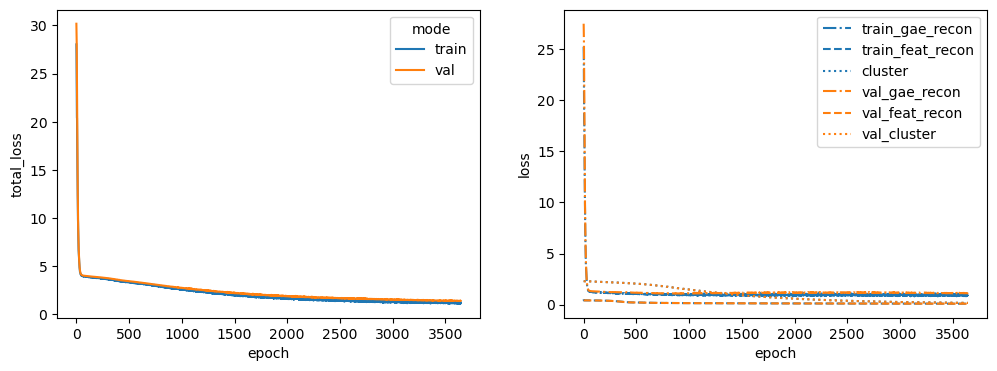

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TRAF2


 55%|█████▌    | 5509/10000 [01:56<01:34, 47.32it/s]


Training stopped after 5510 epochs
Best model found at epoch 5408
------------------------------------------------------------
TEST AUC: 0.781859410430839 AP: 0.7989735421635011
TRAIN loss: 1.03548264503479
VAL loss: 1.4516974687576294
TEST loss: 1.4851183891296387
TEST AUC: 0.781859410430839 	 AP: 0.7989735421635011


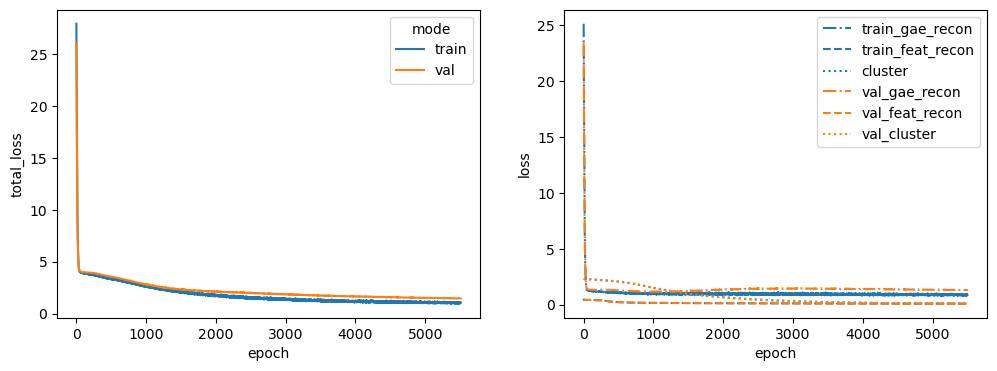

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TSC2


 32%|███▏      | 3155/10000 [01:06<02:24, 47.42it/s]


Training stopped after 3156 epochs
Best model found at epoch 3054
------------------------------------------------------------
TEST AUC: 0.7838548752834467 AP: 0.7665186813582578
TRAIN loss: 1.267547607421875
VAL loss: 1.7554177045822144
TEST loss: 1.7910269498825073
TEST AUC: 0.7838548752834467 	 AP: 0.7665186813582578


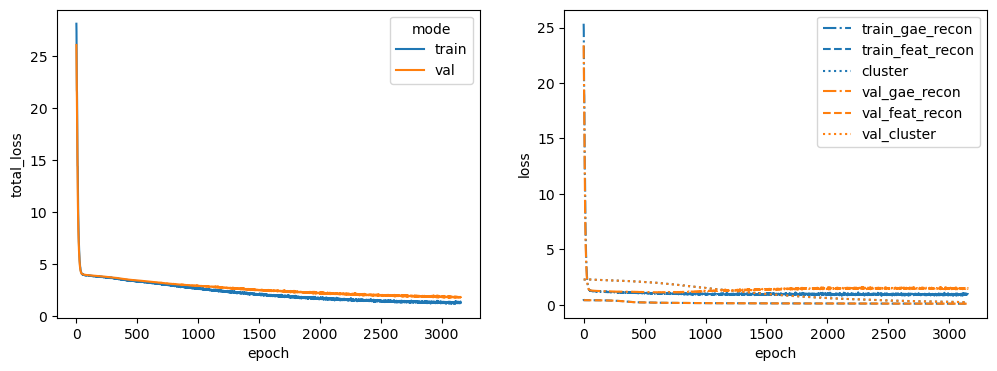

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


WWTR1


 41%|████      | 4122/10000 [01:27<02:04, 47.08it/s]


Training stopped after 4123 epochs
Best model found at epoch 4021
------------------------------------------------------------
TEST AUC: 0.7921088435374151 AP: 0.8229565037312343
TRAIN loss: 1.1914396286010742
VAL loss: 1.32810378074646
TEST loss: 1.5109119415283203
TEST AUC: 0.7921088435374151 	 AP: 0.8229565037312343


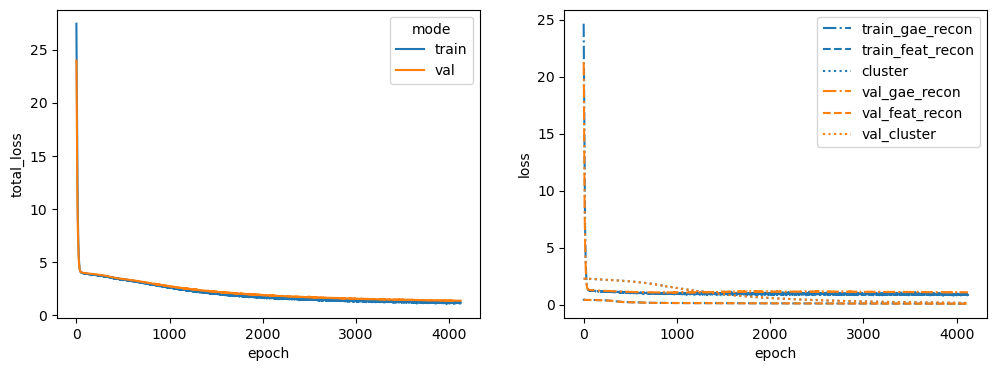

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


dict_keys(['AKT1S1', 'ATF4', 'BAX', 'BCL2L11', 'BRAF', 'CASP8', 'CDC42', 'CDKN1A', 'CEBPA', 'CREB1', 'CXXC4', 'DIABLO', 'E2F1', 'ELK1', 'EMPTY', 'ERG', 'FGFR3', 'FOXO1', 'GLI1', 'HRAS', 'IRAK4', 'JUN', 'MAP2K3', 'MAP3K2', 'MAP3K5', 'MAP3K9', 'MAPK7', 'MOS', 'MYD88', 'PIK3R2', 'PRKACA', 'PRKCE', 'RAF1', 'RELB', 'RHOA', 'SMAD4', 'SMO', 'SRC', 'SREBF1', 'TRAF2', 'TSC2', 'WWTR1'])
AKT1S1


 22%|██▏       | 2229/10000 [00:47<02:46, 46.61it/s]


Training stopped after 2230 epochs
Best model found at epoch 2128
------------------------------------------------------------
TEST AUC: 0.801360544217687 AP: 0.7955439369733464
TRAIN loss: 1.5957393646240234
VAL loss: 1.9001903533935547
TEST loss: 2.0144667625427246
TEST AUC: 0.801360544217687 	 AP: 0.7955439369733464


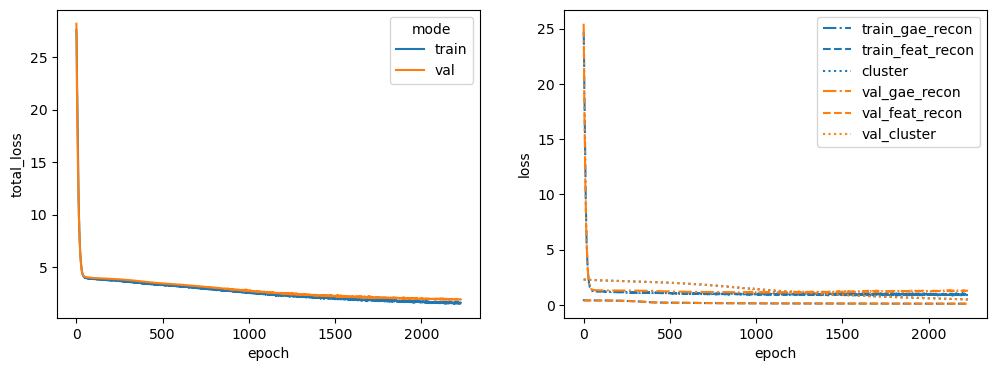

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ATF4


 50%|█████     | 5045/10000 [01:47<01:45, 47.03it/s]


Training stopped after 5046 epochs
Best model found at epoch 4944
------------------------------------------------------------
TEST AUC: 0.809795918367347 AP: 0.8382105432036544
TRAIN loss: 1.0519880056381226
VAL loss: 1.3403289318084717
TEST loss: 1.3781516551971436
TEST AUC: 0.809795918367347 	 AP: 0.8382105432036544


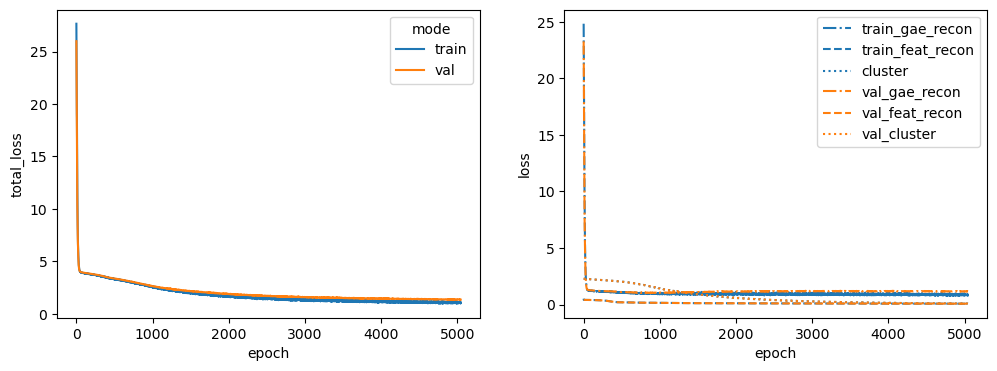

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BAX


 55%|█████▌    | 5538/10000 [01:58<01:35, 46.66it/s]


Training stopped after 5539 epochs
Best model found at epoch 5437
------------------------------------------------------------
TEST AUC: 0.7991836734693878 AP: 0.7994569993653384
TRAIN loss: 1.0048668384552002
VAL loss: 1.4851967096328735
TEST loss: 1.4454677104949951
TEST AUC: 0.7991836734693878 	 AP: 0.7994569993653384


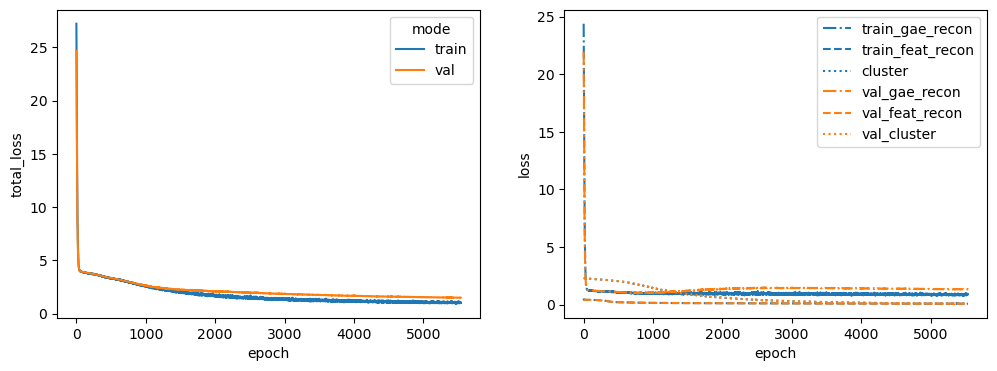

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BCL2L11


 38%|███▊      | 3836/10000 [01:22<02:12, 46.62it/s]


Training stopped after 3837 epochs
Best model found at epoch 3735
------------------------------------------------------------
TEST AUC: 0.8000907029478458 AP: 0.7859195751313504
TRAIN loss: 1.2095409631729126
VAL loss: 1.5023815631866455
TEST loss: 1.598923921585083
TEST AUC: 0.8000907029478458 	 AP: 0.7859195751313504


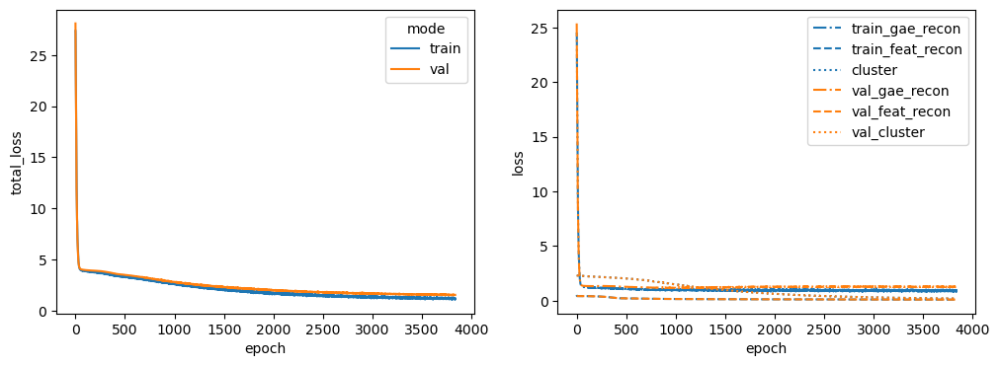

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BRAF


 35%|███▌      | 3529/10000 [01:14<02:16, 47.28it/s]


Training stopped after 3530 epochs
Best model found at epoch 3428
------------------------------------------------------------
TEST AUC: 0.8406349206349206 AP: 0.8581542088404533
TRAIN loss: 1.2879749536514282
VAL loss: 1.6866151094436646
TEST loss: 1.4551136493682861
TEST AUC: 0.8406349206349206 	 AP: 0.8581542088404533


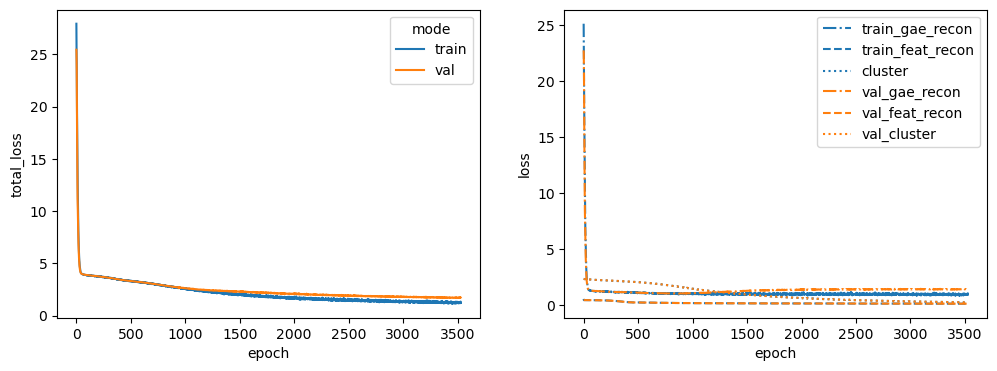

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CASP8


 48%|████▊     | 4848/10000 [01:42<01:49, 47.20it/s]


Training stopped after 4849 epochs
Best model found at epoch 4747
------------------------------------------------------------
TEST AUC: 0.8448979591836734 AP: 0.8488490620112329
TRAIN loss: 1.1267443895339966
VAL loss: 1.325224757194519
TEST loss: 1.35560142993927
TEST AUC: 0.8448979591836734 	 AP: 0.8488490620112329


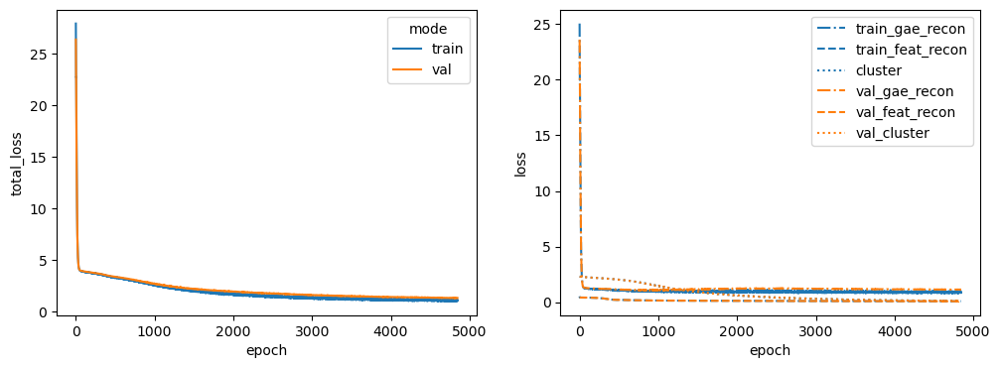

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDC42


 49%|████▉     | 4897/10000 [01:43<01:48, 47.24it/s]


Training stopped after 4898 epochs
Best model found at epoch 4796
------------------------------------------------------------
TEST AUC: 0.8443537414965986 AP: 0.8727269776969133
TRAIN loss: 1.0811121463775635
VAL loss: 1.509925365447998
TEST loss: 1.312646746635437
TEST AUC: 0.8443537414965986 	 AP: 0.8727269776969133


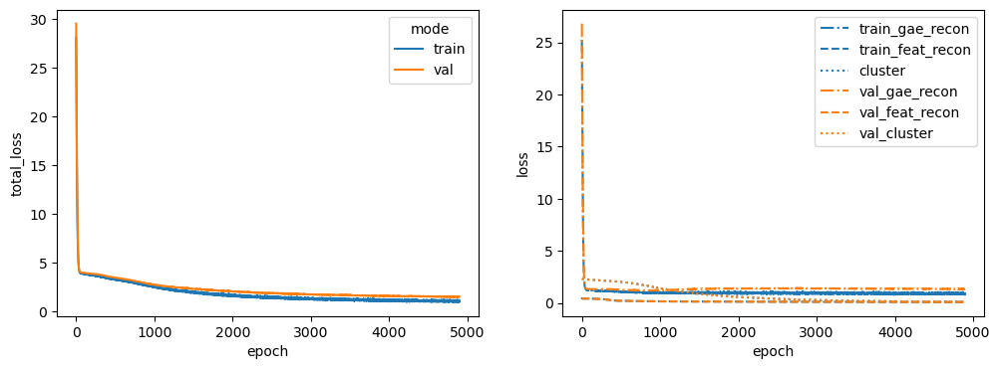

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDKN1A


 42%|████▏     | 4182/10000 [01:28<02:03, 47.26it/s]


Training stopped after 4183 epochs
Best model found at epoch 4081
------------------------------------------------------------
TEST AUC: 0.8263038548752834 AP: 0.8380839892051204
TRAIN loss: 1.1494706869125366
VAL loss: 1.6792782545089722
TEST loss: 1.4496612548828125
TEST AUC: 0.8263038548752834 	 AP: 0.8380839892051204


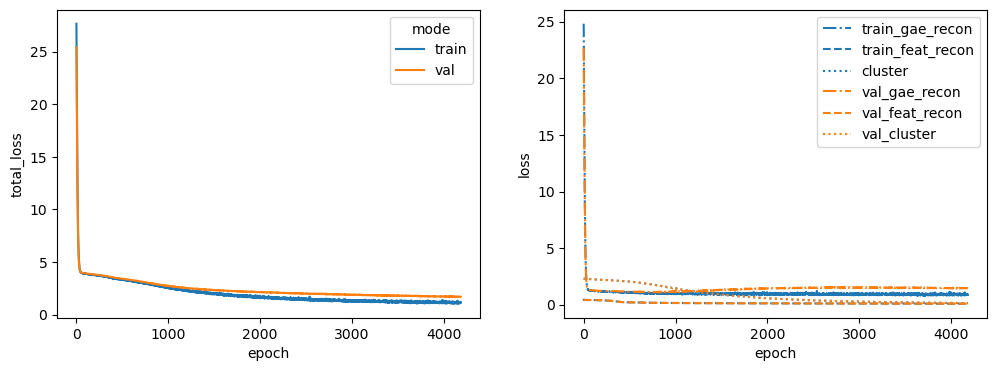

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CEBPA


 46%|████▌     | 4557/10000 [01:37<01:56, 46.83it/s]


Training stopped after 4558 epochs
Best model found at epoch 4456
------------------------------------------------------------
TEST AUC: 0.8079818594104309 AP: 0.8169075644717005
TRAIN loss: 1.2461001873016357
VAL loss: 1.4183648824691772
TEST loss: 1.4576798677444458
TEST AUC: 0.8079818594104309 	 AP: 0.8169075644717005


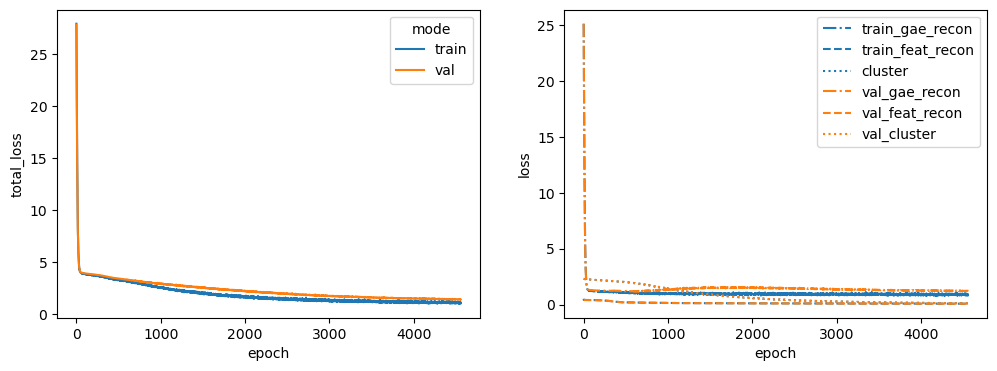

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CREB1


 31%|███       | 3124/10000 [01:07<02:28, 46.44it/s]


Training stopped after 3125 epochs
Best model found at epoch 3023
------------------------------------------------------------
TEST AUC: 0.8049886621315193 AP: 0.8002391958449875
TRAIN loss: 1.3280470371246338
VAL loss: 2.048539161682129
TEST loss: 1.7159390449523926
TEST AUC: 0.8049886621315193 	 AP: 0.8002391958449875


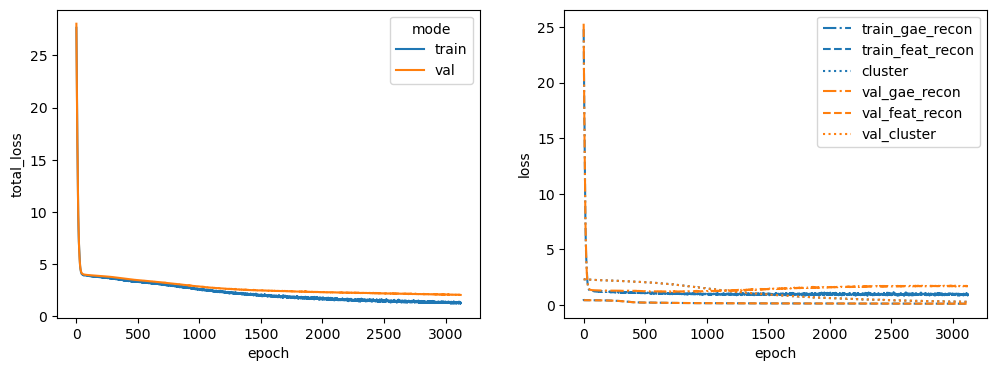

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CXXC4


 51%|█████     | 5094/10000 [01:47<01:43, 47.21it/s]


Training stopped after 5095 epochs
Best model found at epoch 4993
------------------------------------------------------------
TEST AUC: 0.8271201814058957 AP: 0.8252033523824657
TRAIN loss: 1.028388261795044
VAL loss: 1.3051191568374634
TEST loss: 1.3895552158355713
TEST AUC: 0.8271201814058957 	 AP: 0.8252033523824657


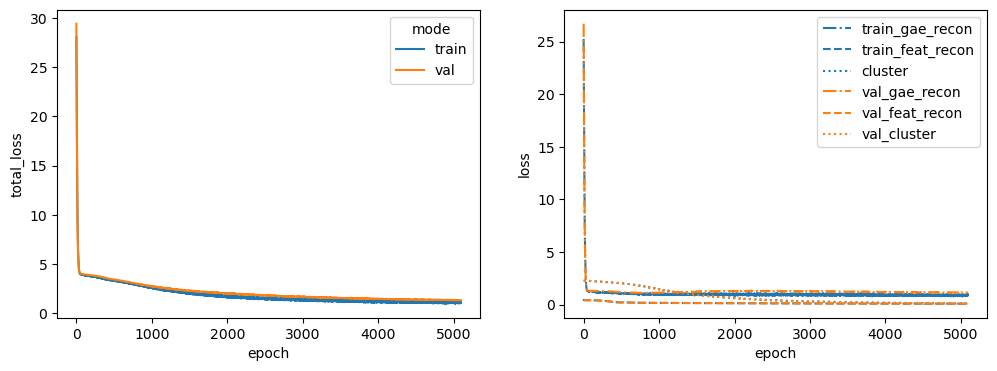

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


DIABLO


 36%|███▌      | 3612/10000 [01:17<02:16, 46.72it/s]


Training stopped after 3613 epochs
Best model found at epoch 3511
------------------------------------------------------------
TEST AUC: 0.8333786848072562 AP: 0.8466827120410395
TRAIN loss: 1.2568849325180054
VAL loss: 1.3962186574935913
TEST loss: 1.4786334037780762
TEST AUC: 0.8333786848072562 	 AP: 0.8466827120410395


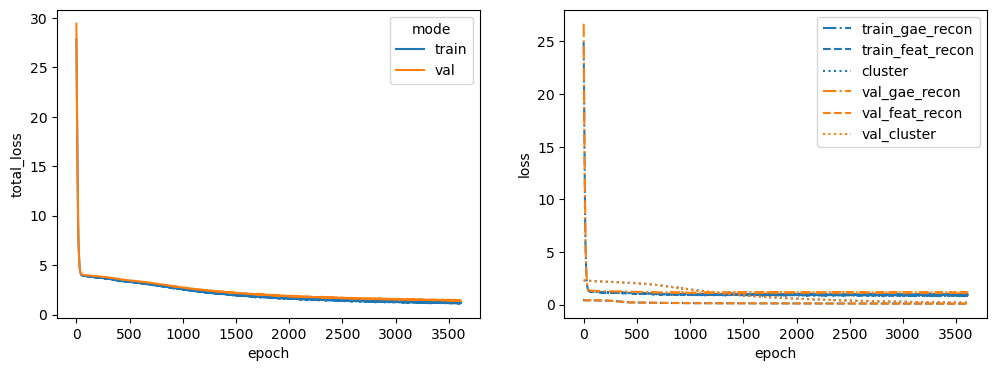

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


E2F1


 36%|███▋      | 3628/10000 [01:17<02:15, 46.96it/s]


Training stopped after 3629 epochs
Best model found at epoch 3527
------------------------------------------------------------
TEST AUC: 0.8014512471655328 AP: 0.8022819788734346
TRAIN loss: 1.1877580881118774
VAL loss: 1.58962881565094
TEST loss: 1.5954957008361816
TEST AUC: 0.8014512471655328 	 AP: 0.8022819788734346


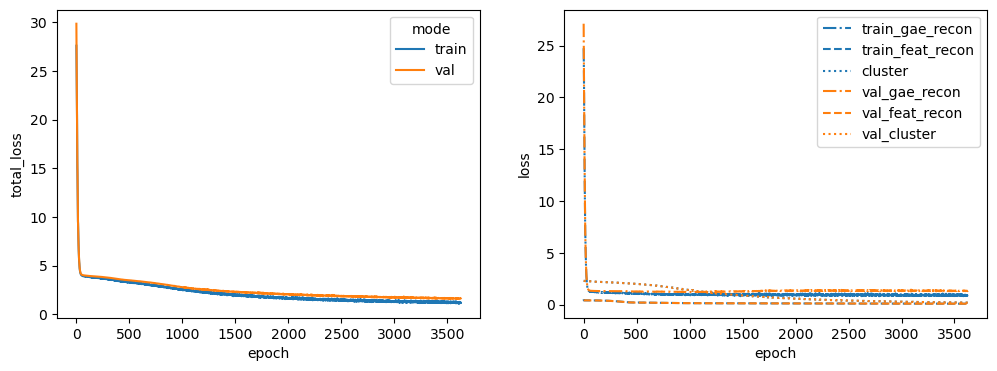

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ELK1


 35%|███▍      | 3457/10000 [01:14<02:20, 46.61it/s]


Training stopped after 3458 epochs
Best model found at epoch 3356
------------------------------------------------------------
TEST AUC: 0.829297052154195 AP: 0.8440941326565832
TRAIN loss: 1.2610148191452026
VAL loss: 1.8698930740356445
TEST loss: 1.5263373851776123
TEST AUC: 0.829297052154195 	 AP: 0.8440941326565832


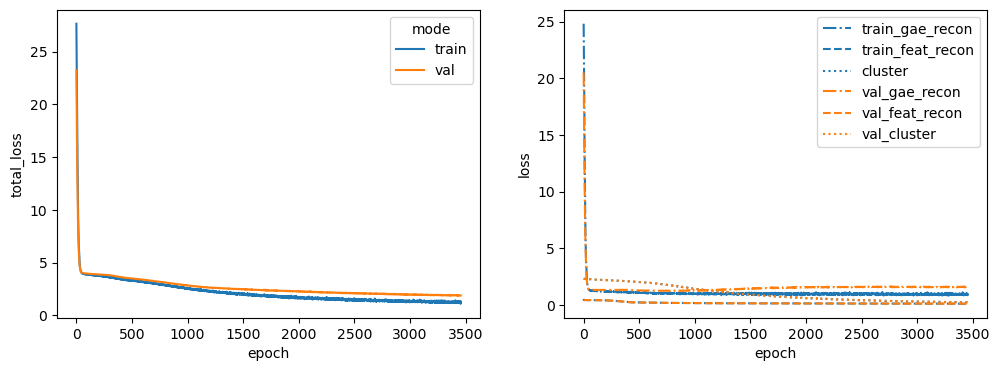

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


EMPTY


 59%|█████▊    | 5873/10000 [02:04<01:27, 47.22it/s]


Training stopped after 5874 epochs
Best model found at epoch 5772
------------------------------------------------------------
TEST AUC: 0.8154195011337868 AP: 0.8496931031940524
TRAIN loss: 1.0123704671859741
VAL loss: 1.35378897190094
TEST loss: 1.337181806564331
TEST AUC: 0.8154195011337868 	 AP: 0.8496931031940524


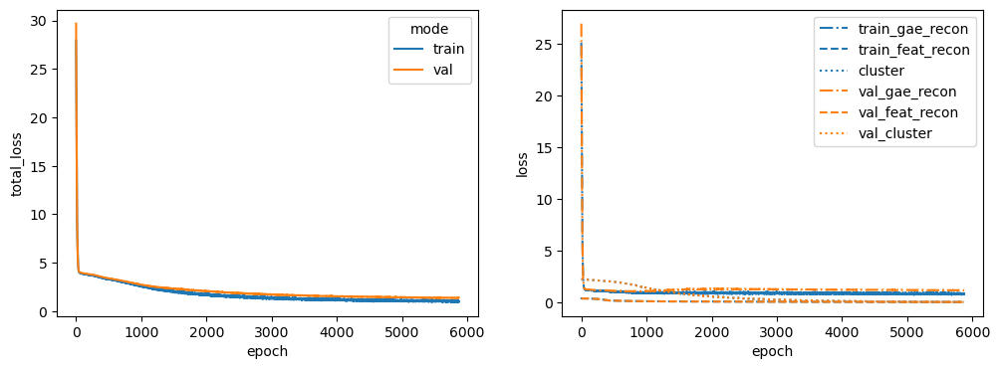

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ERG


 47%|████▋     | 4664/10000 [01:41<01:55, 46.04it/s]


Training stopped after 4665 epochs
Best model found at epoch 4563
------------------------------------------------------------
TEST AUC: 0.812063492063492 AP: 0.8103597763739012
TRAIN loss: 1.0614982843399048
VAL loss: 1.4181911945343018
TEST loss: 1.5048868656158447
TEST AUC: 0.812063492063492 	 AP: 0.8103597763739012


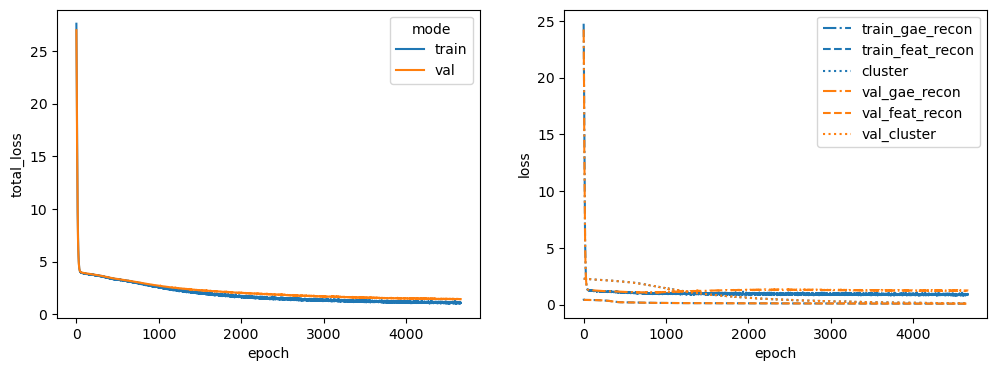

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FGFR3


 35%|███▌      | 3534/10000 [01:16<02:19, 46.48it/s]


Training stopped after 3535 epochs
Best model found at epoch 3433
------------------------------------------------------------
TEST AUC: 0.8416326530612245 AP: 0.8599363295444766
TRAIN loss: 1.2333658933639526
VAL loss: 1.4055466651916504
TEST loss: 1.4711958169937134
TEST AUC: 0.8416326530612245 	 AP: 0.8599363295444766


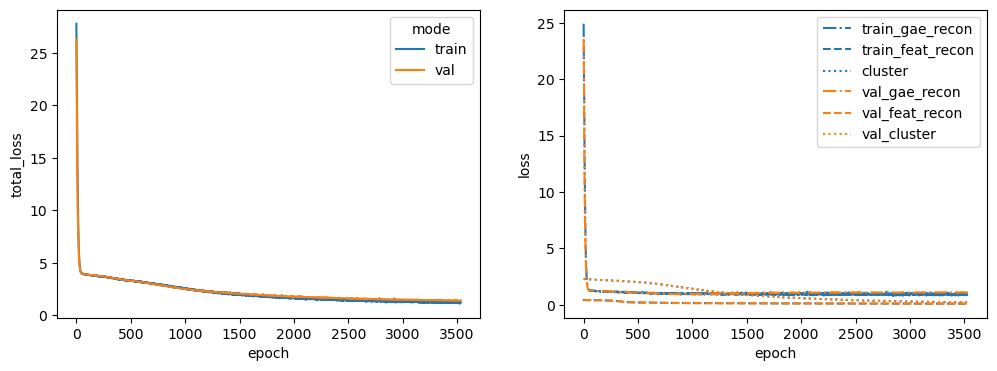

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FOXO1


 45%|████▌     | 4505/10000 [01:35<01:56, 46.99it/s]


Training stopped after 4506 epochs
Best model found at epoch 4404
------------------------------------------------------------
TEST AUC: 0.8053514739229025 AP: 0.8093184920635577
TRAIN loss: 1.1137601137161255
VAL loss: 1.3707301616668701
TEST loss: 1.7803678512573242
TEST AUC: 0.8053514739229025 	 AP: 0.8093184920635577


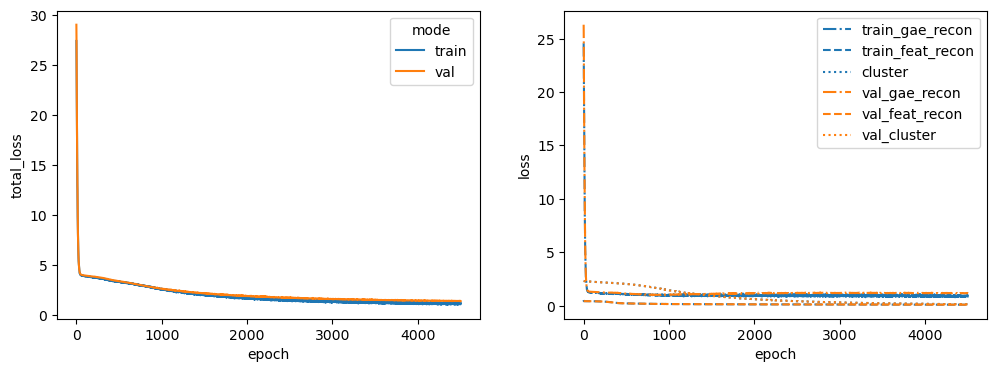

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


GLI1


 34%|███▍      | 3430/10000 [01:13<02:20, 46.62it/s]


Training stopped after 3431 epochs
Best model found at epoch 3329
------------------------------------------------------------
TEST AUC: 0.799546485260771 AP: 0.8330950969633456
TRAIN loss: 1.2133653163909912
VAL loss: 1.4042010307312012
TEST loss: 1.5983279943466187
TEST AUC: 0.799546485260771 	 AP: 0.8330950969633456


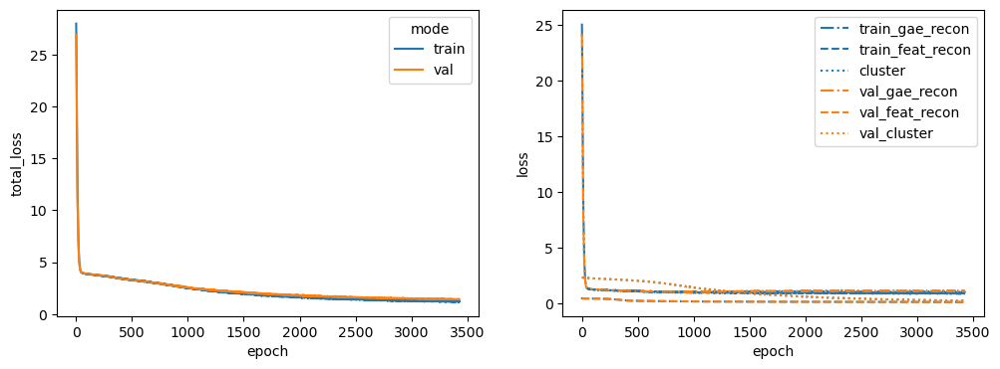

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


HRAS


 60%|█████▉    | 5994/10000 [02:07<01:25, 46.87it/s]


Training stopped after 5995 epochs
Best model found at epoch 5893
------------------------------------------------------------
TEST AUC: 0.7924716553287983 AP: 0.7897464285067625
TRAIN loss: 1.0372282266616821
VAL loss: 1.4130277633666992
TEST loss: 1.4829264879226685
TEST AUC: 0.7924716553287983 	 AP: 0.7897464285067625


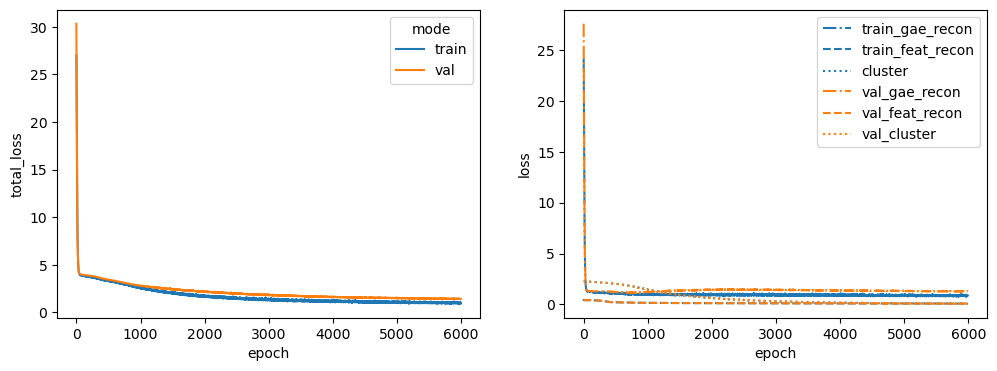

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


IRAK4


 43%|████▎     | 4340/10000 [01:33<02:02, 46.32it/s]


Training stopped after 4341 epochs
Best model found at epoch 4239
------------------------------------------------------------
TEST AUC: 0.8071655328798186 AP: 0.82882051886756
TRAIN loss: 1.1014071702957153
VAL loss: 1.3742845058441162
TEST loss: 1.4748547077178955
TEST AUC: 0.8071655328798186 	 AP: 0.82882051886756


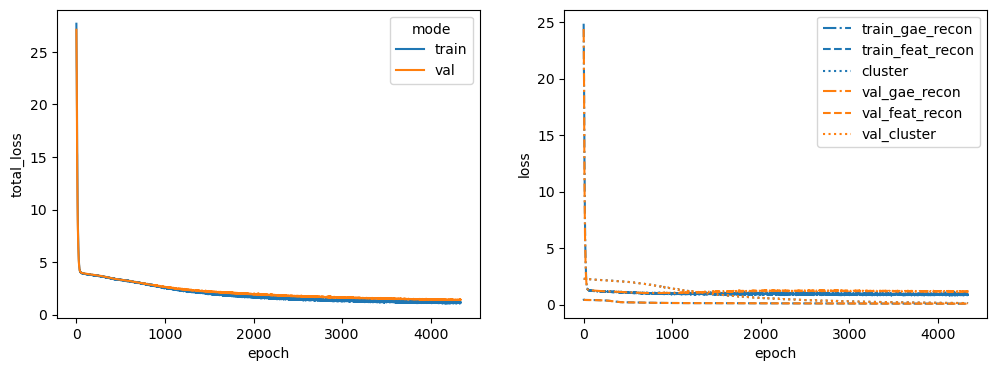

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


JUN


 49%|████▉     | 4917/10000 [01:45<01:49, 46.52it/s]


Training stopped after 4918 epochs
Best model found at epoch 4816
------------------------------------------------------------
TEST AUC: 0.7984580498866214 AP: 0.7945590041857288
TRAIN loss: 1.084723949432373
VAL loss: 1.4459559917449951
TEST loss: 1.4736618995666504
TEST AUC: 0.7984580498866214 	 AP: 0.7945590041857288


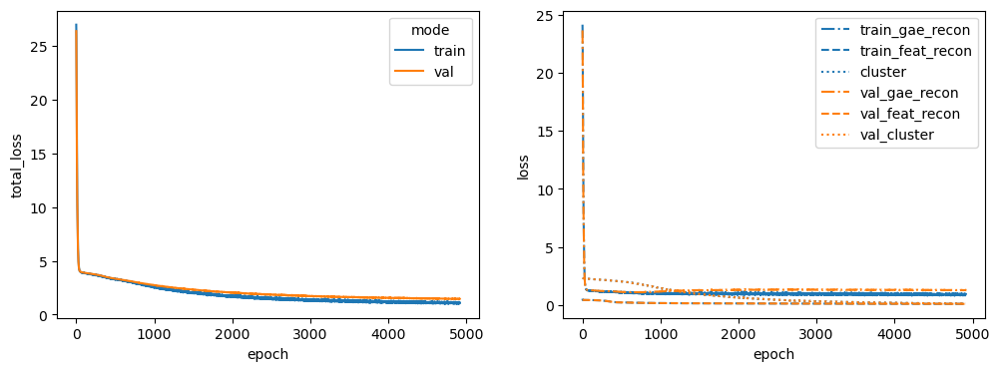

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP2K3


 48%|████▊     | 4826/10000 [01:43<01:51, 46.43it/s]


Training stopped after 4827 epochs
Best model found at epoch 4725
------------------------------------------------------------
TEST AUC: 0.8034467120181406 AP: 0.8223296645270701
TRAIN loss: 1.1334844827651978
VAL loss: 1.3259172439575195
TEST loss: 1.4631446599960327
TEST AUC: 0.8034467120181406 	 AP: 0.8223296645270701


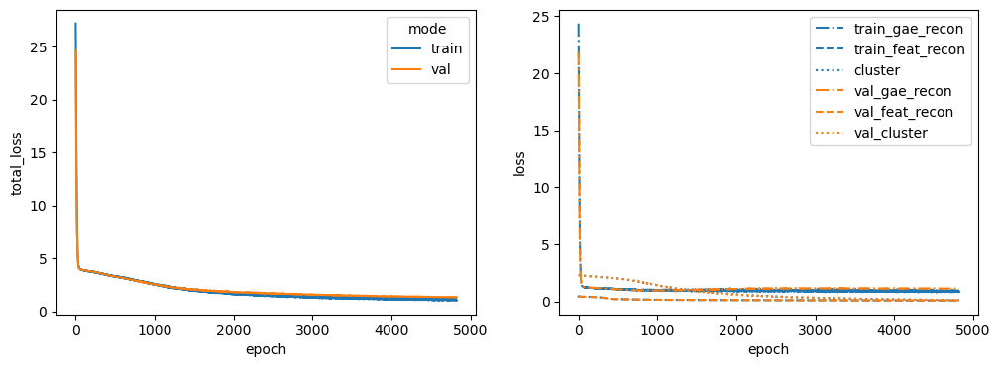

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K2


 54%|█████▍    | 5417/10000 [01:56<01:38, 46.41it/s]


Training stopped after 5418 epochs
Best model found at epoch 5316
------------------------------------------------------------
TEST AUC: 0.7963718820861677 AP: 0.8019557448983375
TRAIN loss: 1.16337251663208
VAL loss: 1.2222694158554077
TEST loss: 1.4607161283493042
TEST AUC: 0.7963718820861677 	 AP: 0.8019557448983375


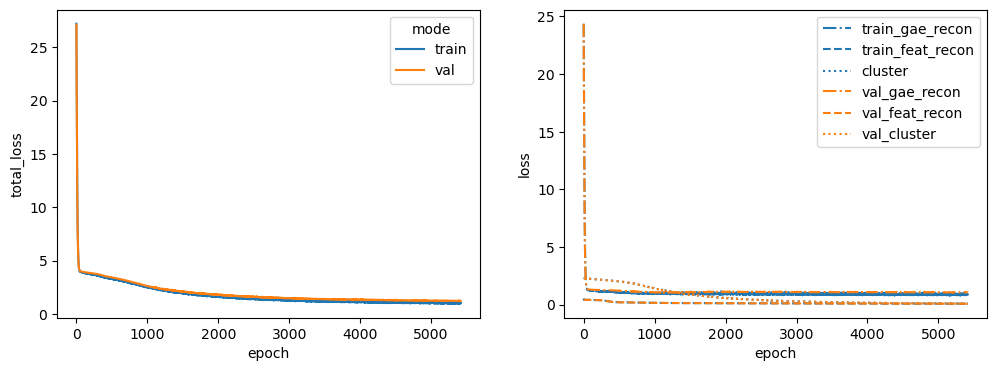

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K5


 41%|████      | 4114/10000 [01:30<02:09, 45.58it/s]


Training stopped after 4115 epochs
Best model found at epoch 4013
------------------------------------------------------------
TEST AUC: 0.8007256235827664 AP: 0.7679665908328047
TRAIN loss: 1.1232463121414185
VAL loss: 1.9043523073196411
TEST loss: 1.624578595161438
TEST AUC: 0.8007256235827664 	 AP: 0.7679665908328047


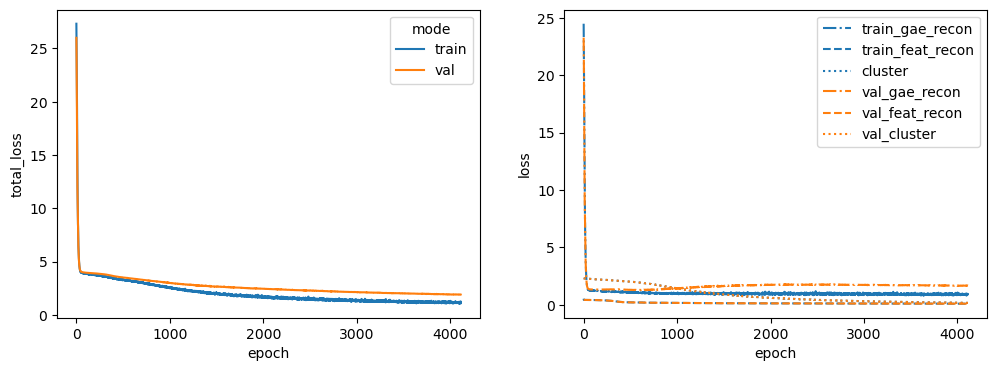

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K9


 42%|████▏     | 4220/10000 [01:30<02:04, 46.43it/s]


Training stopped after 4221 epochs
Best model found at epoch 4119
------------------------------------------------------------
TEST AUC: 0.8262131519274377 AP: 0.8258991050830445
TRAIN loss: 1.1851776838302612
VAL loss: 1.423708438873291
TEST loss: 1.4773848056793213
TEST AUC: 0.8262131519274377 	 AP: 0.8258991050830445


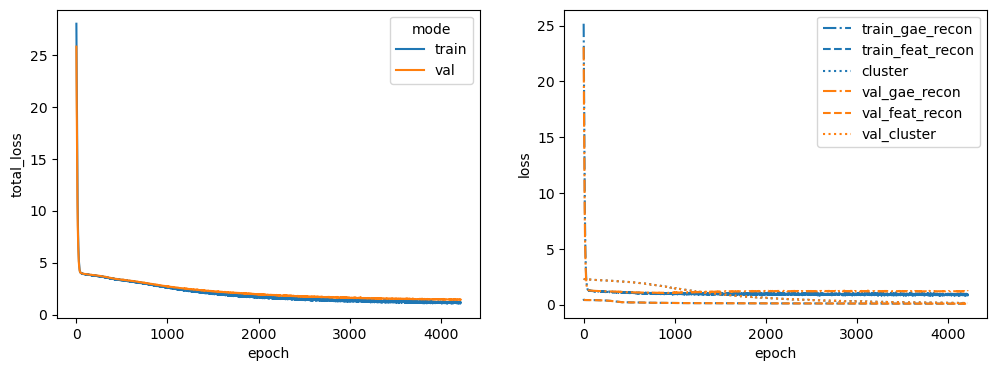

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAPK7


 35%|███▌      | 3519/10000 [01:16<02:20, 46.27it/s]


Training stopped after 3520 epochs
Best model found at epoch 3418
------------------------------------------------------------
TEST AUC: 0.7912925170068027 AP: 0.7959071190258037
TRAIN loss: 1.2473210096359253
VAL loss: 1.382469892501831
TEST loss: 1.6523783206939697
TEST AUC: 0.7912925170068027 	 AP: 0.7959071190258037


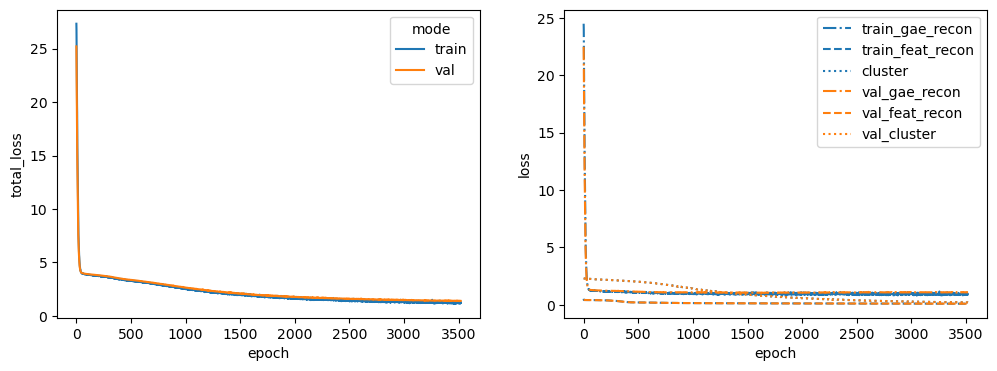

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MOS


 34%|███▍      | 3407/10000 [01:12<02:21, 46.71it/s]


Training stopped after 3408 epochs
Best model found at epoch 3306
------------------------------------------------------------
TEST AUC: 0.8184126984126985 AP: 0.8223599824509635
TRAIN loss: 1.3135833740234375
VAL loss: 1.8627148866653442
TEST loss: 1.6049214601516724
TEST AUC: 0.8184126984126985 	 AP: 0.8223599824509635


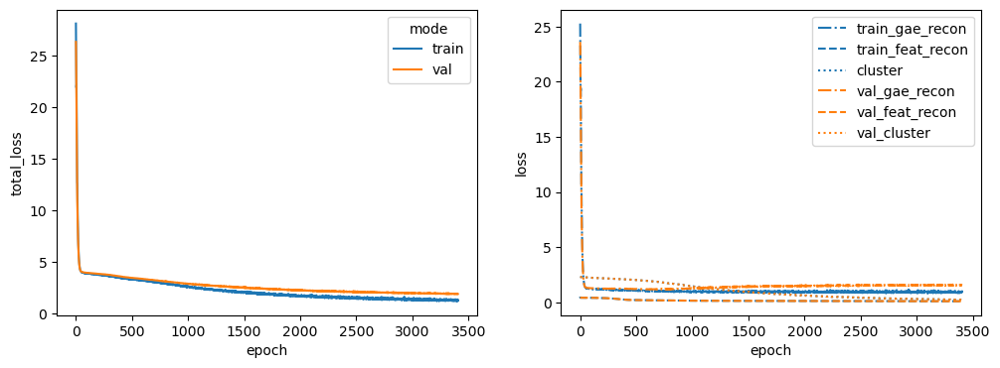

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MYD88


 44%|████▎     | 4369/10000 [01:32<01:59, 47.07it/s]


Training stopped after 4370 epochs
Best model found at epoch 4268
------------------------------------------------------------
TEST AUC: 0.8336507936507936 AP: 0.8226567817128423
TRAIN loss: 1.1193712949752808
VAL loss: 1.3873099088668823
TEST loss: 1.4401026964187622
TEST AUC: 0.8336507936507936 	 AP: 0.8226567817128423


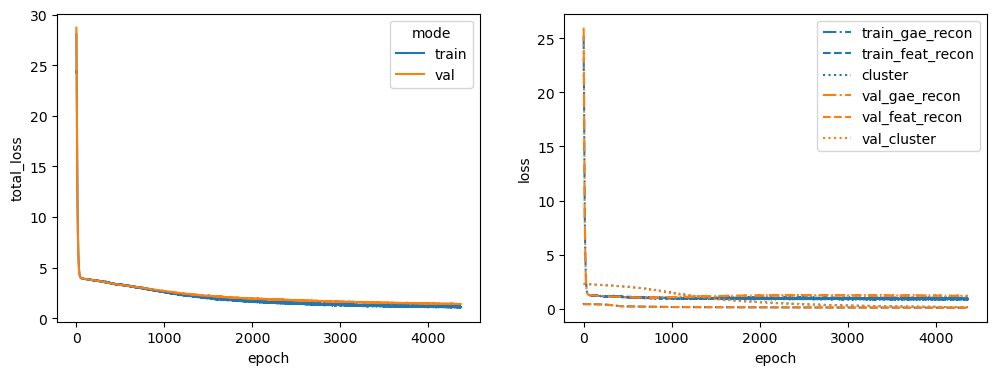

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PIK3R2


 25%|██▍       | 2467/10000 [00:54<02:46, 45.17it/s]


Training stopped after 2468 epochs
Best model found at epoch 2366
------------------------------------------------------------
TEST AUC: 0.8275736961451247 AP: 0.8198700438505959
TRAIN loss: 1.5045160055160522
VAL loss: 1.8947807550430298
TEST loss: 1.781753420829773
TEST AUC: 0.8275736961451247 	 AP: 0.8198700438505959


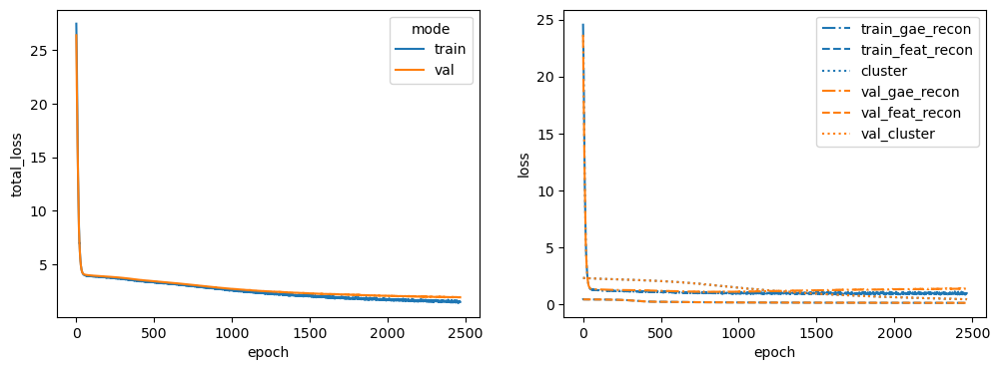

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKACA


 37%|███▋      | 3669/10000 [01:19<02:16, 46.34it/s]


Training stopped after 3670 epochs
Best model found at epoch 3568
------------------------------------------------------------
TEST AUC: 0.8161451247165533 AP: 0.8294867099854376
TRAIN loss: 1.1664836406707764
VAL loss: 1.5007480382919312
TEST loss: 1.535578966140747
TEST AUC: 0.8161451247165533 	 AP: 0.8294867099854376


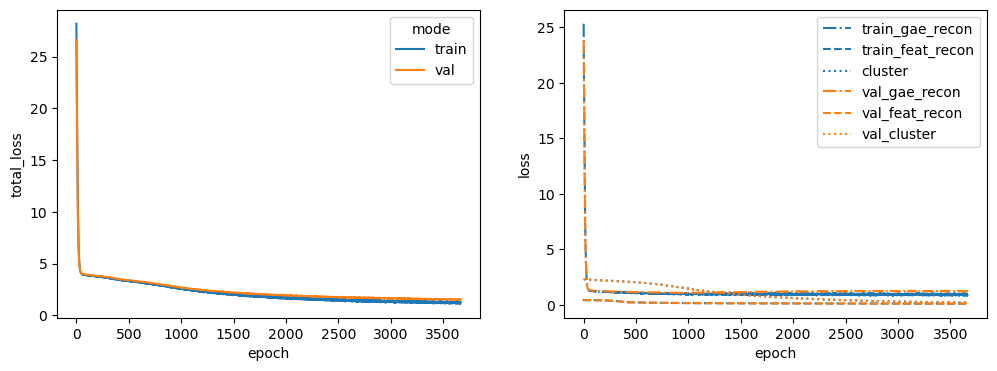

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKCE


 43%|████▎     | 4294/10000 [01:31<02:02, 46.71it/s]


Training stopped after 4295 epochs
Best model found at epoch 4193
------------------------------------------------------------
TEST AUC: 0.7997278911564625 AP: 0.8046026696254449
TRAIN loss: 1.1498379707336426
VAL loss: 1.5925569534301758
TEST loss: 1.5426218509674072
TEST AUC: 0.7997278911564625 	 AP: 0.8046026696254449


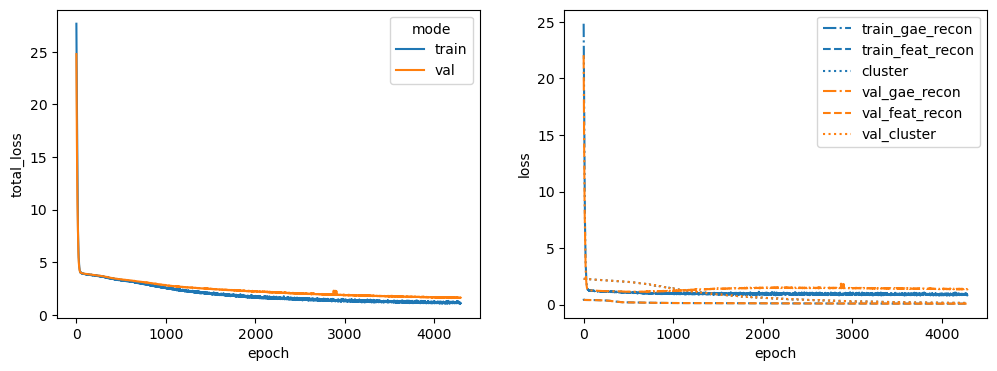

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RAF1


 47%|████▋     | 4698/10000 [01:39<01:52, 46.99it/s]


Training stopped after 4699 epochs
Best model found at epoch 4597
------------------------------------------------------------
TEST AUC: 0.8134240362811792 AP: 0.8091521144407279
TRAIN loss: 1.0710525512695312
VAL loss: 1.4078972339630127
TEST loss: 1.4930444955825806
TEST AUC: 0.8134240362811792 	 AP: 0.8091521144407279


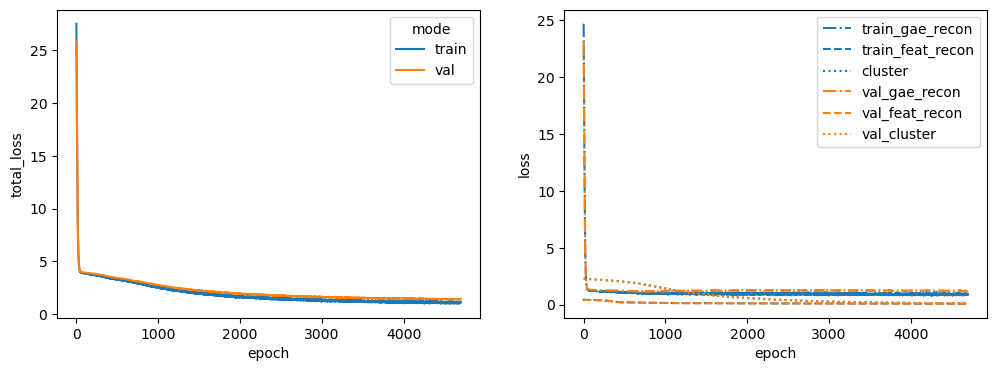

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RELB


 41%|████      | 4057/10000 [01:27<02:08, 46.42it/s]


Training stopped after 4058 epochs
Best model found at epoch 3956
------------------------------------------------------------
TEST AUC: 0.8114285714285714 AP: 0.7937646416575503
TRAIN loss: 1.3137471675872803
VAL loss: 1.4471673965454102
TEST loss: 1.5358070135116577
TEST AUC: 0.8114285714285714 	 AP: 0.7937646416575503


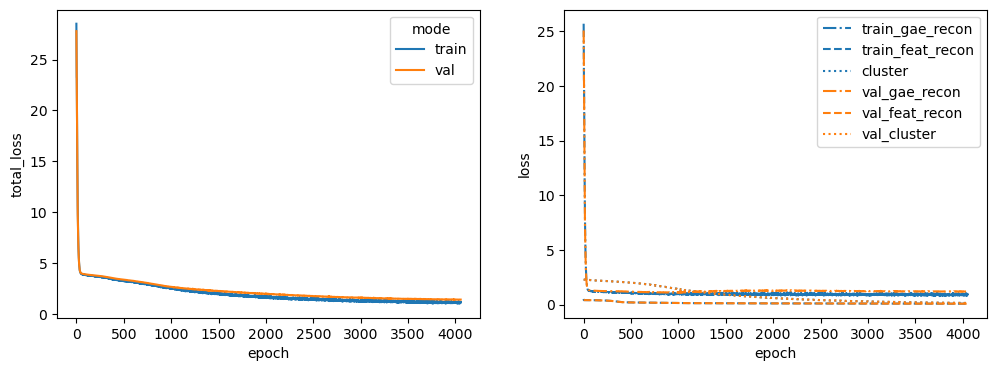

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RHOA


 40%|███▉      | 3951/10000 [01:24<02:08, 46.89it/s]


Training stopped after 3952 epochs
Best model found at epoch 3850
------------------------------------------------------------
TEST AUC: 0.8312925170068027 AP: 0.8418128975407546
TRAIN loss: 1.2378946542739868
VAL loss: 1.3909651041030884
TEST loss: 1.46284818649292
TEST AUC: 0.8312925170068027 	 AP: 0.8418128975407546


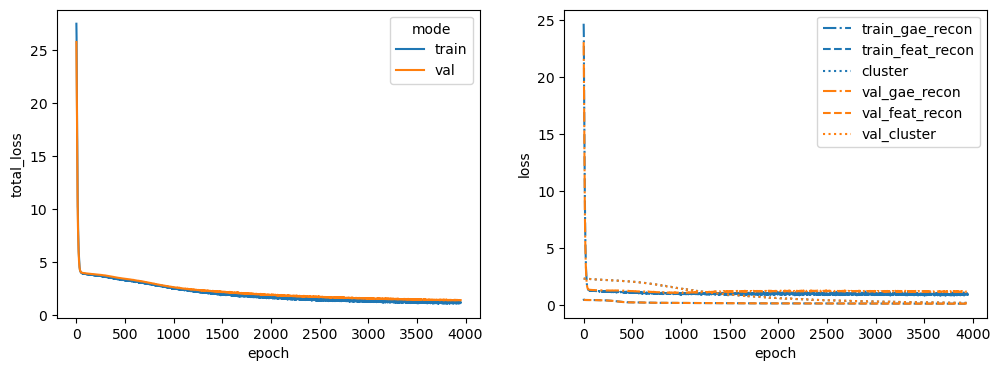

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMAD4


 46%|████▌     | 4579/10000 [01:41<01:59, 45.28it/s]


Training stopped after 4580 epochs
Best model found at epoch 4478
------------------------------------------------------------
TEST AUC: 0.831111111111111 AP: 0.8453053664591266
TRAIN loss: 1.0914185047149658
VAL loss: 1.4942562580108643
TEST loss: 1.4075844287872314
TEST AUC: 0.831111111111111 	 AP: 0.8453053664591266


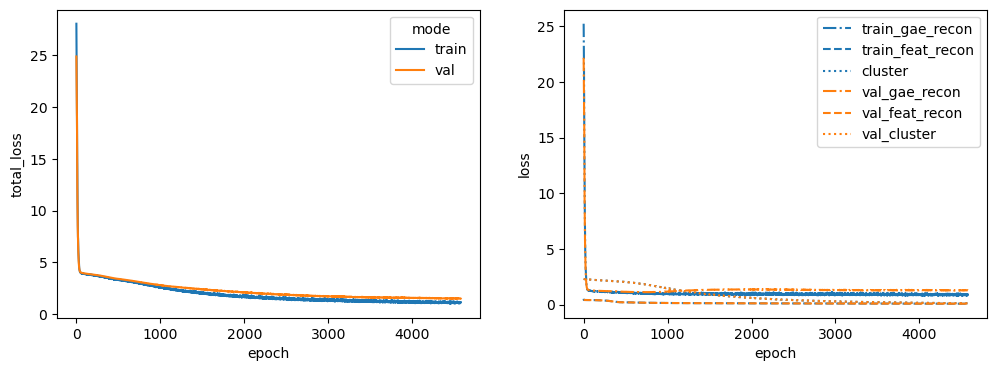

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMO


 36%|███▌      | 3586/10000 [01:22<02:27, 43.36it/s]


Training stopped after 3587 epochs
Best model found at epoch 3485
------------------------------------------------------------
TEST AUC: 0.8346485260770975 AP: 0.8383788532948977
TRAIN loss: 1.270795464515686
VAL loss: 1.566373348236084
TEST loss: 1.4825812578201294
TEST AUC: 0.8346485260770975 	 AP: 0.8383788532948977


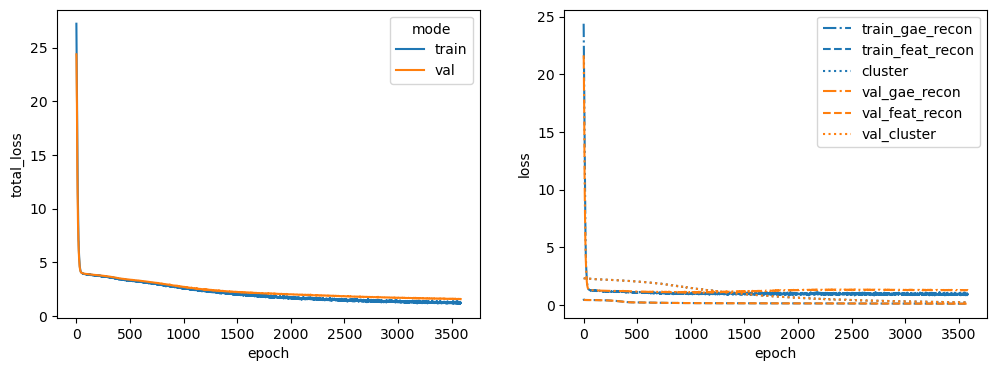

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SRC


 40%|███▉      | 3974/10000 [01:32<02:19, 43.13it/s]


Training stopped after 3975 epochs
Best model found at epoch 3873
------------------------------------------------------------
TEST AUC: 0.7974603174603174 AP: 0.8206041475155599
TRAIN loss: 1.1816569566726685
VAL loss: 1.3162034749984741
TEST loss: 1.554370641708374
TEST AUC: 0.7974603174603174 	 AP: 0.8206041475155599


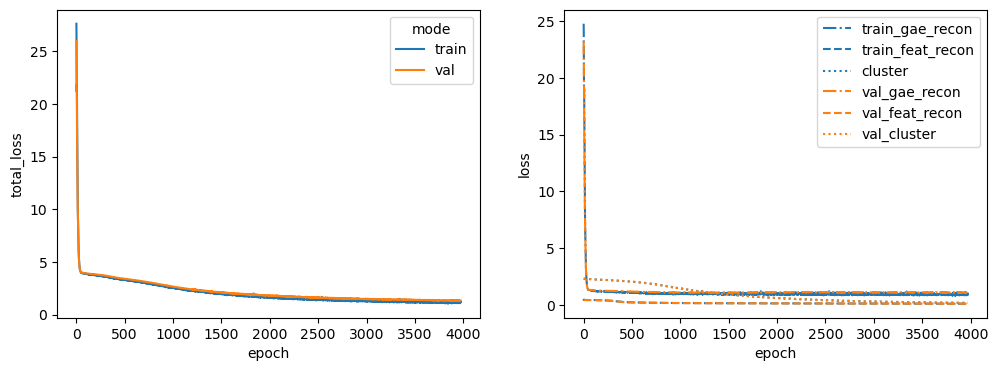

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SREBF1


 26%|██▌       | 2607/10000 [00:59<02:50, 43.47it/s]


Training stopped after 2608 epochs
Best model found at epoch 2506
------------------------------------------------------------
TEST AUC: 0.7909297052154195 AP: 0.7584811098096307
TRAIN loss: 1.4838049411773682
VAL loss: 1.8311384916305542
TEST loss: 1.9582035541534424
TEST AUC: 0.7909297052154195 	 AP: 0.7584811098096307


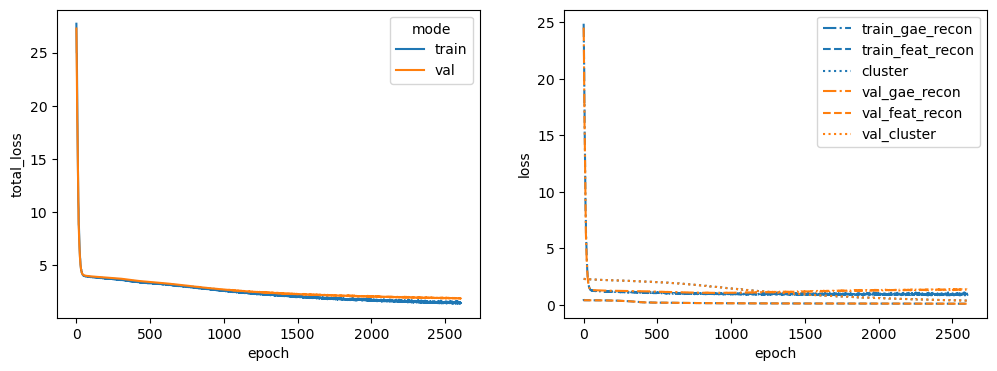

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TRAF2


 29%|██▊       | 2873/10000 [01:07<02:46, 42.70it/s]


Training stopped after 2874 epochs
Best model found at epoch 2772
------------------------------------------------------------
TEST AUC: 0.785578231292517 AP: 0.7754338771305581
TRAIN loss: 1.4177610874176025
VAL loss: 1.491789698600769
TEST loss: 1.8357892036437988
TEST AUC: 0.785578231292517 	 AP: 0.7754338771305581


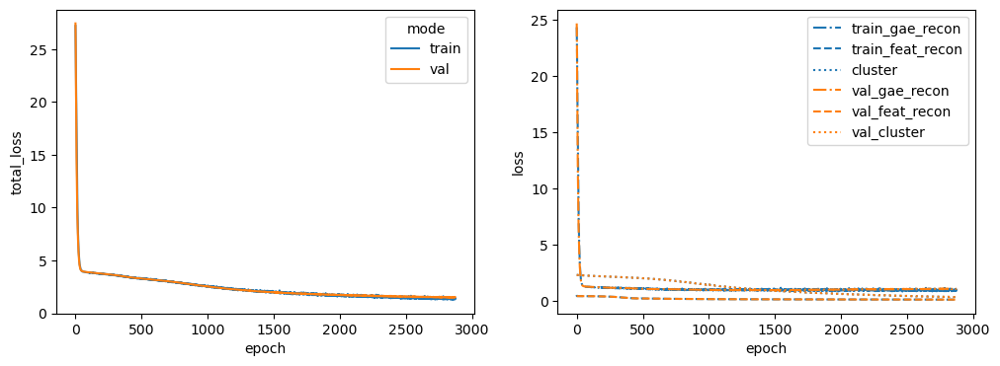

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TSC2


 46%|████▋     | 4645/10000 [01:47<02:03, 43.37it/s]


Training stopped after 4646 epochs
Best model found at epoch 4544
------------------------------------------------------------
TEST AUC: 0.8068934240362812 AP: 0.8142536249503576
TRAIN loss: 1.1082364320755005
VAL loss: 1.4788438081741333
TEST loss: 1.469576120376587
TEST AUC: 0.8068934240362812 	 AP: 0.8142536249503576


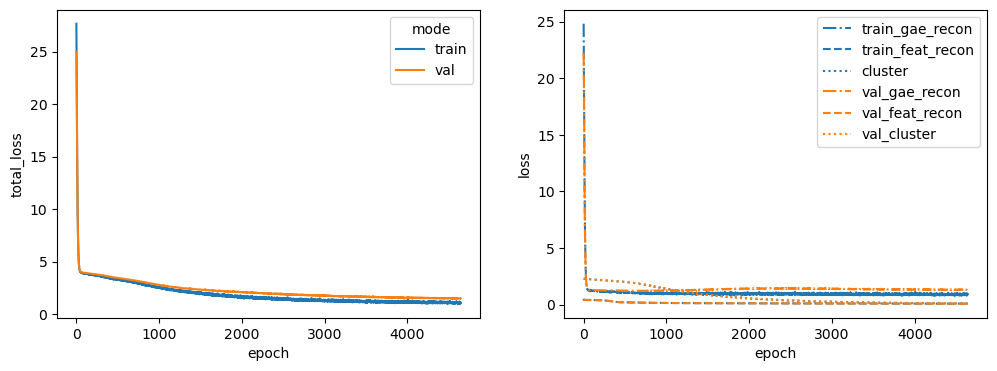

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


WWTR1


 37%|███▋      | 3714/10000 [01:27<02:27, 42.57it/s]


Training stopped after 3715 epochs
Best model found at epoch 3613
------------------------------------------------------------
TEST AUC: 0.8243990929705215 AP: 0.8160831866489809
TRAIN loss: 1.1586661338806152
VAL loss: 1.5512374639511108
TEST loss: 1.4893826246261597
TEST AUC: 0.8243990929705215 	 AP: 0.8160831866489809


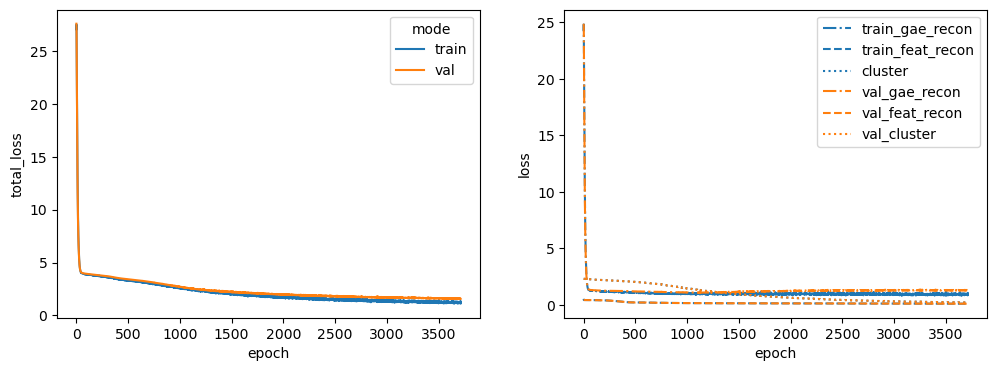

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


dict_keys(['AKT1S1', 'ATF4', 'BAX', 'BCL2L11', 'BRAF', 'CASP8', 'CDC42', 'CDKN1A', 'CEBPA', 'CREB1', 'CXXC4', 'DIABLO', 'E2F1', 'ELK1', 'EMPTY', 'ERG', 'FGFR3', 'FOXO1', 'GLI1', 'HRAS', 'IRAK4', 'JUN', 'MAP2K3', 'MAP3K2', 'MAP3K5', 'MAP3K9', 'MAPK7', 'MOS', 'MYD88', 'PIK3R2', 'PRKACA', 'PRKCE', 'RAF1', 'RELB', 'RHOA', 'SMAD4', 'SMO', 'SRC', 'SREBF1', 'TRAF2', 'TSC2', 'WWTR1'])
AKT1S1


 30%|███       | 3036/10000 [01:09<02:38, 43.83it/s]


Training stopped after 3037 epochs
Best model found at epoch 2935
------------------------------------------------------------
TEST AUC: 0.8141496598639456 AP: 0.8389622529920853
TRAIN loss: 1.386170744895935
VAL loss: 1.7391376495361328
TEST loss: 1.6349854469299316
TEST AUC: 0.8141496598639456 	 AP: 0.8389622529920853


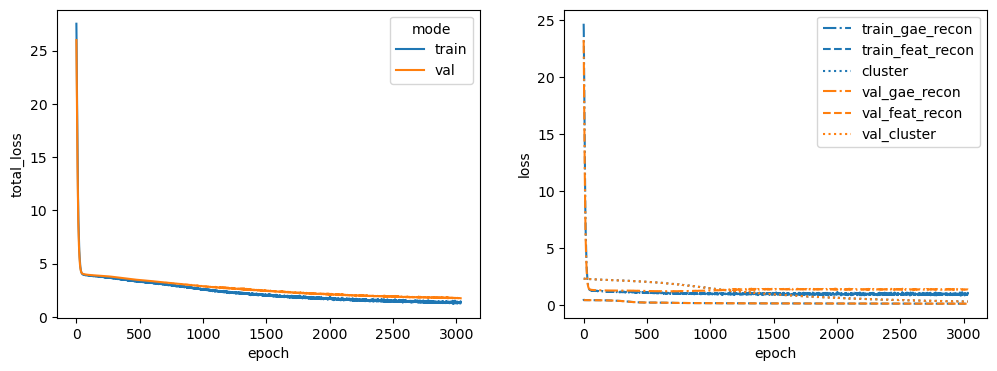

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ATF4


 30%|███       | 3007/10000 [01:08<02:40, 43.62it/s]


Training stopped after 3008 epochs
Best model found at epoch 2906
------------------------------------------------------------
TEST AUC: 0.7788662131519274 AP: 0.7459631754559661
TRAIN loss: 1.427708387374878
VAL loss: 1.6161692142486572
TEST loss: 1.8481860160827637
TEST AUC: 0.7788662131519274 	 AP: 0.7459631754559661


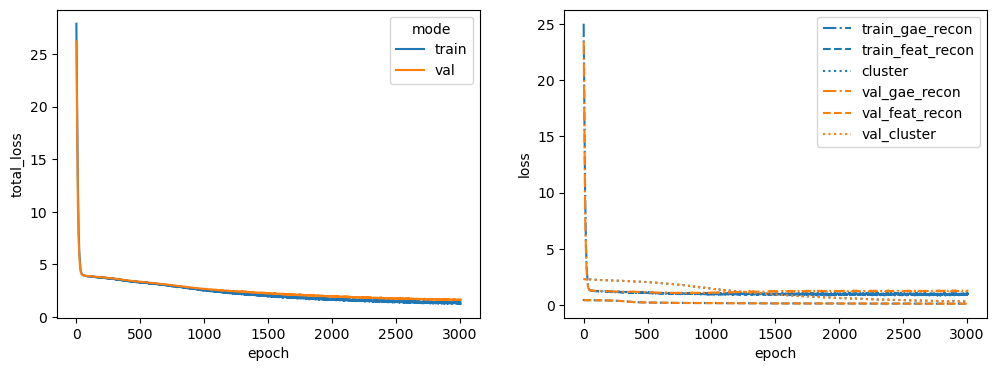

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BAX


 37%|███▋      | 3709/10000 [01:26<02:26, 43.07it/s]


Training stopped after 3710 epochs
Best model found at epoch 3608
------------------------------------------------------------
TEST AUC: 0.7873015873015873 AP: 0.7993482845607011
TRAIN loss: 1.2481595277786255
VAL loss: 1.5000699758529663
TEST loss: 1.6338860988616943
TEST AUC: 0.7873015873015873 	 AP: 0.7993482845607012


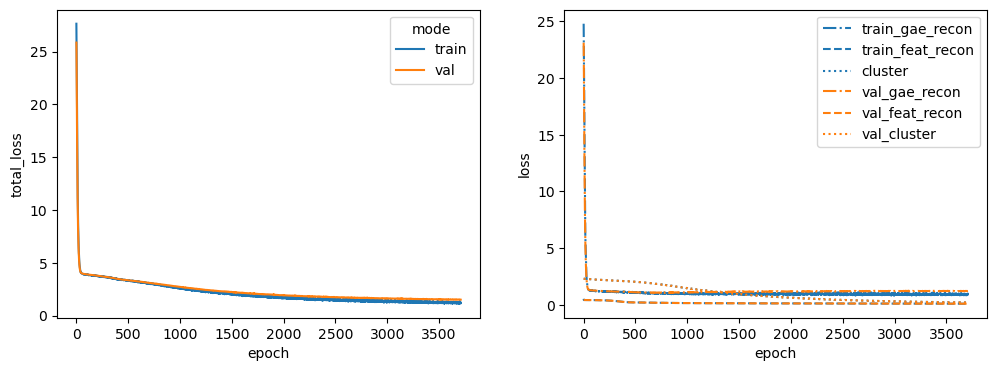

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BCL2L11


 55%|█████▍    | 5458/10000 [02:05<01:44, 43.43it/s]


Training stopped after 5459 epochs
Best model found at epoch 5357
------------------------------------------------------------
TEST AUC: 0.812063492063492 AP: 0.8304171258855237
TRAIN loss: 1.013180136680603
VAL loss: 1.4621398448944092
TEST loss: 1.4161556959152222
TEST AUC: 0.812063492063492 	 AP: 0.8304171258855237


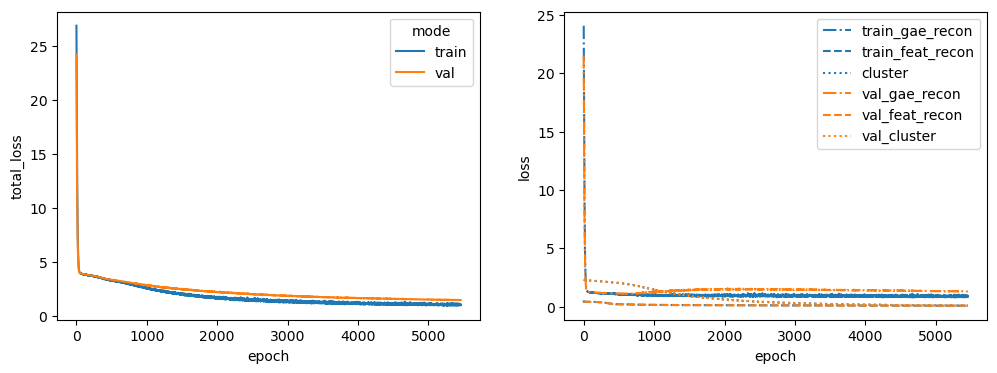

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BRAF


 31%|███       | 3060/10000 [01:10<02:40, 43.18it/s]


Training stopped after 3061 epochs
Best model found at epoch 2959
------------------------------------------------------------
TEST AUC: 0.8136961451247164 AP: 0.8130596878596386
TRAIN loss: 1.3843107223510742
VAL loss: 1.7018136978149414
TEST loss: 1.6496868133544922
TEST AUC: 0.8136961451247164 	 AP: 0.8130596878596386


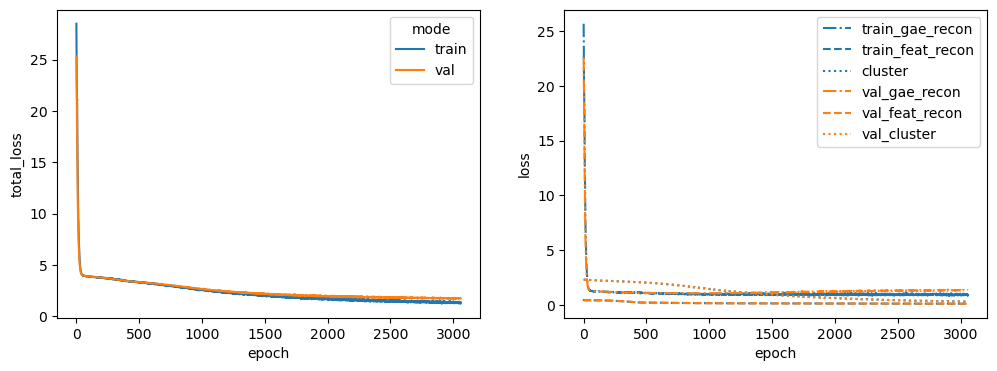

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CASP8


 38%|███▊      | 3843/10000 [01:28<02:22, 43.35it/s]


Training stopped after 3844 epochs
Best model found at epoch 3742
------------------------------------------------------------
TEST AUC: 0.8415419501133786 AP: 0.8530641311214288
TRAIN loss: 1.262762188911438
VAL loss: 1.4182519912719727
TEST loss: 1.4240458011627197
TEST AUC: 0.8415419501133786 	 AP: 0.8530641311214288


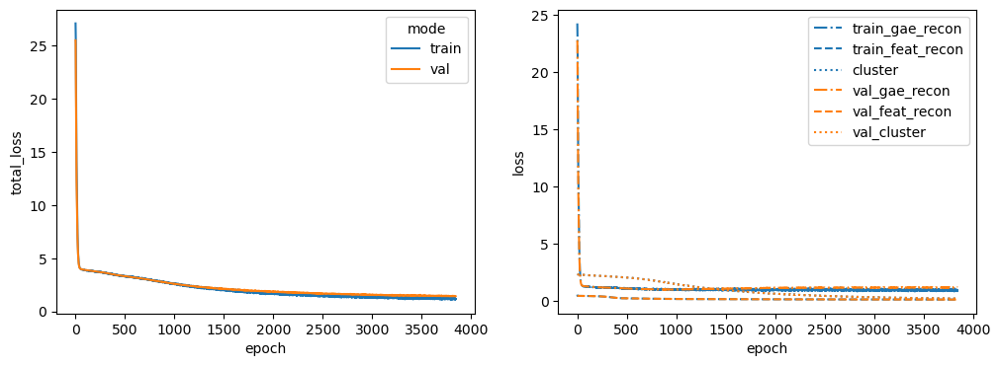

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDC42


 33%|███▎      | 3349/10000 [01:17<02:34, 43.09it/s]


Training stopped after 3350 epochs
Best model found at epoch 3248
------------------------------------------------------------
TEST AUC: 0.8208616780045351 AP: 0.8292167867703881
TRAIN loss: 1.3759195804595947
VAL loss: 1.456829309463501
TEST loss: 1.5733484029769897
TEST AUC: 0.8208616780045351 	 AP: 0.8292167867703881


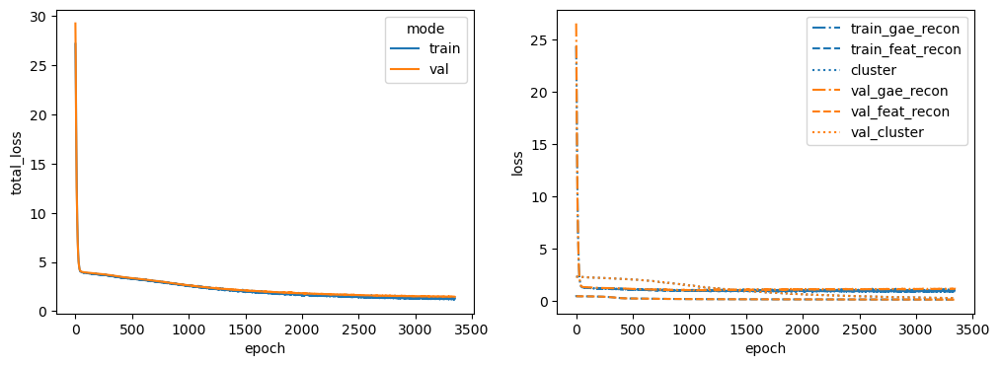

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDKN1A


 27%|██▋       | 2740/10000 [01:02<02:46, 43.61it/s]


Training stopped after 2741 epochs
Best model found at epoch 2639
------------------------------------------------------------
TEST AUC: 0.8357369614512471 AP: 0.8563372793188457
TRAIN loss: 1.4388759136199951
VAL loss: 2.0211617946624756
TEST loss: 1.6382455825805664
TEST AUC: 0.8357369614512471 	 AP: 0.8563372793188457


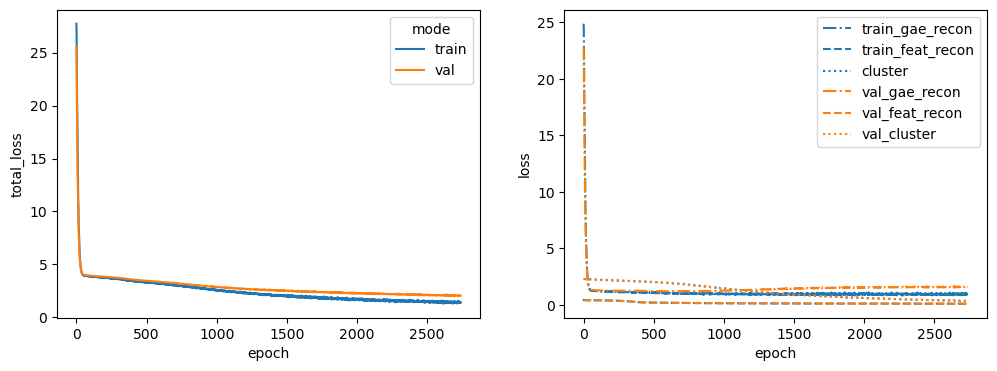

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CEBPA


 46%|████▋     | 4645/10000 [01:45<02:02, 43.89it/s]


Training stopped after 4646 epochs
Best model found at epoch 4544
------------------------------------------------------------
TEST AUC: 0.8423582766439909 AP: 0.843749649939187
TRAIN loss: 1.0772106647491455
VAL loss: 1.4866712093353271
TEST loss: 1.367220163345337
TEST AUC: 0.8423582766439909 	 AP: 0.843749649939187


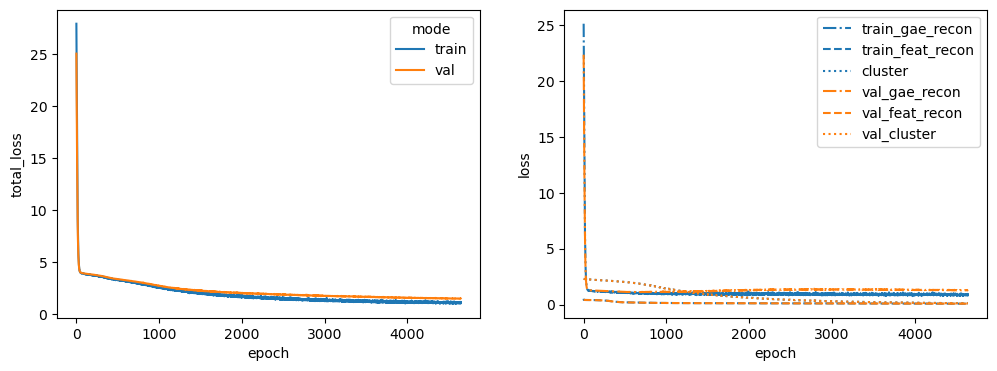

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CREB1


 31%|███       | 3121/10000 [01:12<02:39, 43.21it/s]


Training stopped after 3122 epochs
Best model found at epoch 3020
------------------------------------------------------------
TEST AUC: 0.7942857142857143 AP: 0.7881842706891039
TRAIN loss: 1.2676453590393066
VAL loss: 1.6448715925216675
TEST loss: 1.743916630744934
TEST AUC: 0.7942857142857143 	 AP: 0.7881842706891039


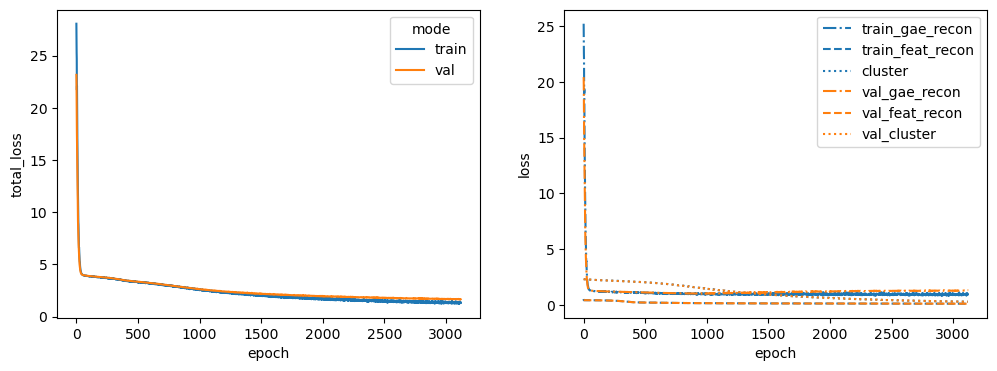

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CXXC4


 26%|██▌       | 2551/10000 [00:59<02:54, 42.73it/s]


Training stopped after 2552 epochs
Best model found at epoch 2450
------------------------------------------------------------
TEST AUC: 0.8 AP: 0.7894349434391752
TRAIN loss: 1.443514108657837
VAL loss: 1.7014864683151245
TEST loss: 1.8783729076385498
TEST AUC: 0.8 	 AP: 0.7894349434391752


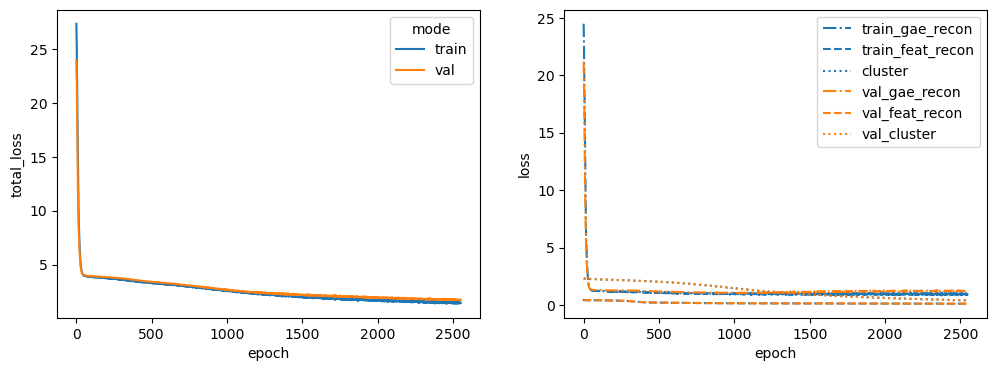

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


DIABLO


 31%|███       | 3108/10000 [01:11<02:37, 43.67it/s]


Training stopped after 3109 epochs
Best model found at epoch 3007
------------------------------------------------------------
TEST AUC: 0.8255782312925168 AP: 0.8170374739923818
TRAIN loss: 1.264317274093628
VAL loss: 1.6177605390548706
TEST loss: 1.6257023811340332
TEST AUC: 0.8255782312925168 	 AP: 0.8170374739923818


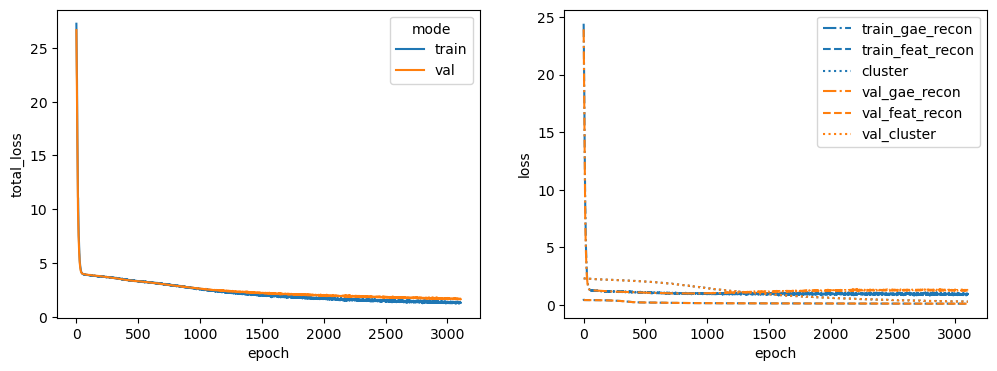

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


E2F1


 56%|█████▌    | 5567/10000 [02:07<01:41, 43.57it/s]


Training stopped after 5568 epochs
Best model found at epoch 5466
------------------------------------------------------------
TEST AUC: 0.7869387755102041 AP: 0.762728976815287
TRAIN loss: 1.0046335458755493
VAL loss: 1.2780486345291138
TEST loss: 1.7784174680709839
TEST AUC: 0.7869387755102041 	 AP: 0.762728976815287


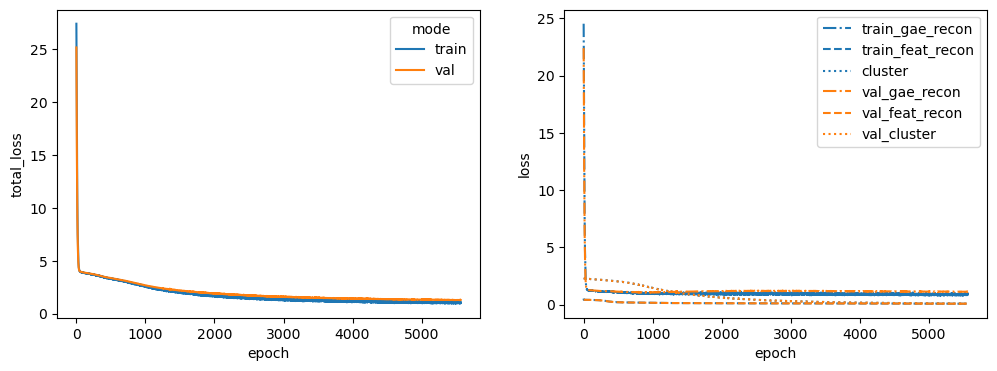

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ELK1


 38%|███▊      | 3837/10000 [01:27<02:20, 43.95it/s]


Training stopped after 3838 epochs
Best model found at epoch 3736
------------------------------------------------------------
TEST AUC: 0.8150566893424035 AP: 0.8227822696535051
TRAIN loss: 1.246677279472351
VAL loss: 1.489726185798645
TEST loss: 1.5323516130447388
TEST AUC: 0.8150566893424035 	 AP: 0.8227822696535051


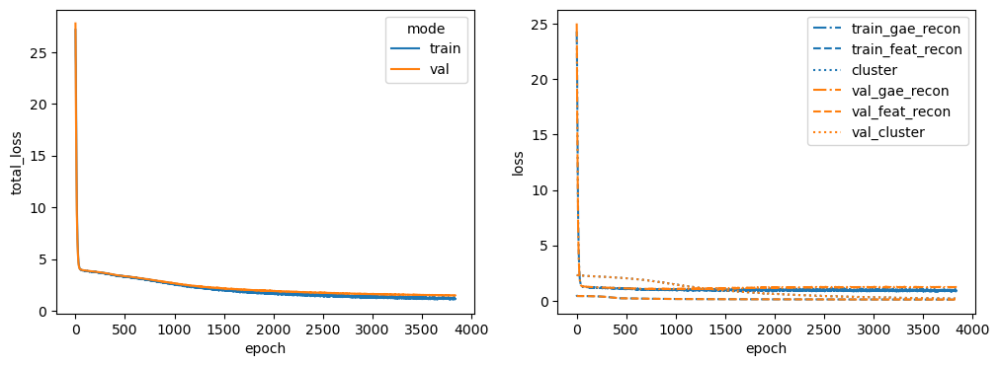

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


EMPTY


 42%|████▏     | 4205/10000 [01:36<02:13, 43.48it/s]


Training stopped after 4206 epochs
Best model found at epoch 4104
------------------------------------------------------------
TEST AUC: 0.8031746031746032 AP: 0.7975396737862689
TRAIN loss: 1.1119123697280884
VAL loss: 1.3829723596572876
TEST loss: 1.5968515872955322
TEST AUC: 0.8031746031746032 	 AP: 0.7975396737862689


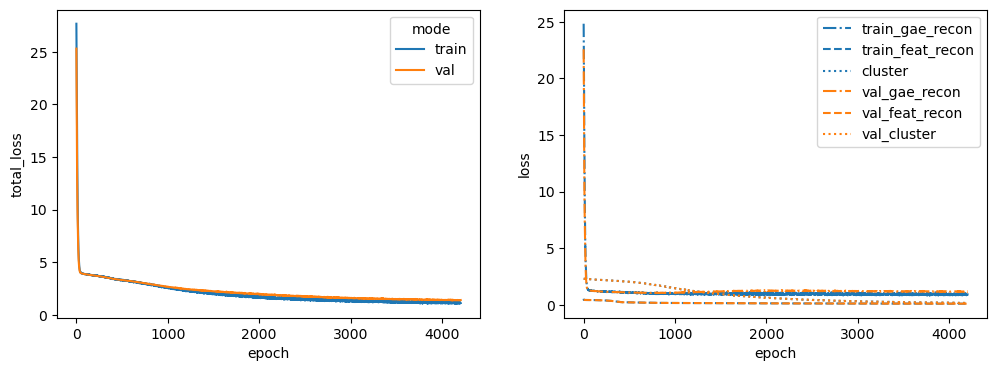

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ERG


 43%|████▎     | 4297/10000 [01:39<02:12, 43.06it/s]


Training stopped after 4298 epochs
Best model found at epoch 4196
------------------------------------------------------------
TEST AUC: 0.8180498866213153 AP: 0.8325786028934703
TRAIN loss: 1.1217907667160034
VAL loss: 1.5055032968521118
TEST loss: 1.4814413785934448
TEST AUC: 0.8180498866213153 	 AP: 0.8325786028934703


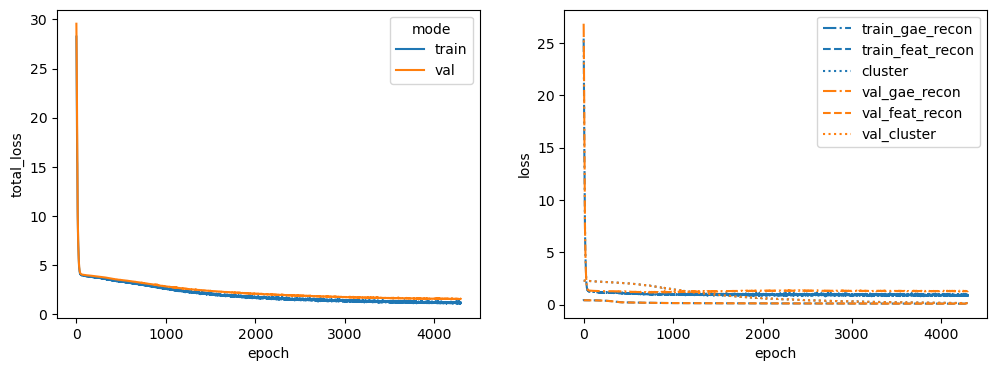

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FGFR3


 33%|███▎      | 3291/10000 [01:15<02:34, 43.32it/s]


Training stopped after 3292 epochs
Best model found at epoch 3190
------------------------------------------------------------
TEST AUC: 0.8175056689342404 AP: 0.812098264487175
TRAIN loss: 1.2147409915924072
VAL loss: 1.5280885696411133
TEST loss: 1.619900107383728
TEST AUC: 0.8175056689342404 	 AP: 0.812098264487175


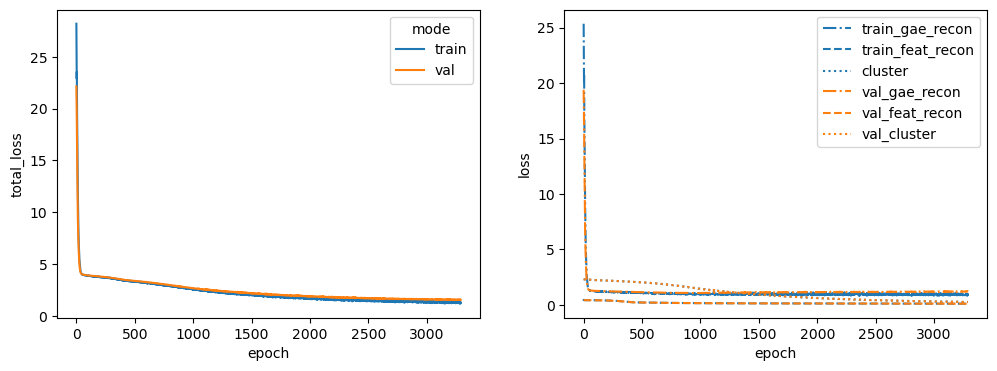

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FOXO1


 47%|████▋     | 4701/10000 [01:48<02:02, 43.28it/s]


Training stopped after 4702 epochs
Best model found at epoch 4600
------------------------------------------------------------
TEST AUC: 0.8187755102040816 AP: 0.823446230340212
TRAIN loss: 1.134992241859436
VAL loss: 1.7190656661987305
TEST loss: 1.4406063556671143
TEST AUC: 0.8187755102040816 	 AP: 0.823446230340212


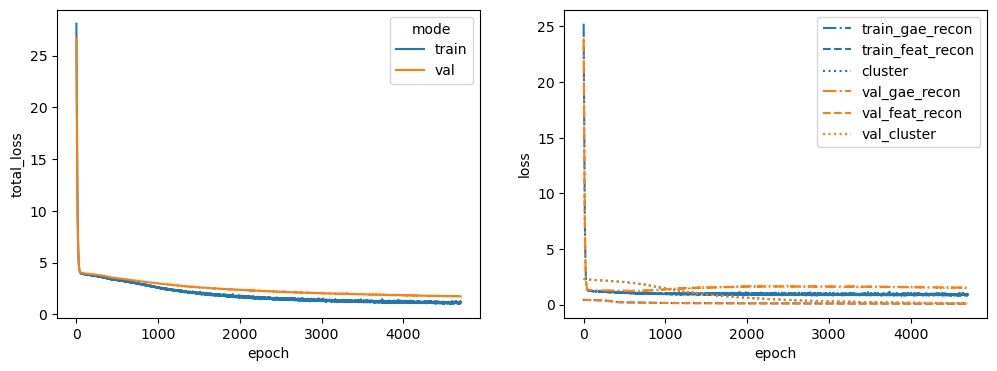

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


GLI1


 33%|███▎      | 3301/10000 [01:11<02:24, 46.42it/s]


Training stopped after 3302 epochs
Best model found at epoch 3200
------------------------------------------------------------
TEST AUC: 0.8183219954648526 AP: 0.806373152513808
TRAIN loss: 1.3272650241851807
VAL loss: 1.5392258167266846
TEST loss: 1.670257329940796
TEST AUC: 0.8183219954648526 	 AP: 0.806373152513808


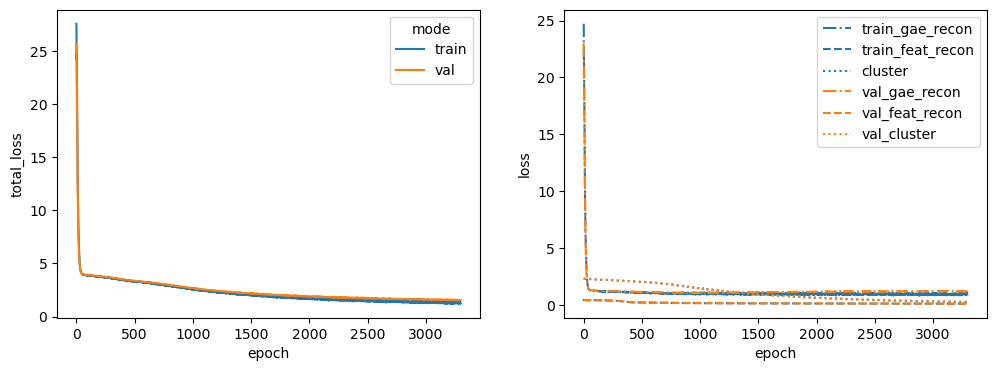

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


HRAS


 42%|████▏     | 4152/10000 [01:23<01:56, 50.02it/s]


Training stopped after 4153 epochs
Best model found at epoch 4051
------------------------------------------------------------
TEST AUC: 0.7737868480725624 AP: 0.7543066214714479
TRAIN loss: 1.173149824142456
VAL loss: 1.4611625671386719
TEST loss: 1.7237032651901245
TEST AUC: 0.7737868480725624 	 AP: 0.7543066214714479


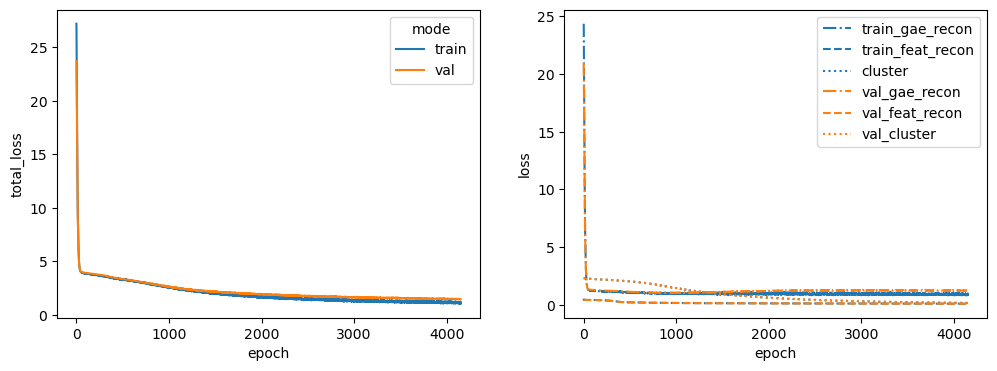

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


IRAK4


 29%|██▉       | 2893/10000 [00:58<02:22, 49.72it/s]


Training stopped after 2894 epochs
Best model found at epoch 2792
------------------------------------------------------------
TEST AUC: 0.7760544217687074 AP: 0.7645019818361274
TRAIN loss: 1.3395037651062012
VAL loss: 1.8290863037109375
TEST loss: 1.8636006116867065
TEST AUC: 0.7760544217687074 	 AP: 0.7645019818361274


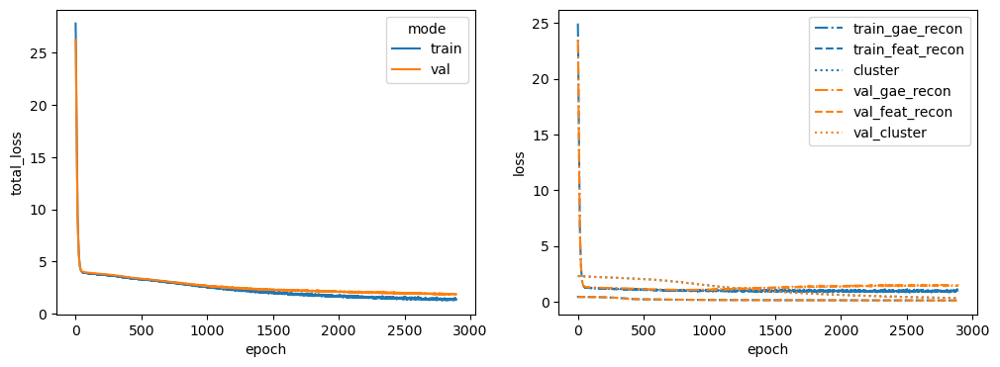

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


JUN


 33%|███▎      | 3254/10000 [01:06<02:17, 49.12it/s]


Training stopped after 3255 epochs
Best model found at epoch 3153
------------------------------------------------------------
TEST AUC: 0.8281179138321996 AP: 0.8109635311893516
TRAIN loss: 1.3038389682769775
VAL loss: 1.5562256574630737
TEST loss: 1.587456226348877
TEST AUC: 0.8281179138321996 	 AP: 0.8109635311893516


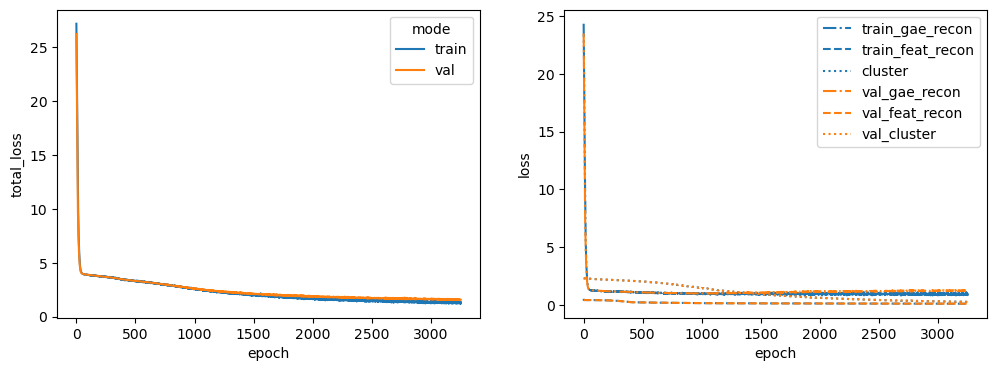

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP2K3


 54%|█████▍    | 5447/10000 [01:49<01:31, 49.67it/s]


Training stopped after 5448 epochs
Best model found at epoch 5346
------------------------------------------------------------
TEST AUC: 0.7969160997732426 AP: 0.78899823728296
TRAIN loss: 1.0328420400619507
VAL loss: 1.4556481838226318
TEST loss: 1.4767175912857056
TEST AUC: 0.7969160997732426 	 AP: 0.78899823728296


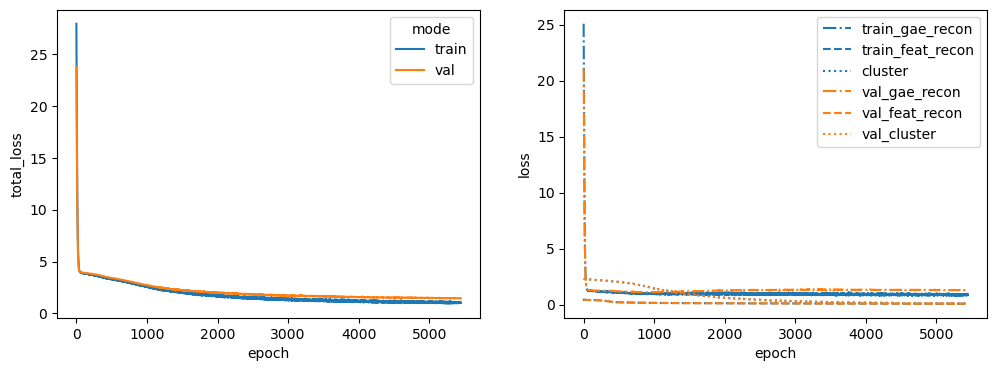

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K2


 36%|███▌      | 3618/10000 [01:12<02:08, 49.65it/s]


Training stopped after 3619 epochs
Best model found at epoch 3517
------------------------------------------------------------
TEST AUC: 0.8166893424036281 AP: 0.8096316065219548
TRAIN loss: 1.2238860130310059
VAL loss: 1.6681790351867676
TEST loss: 1.571035385131836
TEST AUC: 0.8166893424036281 	 AP: 0.8096316065219548


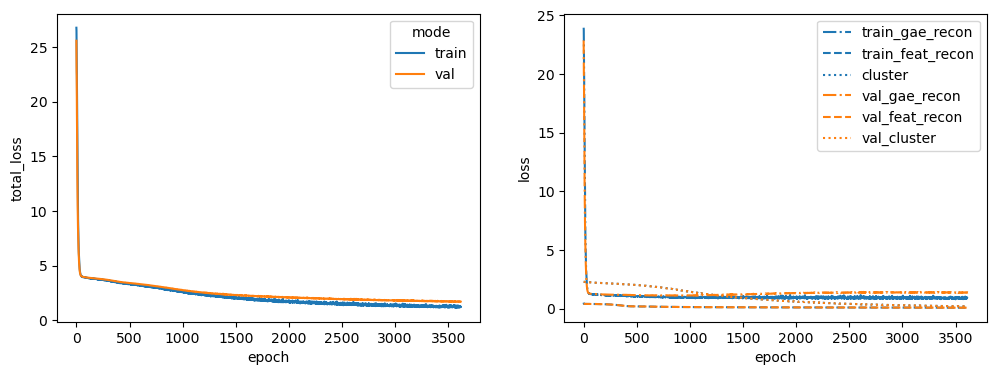

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K5


 32%|███▏      | 3218/10000 [01:04<02:16, 49.68it/s]


Training stopped after 3219 epochs
Best model found at epoch 3117
------------------------------------------------------------
TEST AUC: 0.8171428571428572 AP: 0.8335023941891153
TRAIN loss: 1.357645034790039
VAL loss: 1.6314070224761963
TEST loss: 1.5989147424697876
TEST AUC: 0.8171428571428572 	 AP: 0.8335023941891153


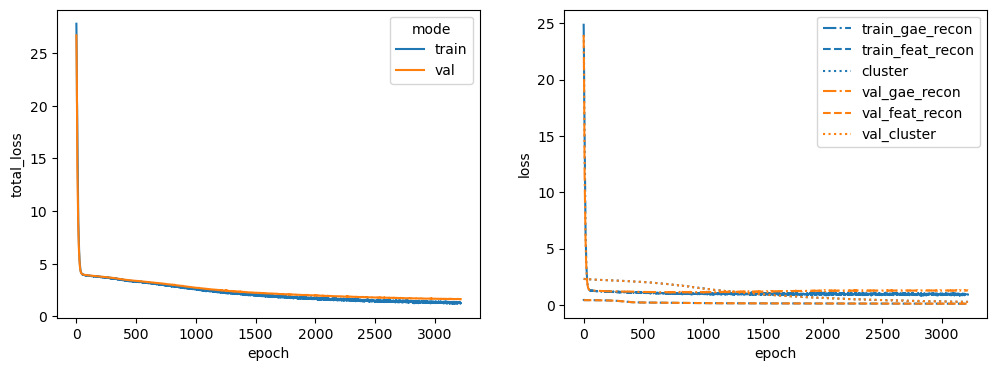

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K9


 30%|██▉       | 2966/10000 [01:00<02:23, 48.87it/s]


Training stopped after 2967 epochs
Best model found at epoch 2865
------------------------------------------------------------
TEST AUC: 0.8091609977324263 AP: 0.8134821134931463
TRAIN loss: 1.3045246601104736
VAL loss: 1.7148404121398926
TEST loss: 1.688876986503601
TEST AUC: 0.8091609977324263 	 AP: 0.8134821134931463


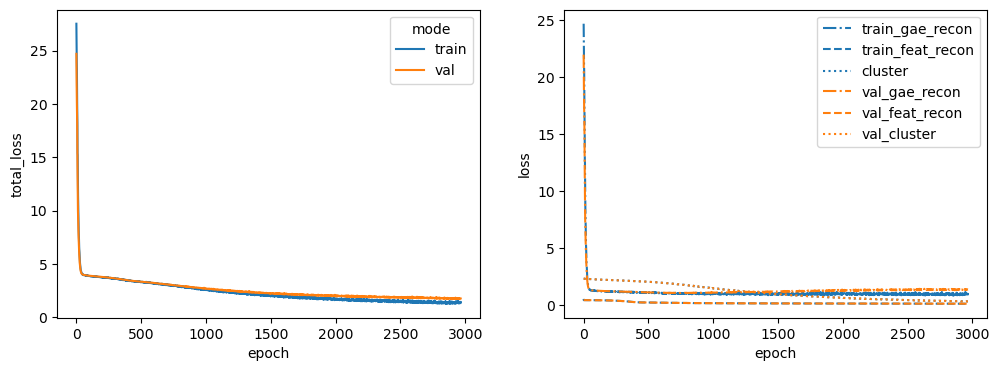

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAPK7


 53%|█████▎    | 5269/10000 [01:45<01:34, 49.87it/s]


Training stopped after 5270 epochs
Best model found at epoch 5168
------------------------------------------------------------
TEST AUC: 0.8242176870748299 AP: 0.839775110451049
TRAIN loss: 1.0895516872406006
VAL loss: 1.3205254077911377
TEST loss: 1.3810020685195923
TEST AUC: 0.8242176870748299 	 AP: 0.839775110451049


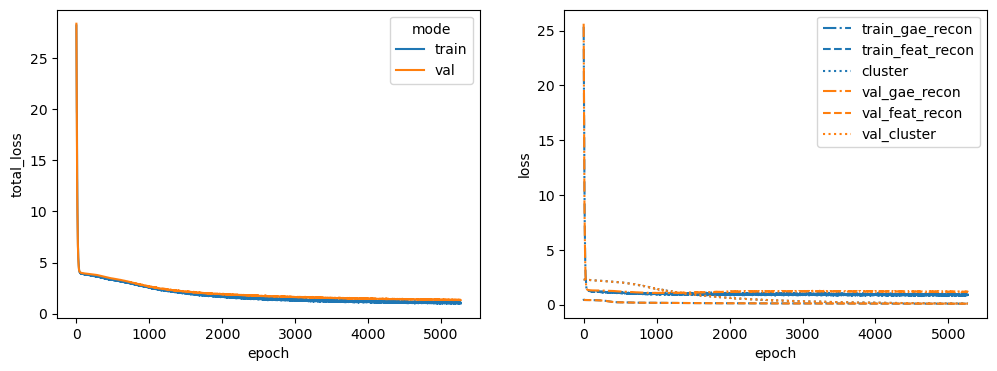

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MOS


 44%|████▎     | 4353/10000 [01:27<01:54, 49.48it/s]


Training stopped after 4354 epochs
Best model found at epoch 4252
------------------------------------------------------------
TEST AUC: 0.7834920634920635 AP: 0.7466640396155466
TRAIN loss: 1.0831328630447388
VAL loss: 1.7075821161270142
TEST loss: 1.7013243436813354
TEST AUC: 0.7834920634920635 	 AP: 0.7466640396155466


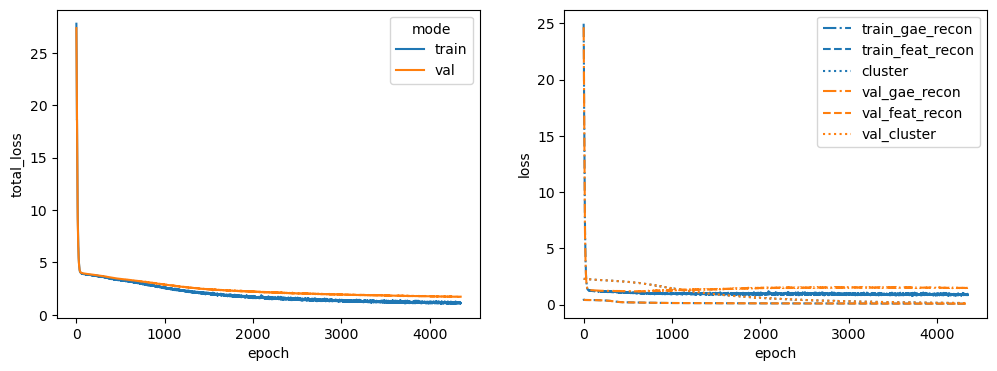

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MYD88


 40%|███▉      | 3991/10000 [01:20<02:01, 49.49it/s]


Training stopped after 3992 epochs
Best model found at epoch 3890
------------------------------------------------------------
TEST AUC: 0.8053514739229025 AP: 0.7993011132415047
TRAIN loss: 1.1602632999420166
VAL loss: 1.3802129030227661
TEST loss: 1.6278043985366821
TEST AUC: 0.8053514739229025 	 AP: 0.7993011132415047


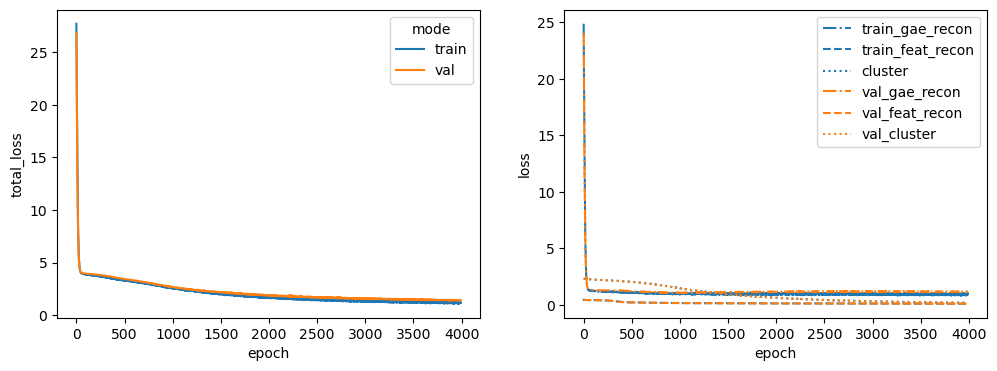

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PIK3R2


 40%|███▉      | 3982/10000 [01:21<02:03, 48.85it/s]


Training stopped after 3983 epochs
Best model found at epoch 3881
------------------------------------------------------------
TEST AUC: 0.7944671201814058 AP: 0.7867646505278474
TRAIN loss: 1.1549938917160034
VAL loss: 1.6871654987335205
TEST loss: 1.584265947341919
TEST AUC: 0.7944671201814058 	 AP: 0.7867646505278474


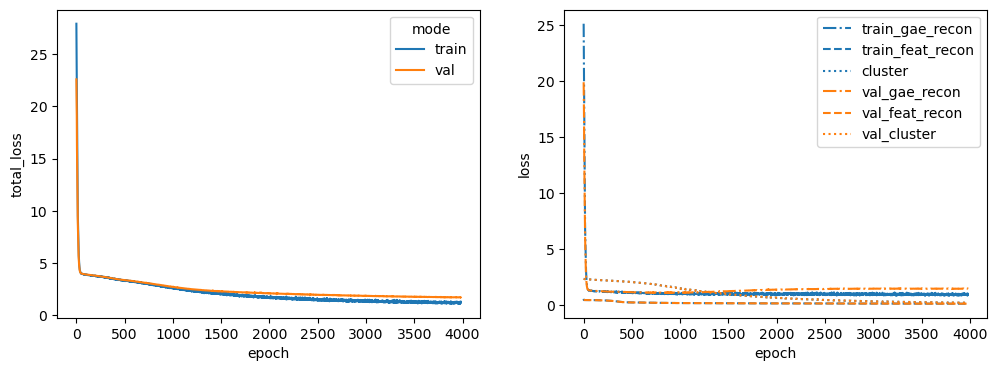

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKACA


 31%|███       | 3099/10000 [01:03<02:21, 48.64it/s]


Training stopped after 3100 epochs
Best model found at epoch 2998
------------------------------------------------------------
TEST AUC: 0.8089795918367346 AP: 0.8230779265269195
TRAIN loss: 1.395844578742981
VAL loss: 1.5210142135620117
TEST loss: 1.654683232307434
TEST AUC: 0.8089795918367346 	 AP: 0.8230779265269195


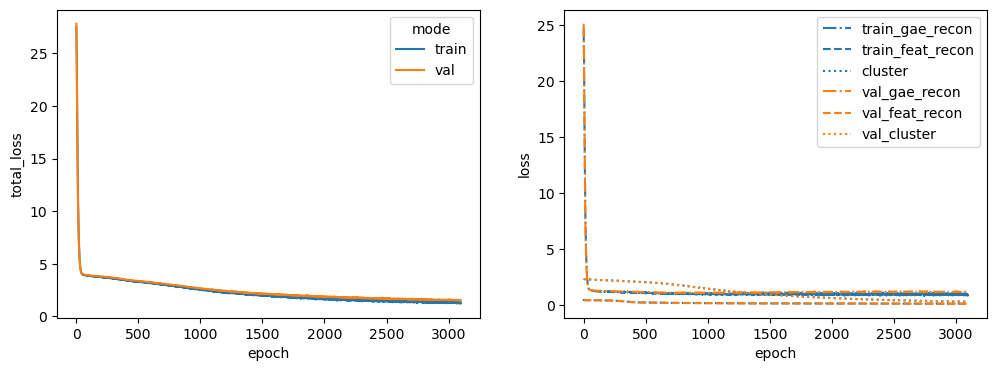

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKCE


 39%|███▉      | 3879/10000 [01:18<02:04, 49.18it/s]


Training stopped after 3880 epochs
Best model found at epoch 3778
------------------------------------------------------------
TEST AUC: 0.8049886621315191 AP: 0.8180721808905486
TRAIN loss: 1.2227379083633423
VAL loss: 1.5313339233398438
TEST loss: 1.5358054637908936
TEST AUC: 0.8049886621315191 	 AP: 0.8180721808905486


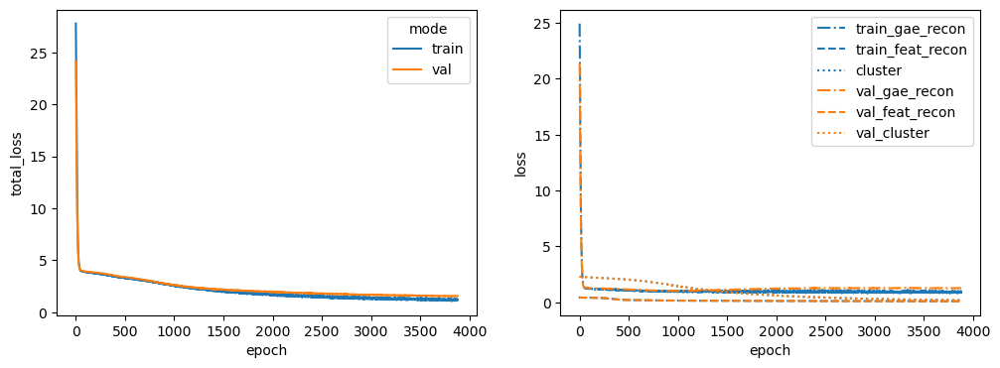

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RAF1


 42%|████▏     | 4194/10000 [01:24<01:56, 49.70it/s]


Training stopped after 4195 epochs
Best model found at epoch 4093
------------------------------------------------------------
TEST AUC: 0.8210430839002268 AP: 0.8337599517449075
TRAIN loss: 1.1990089416503906
VAL loss: 1.5980730056762695
TEST loss: 1.4779152870178223
TEST AUC: 0.8210430839002268 	 AP: 0.8337599517449075


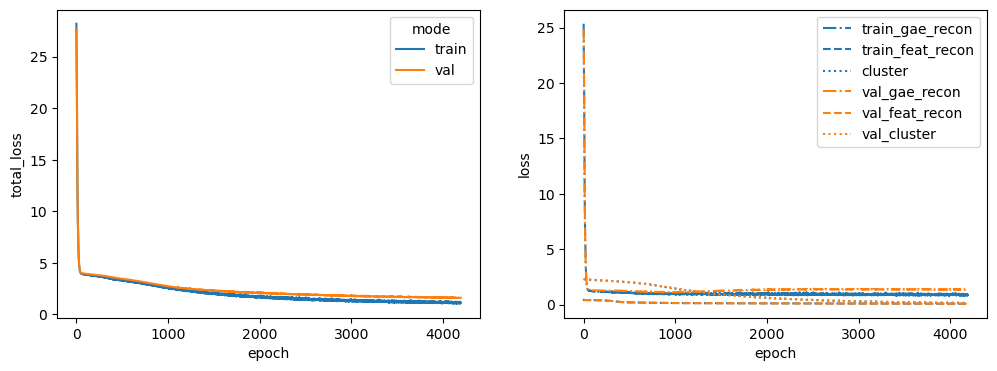

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RELB


 50%|████▉     | 4953/10000 [01:40<01:42, 49.20it/s]


Training stopped after 4954 epochs
Best model found at epoch 4852
------------------------------------------------------------
TEST AUC: 0.8057142857142857 AP: 0.8116072969417691
TRAIN loss: 1.137948751449585
VAL loss: 1.4998689889907837
TEST loss: 1.571484923362732
TEST AUC: 0.8057142857142857 	 AP: 0.8116072969417691


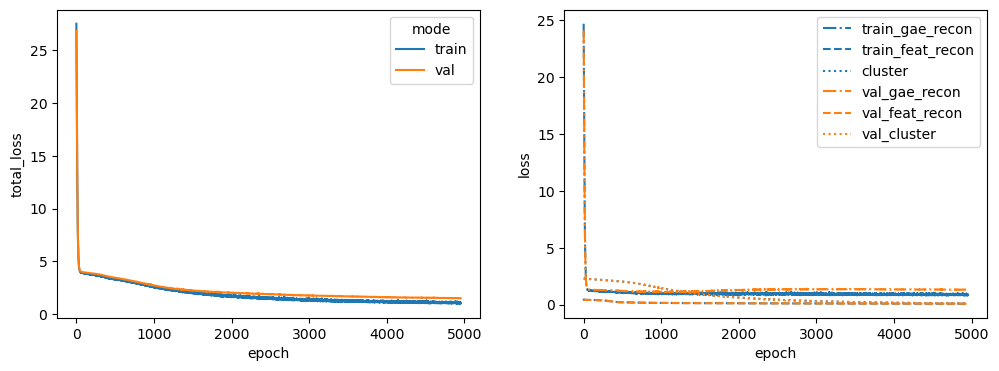

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RHOA


 39%|███▉      | 3901/10000 [01:20<02:05, 48.63it/s]


Training stopped after 3902 epochs
Best model found at epoch 3800
------------------------------------------------------------
TEST AUC: 0.8420861678004534 AP: 0.8694904586435656
TRAIN loss: 1.1745059490203857
VAL loss: 1.6011078357696533
TEST loss: 1.4064993858337402
TEST AUC: 0.8420861678004534 	 AP: 0.8694904586435656


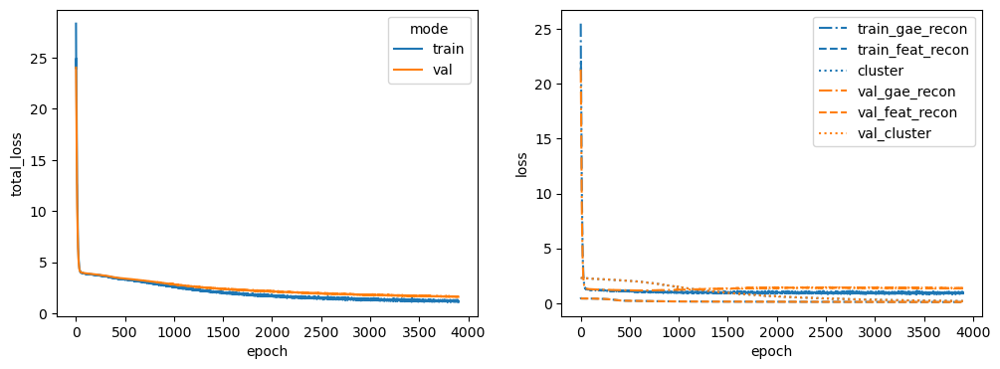

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMAD4


 49%|████▉     | 4911/10000 [01:45<01:49, 46.58it/s]


Training stopped after 4912 epochs
Best model found at epoch 4810
------------------------------------------------------------
TEST AUC: 0.801451247165533 AP: 0.8182526436975966
TRAIN loss: 1.1171226501464844
VAL loss: 1.3417202234268188
TEST loss: 1.4807463884353638
TEST AUC: 0.801451247165533 	 AP: 0.8182526436975966


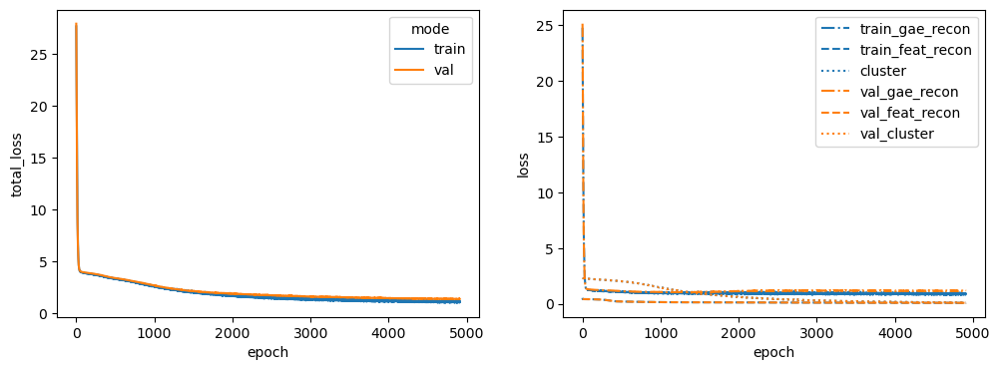

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMO


 50%|█████     | 5006/10000 [01:49<01:49, 45.65it/s]


Training stopped after 5007 epochs
Best model found at epoch 4905
------------------------------------------------------------
TEST AUC: 0.7867573696145125 AP: 0.7628874366199674
TRAIN loss: 1.0797455310821533
VAL loss: 1.453594446182251
TEST loss: 1.6329668760299683
TEST AUC: 0.7867573696145125 	 AP: 0.7628874366199674


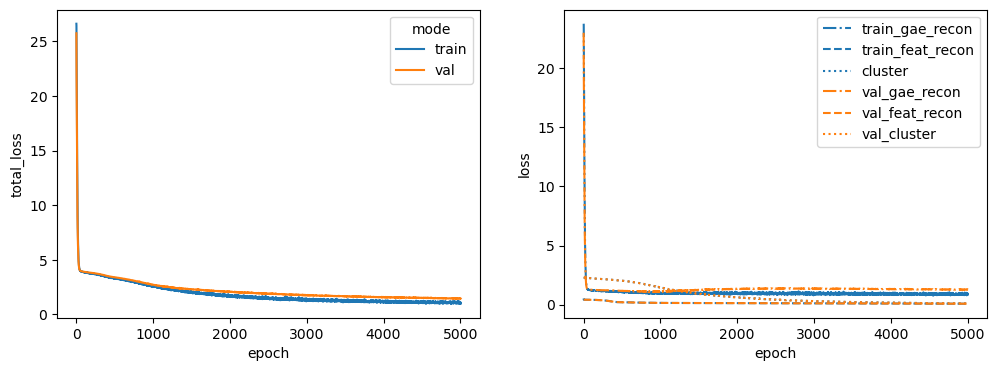

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SRC


 38%|███▊      | 3751/10000 [01:24<02:20, 44.48it/s]


Training stopped after 3752 epochs
Best model found at epoch 3650
------------------------------------------------------------
TEST AUC: 0.7951020408163265 AP: 0.7275628986134405
TRAIN loss: 1.2235374450683594
VAL loss: 1.6298069953918457
TEST loss: 1.9841232299804688
TEST AUC: 0.7951020408163265 	 AP: 0.7275628986134405


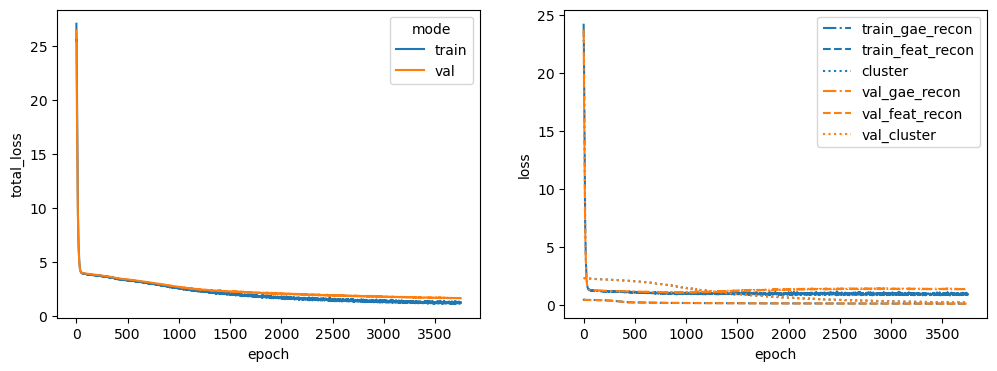

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SREBF1


 36%|███▌      | 3615/10000 [01:18<02:18, 45.97it/s]


Training stopped after 3616 epochs
Best model found at epoch 3514
------------------------------------------------------------
TEST AUC: 0.8326530612244897 AP: 0.8440616830831402
TRAIN loss: 1.1911628246307373
VAL loss: 1.5346601009368896
TEST loss: 1.494791865348816
TEST AUC: 0.8326530612244897 	 AP: 0.8440616830831402


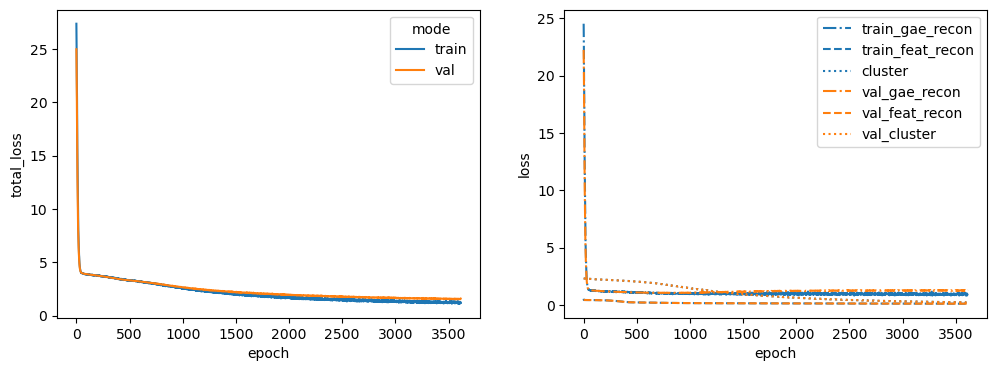

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TRAF2


 46%|████▌     | 4572/10000 [01:38<01:56, 46.50it/s]


Training stopped after 4573 epochs
Best model found at epoch 4471
------------------------------------------------------------
TEST AUC: 0.8085260770975057 AP: 0.8413566169998037
TRAIN loss: 1.1180636882781982
VAL loss: 1.6379592418670654
TEST loss: 1.4569873809814453
TEST AUC: 0.8085260770975057 	 AP: 0.8413566169998037


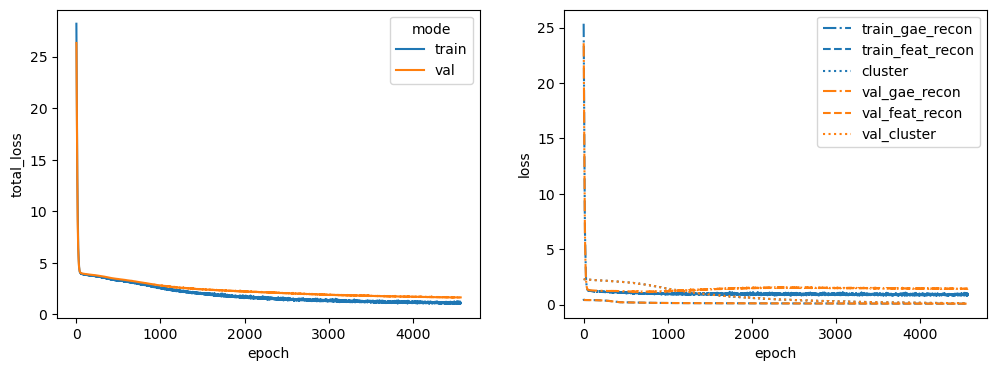

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TSC2


 46%|████▌     | 4581/10000 [01:39<01:57, 46.00it/s]


Training stopped after 4582 epochs
Best model found at epoch 4480
------------------------------------------------------------
TEST AUC: 0.833015873015873 AP: 0.8569407338994475
TRAIN loss: 1.0859313011169434
VAL loss: 1.4035018682479858
TEST loss: 1.375171422958374
TEST AUC: 0.833015873015873 	 AP: 0.8569407338994475


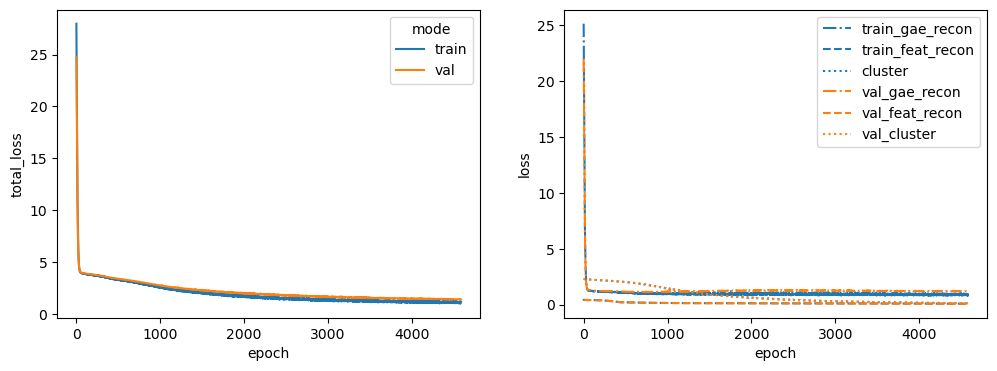

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


WWTR1


 35%|███▍      | 3482/10000 [01:14<02:20, 46.46it/s]


Training stopped after 3483 epochs
Best model found at epoch 3381
------------------------------------------------------------
TEST AUC: 0.8151473922902495 AP: 0.8257445489627041
TRAIN loss: 1.2063463926315308
VAL loss: 1.4688901901245117
TEST loss: 1.5509051084518433
TEST AUC: 0.8151473922902495 	 AP: 0.8257445489627041


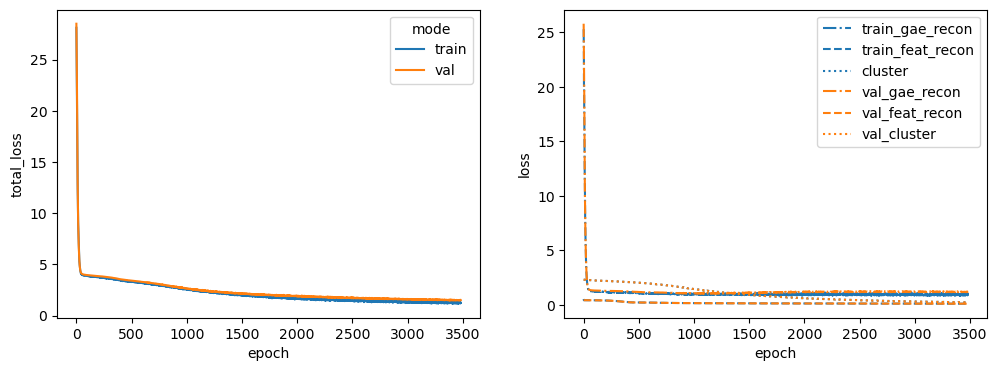

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


<IPython.core.display.Javascript object>

In [26]:
cluster_opts = ["physical_full", "cmap", "cmap_full"]
for cluster_opt in cluster_opts:
    run_reg_space_loto_exp(
        root_output_dir=root_output_dir,
        oe_targets=oe_targets,
        interactome=spearman_interactome,
        physical_cluster_dict=physical_cluster_dict,
        physical_full_cluster_dict=physical_full_cluster_dict,
        cmap_clusters=cmap_clusters,
        cluster_opt=cluster_opt,
        graph_opt=graph_opt,
        alpha=1,
        beta=1,
        gamma=1,
        n_classes=10,
        seed=1234,
        node_feature_key="sc_gex_hallmark",
        input_dim=1176,
        latent_dim=1024,
        early_stopping=100,
        neg_edge_ratio=1,
        lr=0.00001,
    )

---

## 4. Full regulatory gene embeddings

For the figure shown in the main paper, we also require to infer the regulatory space using the cluster structure of the physical space not trained in a leave-one-out-setting and transferring the full cluster structure.
In the following we will run an according experiment for the setup of $(\alpha, \beta, \gamma) = (1,0,1)$ and using a graph split into training, validation and test set as before.

### 4.1. Train GAE on full graph with full gene perturbation cluster structure including controls

In [11]:
physical_all_clusters = pd.read_csv(
    "../../../../data/experiments/rohban/interactome/cluster_infos/mean_physical_clusters.csv", index_col=0
)

<IPython.core.display.Javascript object>

In [167]:
output_dir = "../../../../data/experiments/rohban/interactome/embeddings/all_reg_embs"
os.makedirs(output_dir, exist_ok=True)

<IPython.core.display.Javascript object>

In [168]:
all_graph = spearman_interactome.copy()
for node in all_graph.nodes(data=True):
    node[-1]["sc_gex"] = np.array(gex_data_z.loc[:, node[0]])
    node[-1]["sc_gex"] = node[-1]["sc_gex"]
    if node[0] in physical_all_clusters.index:
        node[-1]["label"] = physical_all_clusters.loc[node[0], "cluster"]
        node[-1]["label_mask"] = True
    else:
        node[-1]["label"] = -1
        node[-1]["label_mask"] = False

    node[-1]["name"] = node[0]
    node[-1]["spec_target"] = node[0] in oe_targets

    gene_memberships = []
    for geneset in hallmark_geneset_dict.values():
        if node[0] in geneset:
            gene_memberships.append(1.0)
        else:
            gene_memberships.append(0.0)

    node[-1]["hallmark"] = np.array(gene_memberships)
    node[-1]["sc_gex_hallmark"] = np.concatenate(
        [node[-1]["sc_gex"], node[-1]["hallmark"]]
    )

<IPython.core.display.Javascript object>

In [15]:
all_clusters = get_colored_clusters(physical_all_clusters)

<IPython.core.display.Javascript object>

ALL


 38%|███▊      | 3837/10000 [01:15<02:00, 51.04it/s]


Training stopped after 3838 epochs
Best model found at epoch 3736
------------------------------------------------------------
TEST AUC: 0.8036281179138323 AP: 0.8212821261165021
TRAIN loss: 1.042241096496582
VAL loss: 1.2513443231582642
TEST loss: 1.395155906677246
TEST AUC: 0.8036281179138323 	 AP: 0.8212821261165021


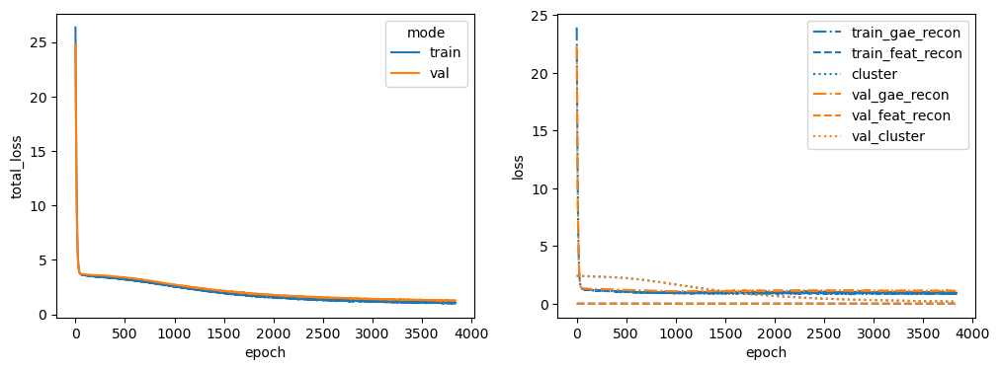

<IPython.core.display.Javascript object>

In [181]:
latents_dict, loss_hist_dict, graph_data = run_loto_inference(
            graph=all_graph,
            oe_target="ALL",
            output_dir=output_dir,
            cluster_opt="all_clusters",
            alpha=1,
            beta=0,
            gamma=1,
            n_classes=11,
            node_feature_key="sc_gex_hallmark",
            input_dim=1176,
            latent_dim=1024,
            graph_opt="split_graph",
            seed=1234,
            lr=0.00001,
            early_stopping=100,
            neg_edge_ratio=1,
            n_epochs=10000,
            device="cpu",
        )


In [182]:
latents = latents_dict[seed]
node_names = getattr(graph_data, "name")
st_memberships = getattr(graph_data, "spec_target")
latents = pd.DataFrame(latents, index=node_names)

<IPython.core.display.Javascript object>

In [183]:
save_and_visualize_latents(
    latents=latents,
    output_dir=output_dir,
    clusters=all_clusters,
    oe_targets=oe_targets,
    st_memberships=st_memberships,
    random_state=1234,
)
latents.to_csv(
    os.path.join(
        output_dir,
        "all_node_embs.csv",
    )
)

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


<IPython.core.display.Javascript object>

---

In [8]:
latents = pd.read_csv("../../../../data/experiments/rohban/interactome/embeddings/all_reg_embs/all_node_embs.csv", index_col =0)

<IPython.core.display.Javascript object>

---

### 4.2. Plot co-clustering of regulatory and gene perturbations

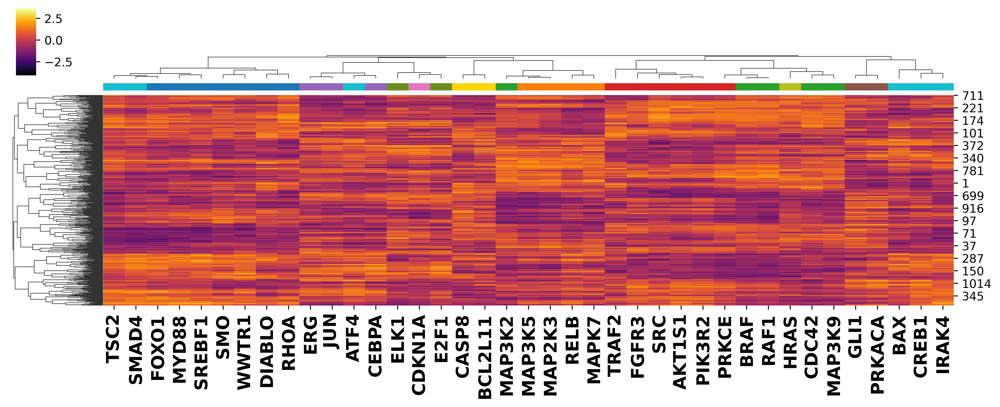

<IPython.core.display.Javascript object>

In [16]:
ax = sns.clustermap(
    latents.loc[set(oe_targets).intersection(latents.index)].transpose(),
    figsize=[12, 4],
    metric="cosine",
    method="complete",
    cmap="inferno",
    col_colors=np.array(
        all_clusters.loc[set(oe_targets).intersection(latents.index), "color"]
    ).ravel(),
    dendrogram_ratio=0.1,
    z_score=1,
)
x0, _y0, _w, _h = ax.cbar_pos

ax.ax_cbar.set_position([0.02, 0.9, 0.02, 0.2])
ax.ax_heatmap.set_xticklabels(
    ax.ax_heatmap.get_xmajorticklabels(),
    fontsize=15,
    fontweight="bold",
)

plt.show()

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


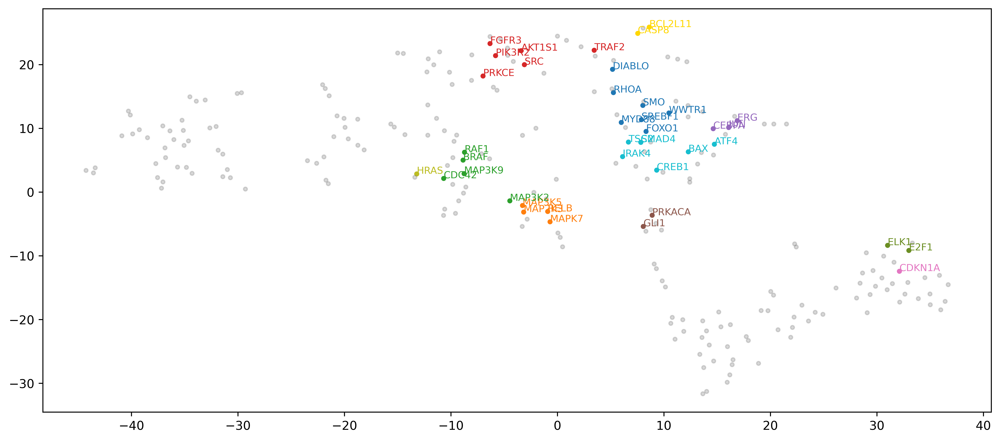

<IPython.core.display.Javascript object>

In [18]:
normalized_latents = pd.DataFrame(
    normalize(latents), index=latents.index, columns=latents.columns
)
tsne = TSNE(
    random_state=1234,
    perplexity=np.ceil(np.sqrt(len(normalized_latents))),
    init="pca",
    learning_rate=200,
)
embs = tsne.fit_transform(normalized_latents)
embs = pd.DataFrame(embs, index=normalized_latents.index, columns=["tsne_0", "tsne_1"])

fig, ax = plt.subplots(figsize=[14, 6])
for i in range(len(embs)):
    x = embs.iloc[i, 0]
    y = embs.iloc[i, 1]
    label = list(embs.index)[i]
    if label in oe_targets:
        c = all_clusters.loc[label, "color"]
        alpha = 1
        ax.text(x + 0.01, y + 0.01, label, {"size": 8, "c": c})
    else:
        c = "grey"
        alpha = 0.3
    ax.scatter(x, y, c=c, alpha=alpha, s=10)

plt.show()

----

### 4.3. Visualization of the inferred regulatory space

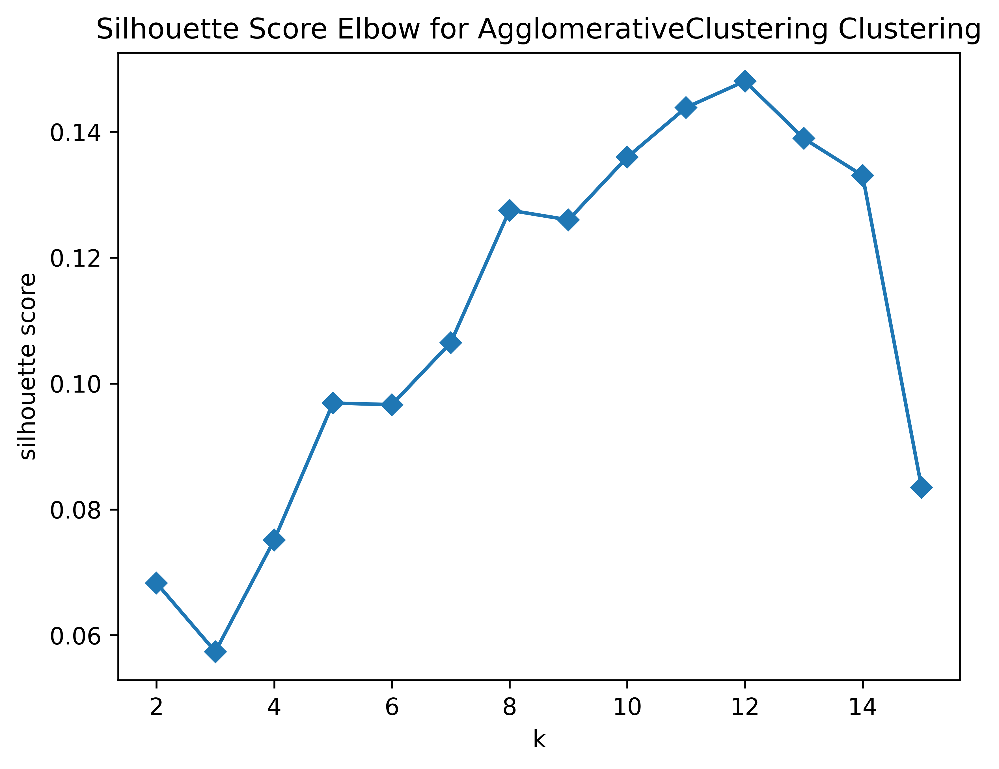

<IPython.core.display.Javascript object>

In [20]:
model = AgglomerativeClustering(affinity="cosine", linkage="complete")
visualizer = KElbowVisualizer(
    model, k=15, metric="silhouette", timings=False, locate_elbow=False
)

visualizer.fit(latents)
ax = visualizer.show()

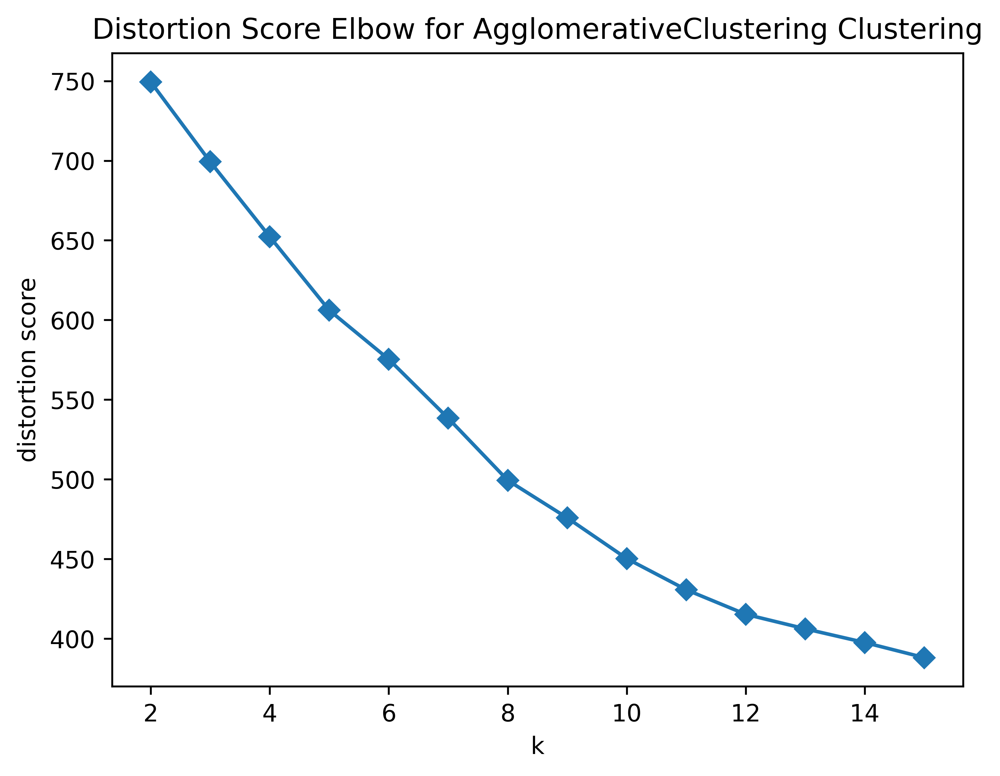

<IPython.core.display.Javascript object>

In [21]:
visualizer = KElbowVisualizer(
    model, k=15, metric="distortion", timings=False, locate_elbow=False
)

visualizer.fit(latents)
ax = visualizer.show()

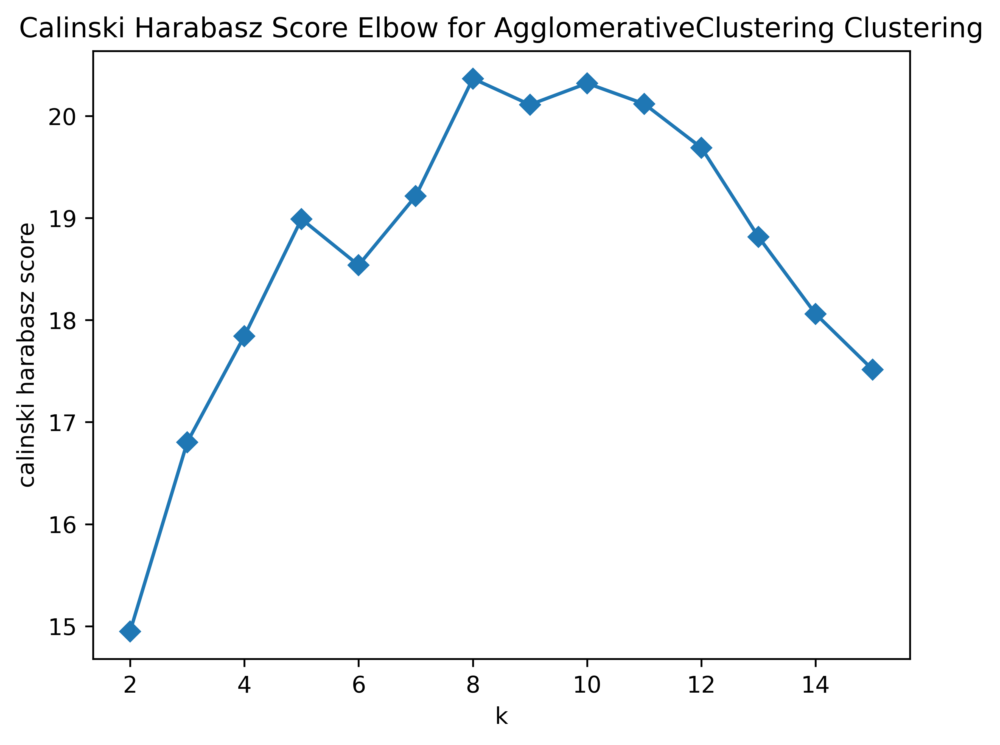

<IPython.core.display.Javascript object>

In [22]:
visualizer = KElbowVisualizer(
    model, k=15, metric="calinski_harabasz", timings=False, locate_elbow=False
)

visualizer.fit(latents)
ax = visualizer.show()

Based on the plots above we select k=8.

In [190]:
print(sorted(list(latents.index)))

['ACAN', 'AKT1S1', 'ALOX5', 'AMPH', 'APPBP2', 'AQP1', 'ARMCX2', 'ATF4', 'ATXN7', 'AURKA', 'AURKB', 'AXL', 'BAX', 'BCL2L11', 'BCR', 'BEX1', 'BIRC5', 'BMP4', 'BRAF', 'BUB1', 'BUB1B', 'C1QL1', 'CASP8', 'CCNA2', 'CCNB1', 'CCNB2', 'CCND2', 'CCNE1', 'CCNF', 'CD40', 'CDC20', 'CDC42', 'CDC42EP1', 'CDC45', 'CDC6', 'CDCA2', 'CDCA3', 'CDCA8', 'CDK1', 'CDK14', 'CDK2', 'CDK6', 'CDKN1A', 'CEBPA', 'CENPA', 'CENPE', 'CEP192', 'CKS2', 'CLSPN', 'CLU', 'CNN1', 'COL1A1', 'COL4A1', 'COL4A2', 'COL5A1', 'CREB1', 'CRMP1', 'CRYAB', 'CYBA', 'DHRS2', 'DIABLO', 'DNMT3B', 'DSP', 'DUSP6', 'E2F1', 'EEF1A2', 'EFEMP1', 'ELK1', 'EPB41L3', 'ERG', 'EXO1', 'FBLN1', 'FBN1', 'FBN2', 'FEN1', 'FGF1', 'FGFR2', 'FGFR3', 'FHL2', 'FKBP4', 'FN1', 'FOS', 'FOXM1', 'FOXO1', 'FSTL1', 'GABRB3', 'GIT1', 'GLI1', 'GLI2', 'GNAQ', 'GSK3B', 'GTSE1', 'HAPLN1', 'HJURP', 'HK2', 'HRAS', 'HSP90AB1', 'HSPA1B', 'HSPB1', 'HSPG2', 'IGF2', 'IGFBP5', 'INHBA', 'IRAK4', 'IRF7', 'JUN', 'KIF15', 'KIF23', 'KIF2C', 'KIF4A', 'KLK6', 'KPNA2', 'KRT15', 'KRT18',

<IPython.core.display.Javascript object>

In [23]:
model = model = AgglomerativeClustering(
    affinity="cosine", linkage="complete", n_clusters=8
)
cluster_labels = model.fit_predict(latents)
cluster_dict = {}
for cluster_label in np.unique(cluster_labels):
    cluster_dict[cluster_label] = list(
        np.array(list(latents.index))[cluster_labels == cluster_label]
    )
for k, v in cluster_dict.items():
    print("Cluster {}: {}".format(k, sorted(v)))
    print("")

Cluster 0: ['ACAN', 'AKT1S1', 'APPBP2', 'ARMCX2', 'ATXN7', 'AXL', 'BMP4', 'COL1A1', 'COL4A1', 'COL4A2', 'COL5A1', 'DHRS2', 'DSP', 'EFEMP1', 'FBLN1', 'FBN1', 'FBN2', 'FGF1', 'FGFR2', 'FGFR3', 'FN1', 'FSTL1', 'HAPLN1', 'HSPG2', 'IGF2', 'IGFBP5', 'INHBA', 'KLK6', 'KRT80', 'KRT81', 'LAMA1', 'LRP1', 'LTBP2', 'MAGEA6', 'MDK', 'MFAP2', 'MMP2', 'MYH9', 'MYL9', 'NEFL', 'PCOLCE', 'PDGFRB', 'PIK3R2', 'PLAT', 'PLCG1', 'S100A14', 'SERPINE1', 'SPARC', 'SRC', 'TGFB1', 'TGM2', 'THBS1', 'THY1', 'TIMP1', 'TNC', 'UCHL5', 'VCAN']

Cluster 1: ['ATF4', 'BAX', 'C1QL1', 'CLU', 'CREB1', 'GABRB3', 'GIT1', 'GLI2', 'GNAQ', 'GSK3B', 'IRAK4', 'MAP2K3', 'MAPK7', 'MBP', 'MDC1', 'NOTCH3', 'PCLO', 'PLCB2', 'PRKACA', 'PRKCA', 'PRSS23', 'RELB', 'TNNC1', 'TNNT2', 'TRIB3', 'UBE2C']

Cluster 2: ['BRAF', 'CDC42', 'CDC42EP1', 'CDK14', 'CNN1', 'CRMP1', 'EPB41L3', 'FKBP4', 'HK2', 'HRAS', 'HSP90AB1', 'HSPB1', 'KPNA2', 'KRT15', 'KRT18', 'KRT8', 'LGALS1', 'MAGEA1', 'MAGEA12', 'MAGEA4', 'MAGED1', 'MAP3K2', 'MAP3K5', 'MAP3K9', 'MYL2

<IPython.core.display.Javascript object>

----


----
